# This notebook explores the used of Autoencoders trained on normal segmented ECGs for Anomaly Detection




## Data Description:

- Data Source: 12 Lead Recordings from the PTB Diagnostic ECG Database on Phisionet.

- References: Wagner, P., Strodthoff, N., Bousseljot, R., Samek, W., & Schaeffter, T. (2022). PTB-XL, a large publicly available electrocardiography dataset (version 1.0.3). PhysioNet. RRID:SCR_007345. https://doi.org/10.13026/kfzx-aw45

- Data was loded Directly from the web-page: https://physionet.org/content/ptb-xl/1.0.3/
The following files were used in this notebook:
        
- records100 folder: containing the ECG data_ waveform data at a sampling frequency of 100Hz (records100/).
     to Download the files using your terminal:  wget -r -N -c -np https://physionet.org/files/ptb-xl/1.0.3/

- scp_statements.csv : information related to the used annotation scheme


- ptbxl_database.csv, containing the metadata information:
       with one row per record identified by ecg_id. It contains 28 columns that can be categorized into:

     1. Identifiers: Each record is identified by a unique ecg_id. The corresponding patient is encoded via patient_id. The paths to the original record (500 Hz) and a downsampled version of the record (100 Hz) are stored in filename_hr and filename_lr.
     2. General Metadata: demographic and recording metadata such as age, sex, height, weight, nurse, site, device and recording_date
     3. ECG statements: core components are scp_codes (SCP-ECG statements as a dictionary with entries of the form statement: likelihood, where likelihood is set to 0 if unknown) and report (report string). Additional fields are heart_axis, infarction_stadium1, infarction_stadium2, validated_by, second_opinion, initial_autogenerated_report and validated_by_human.
     4. Signal Metadata: signal quality such as noise (static_noise and burst_noise), baseline drifts (baseline_drift) and other artifacts such as electrodes_problems. We also provide extra_beats for counting extra systoles and pacemaker for signal patterns indicating an active pacemaker.
     5. Cross-validation Folds: recommended 10-fold train-test splits (strat_fold) obtained via stratified sampling while respecting patient assignments, i.e. all records of a particular patient were assigned to the same fold. Records in fold 9 and 10 underwent at least one human evaluation and are therefore of a particularly high label quality. We therefore propose to use folds 1-8 as training set, fold 9 as validation set and fold 10 as test set.






| Label    | Meaning                | Notes / Typical ECG Findings                                                                                                              |
| -------- | ---------------------- | ----------------------------------------------------------------------------------------------------------------------------------------- |
| **NORM** | Normal                 | No significant abnormalities. Standard sinus rhythm.                                                                                      |
| **MI**   | Myocardial Infarction  | Signs of past or acute heart attack; may show Q waves, ST-T changes.                                                                      |
| **HYP**  | Hypertrophy            | Usually **left or right ventricular hypertrophy**; high voltage QRS, strain patterns.                                                     |
| **CD**   | Conduction Disturbance | Includes bundle branch blocks, AV blocks, abnormal QRS propagation.                                                                       |
| **STTC** | ST-T Changes           | Repolarization abnormalities: ST elevation/depression, T wave inversion or flattening; can indicate ischemia or electrolyte disturbances. |


![ECG Example](./ECG_pathologies.png)

# Local set up to run on VS Code: load required packages

- Create enviroment
- load required packages on the file: requirements.txt
- set the VC enviroment to work in jupyter notebooks

# Import the required packages

In [871]:
# import the right packages
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import einops as eo # Added
import pathlib as pl # Added
from mlflow.models import infer_signature

import wfdb
import ast
import pickle
import gzip
import random

import ast
from multiprocessing import Pool, cpu_count
# from tqdm import tqdm # Removed redundant import
import os
import itertools

import matplotlib.pyplot as plt
import matplotlib.cm as cm
from matplotlib import collections  as mc
from matplotlib import animation
%matplotlib inline

from scipy.stats import norm
from scipy.stats import entropy
from scipy.ndimage import uniform_filter1d
from datetime import datetime

#transformer:
from transformers import AutoTokenizer, AutoModel



from PIL import Image
from time import time as timer
#import umap

from IPython.display import HTML
from IPython.display import Audio
import IPython

from functools import partial
from collections import Counter

from tqdm.auto import tqdm # Corrected import to get the callable tqdm function

import torch
from torchvision import datasets, transforms
from torch import nn
from torch import optim
import torch.nn.functional as F
from skmultilearn.model_selection import iterative_train_test_split

import sys
is_colab = 'google.colab' in sys.modules

if is_colab:
    from google.colab import drive
    drive.mount('/content/drive')
else:
    # do nothing or use local paths
    pass


from torch.utils.data import Dataset, DataLoader
from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.preprocessing import StandardScaler


import os
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from tqdm import tqdm
import optuna
from optuna.trial import TrialState
import matplotlib.pyplot as plt


import mlflow # Added if needed
import optuna # Added

import numpy as np
import pandas as pd
import neurokit2 as nk
from tqdm import tqdm

# =====================================================
# DEVICE SETUP and Directory to save models
# =====================================================
device = torch.device("mps") if torch.backends.mps.is_available() else torch.device("cpu")
print(f"Using device: {device}")


Using device: mps


# Local Set up in VS Code:  upload Files and generate Y and X data for training

In [768]:
# check im using the right kernerl we need python 10
import sys
print(sys.executable)

/Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Notebooks/env_Module3_P10.3/bin/python


## Load Data/ Initial Vizualization/ Preparation for Taining 

### Check Code to load few ECG for vizualization

In [2]:
# --- Imports ---
import os
import pandas as pd
import ast
import wfdb

# --- Define base path ---
base_path = '/Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/'

# --- Load metadata ---
Y = pd.read_csv(os.path.join(base_path, 'ptbxl_database.csv'), index_col='ecg_id')

# --- Convert scp_codes column from string to dict ---
Y.scp_codes = Y.scp_codes.apply(lambda x: ast.literal_eval(x))

# --- Pick the first ECG record to test ---
test_file_relative = Y.iloc[0].filename_lr
test_file_path = os.path.join(base_path, test_file_relative)
print("Loading ECG file:", test_file_path)

# --- Load the ECG using wfdb ---
signal, meta = wfdb.rdsamp(test_file_path)
print("Signal shape:", signal.shape)  # Expected: (1000, 12) for 100 Hz

# --- Optional: check diagnostic codes ---
print("SCP codes for this record:", Y.iloc[0].scp_codes)



Loading ECG file: /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/records100/00000/00001_lr
Signal shape: (1000, 12)
SCP codes for this record: {'NORM': 100.0, 'LVOLT': 0.0, 'SR': 0.0}


In [3]:
# `signal` is a NumPy array of shape (1000, 12) for a 10-second ECG at 100 Hz with 12 leads
# times points  (first dimension =1000)= called samples in this data set 
# leads = 12 ( second dimension)
print("Shape:", signal.shape)  # (timesteps, leads)
print("First 5 samples of lead I:", signal[:5, 0]) # signal[:5, 0] selects rows 0–4 (first 5 samples) and column 0 (lead I).


Shape: (1000, 12)
First 5 samples of lead I: [-0.119 -0.116 -0.12  -0.117 -0.103]


In [4]:
# Diagnostic labels
print("SCP codes and values:")
for code, value in Y.iloc[0].scp_codes.items():
    print(f"{code}: {value}")


SCP codes and values:
NORM: 100.0
LVOLT: 0.0
SR: 0.0


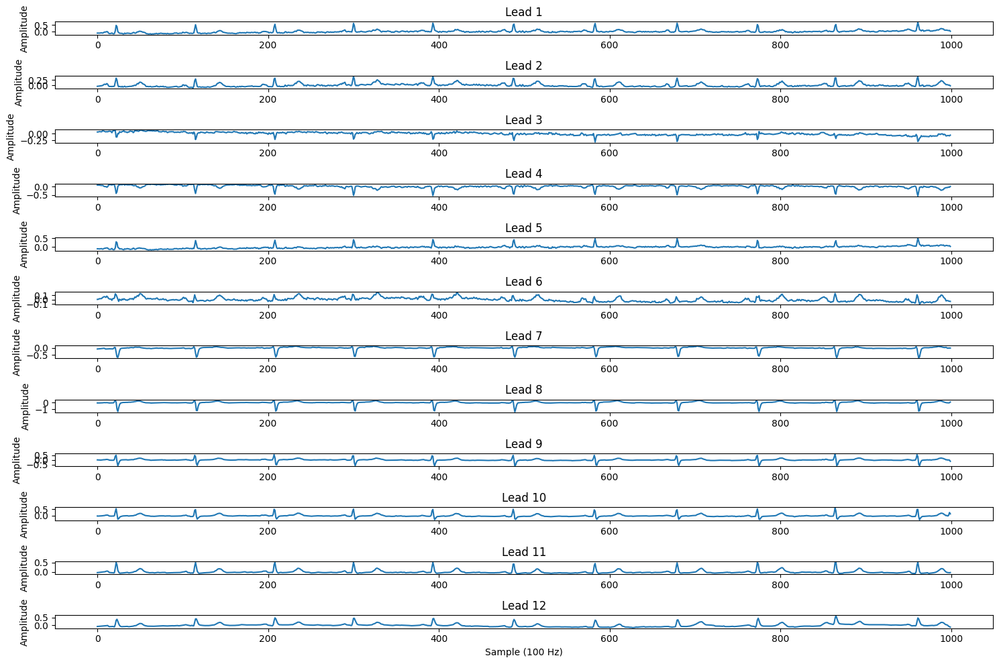

In [ ]:
# print 12 subplots: each line is a lead, sampled at 100 Hz.# Amplitude values in millivolts (or digital units, depending on the dataset).
import matplotlib.pyplot as plt

# Plot all 12 leads
plt.figure(figsize=(15, 10))
for i in range(12):
    plt.subplot(12, 1, i+1)
    plt.plot(signal[:, i])
    plt.title(f"Lead {i+1}")
    plt.ylabel("Amplitude")
    if i == 11:
        plt.xlabel("Sample (100 Hz)")

plt.tight_layout()
plt.show()


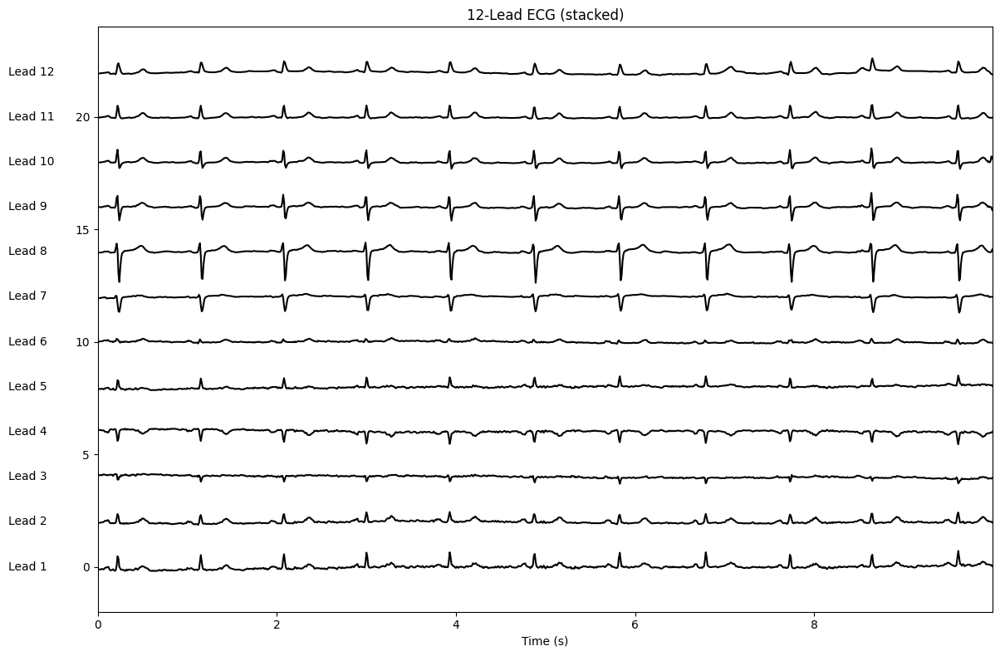

In [6]:
# PLot overlapping leads so they look more like a standard ECG printout and can be compared to clinical ECGs among them.
import matplotlib.pyplot as plt
import numpy as np

# signal shape: (1000, 12)
n_samples, n_leads = signal.shape

# Create time axis in seconds
fs = 100  # 100 Hz
t = np.arange(n_samples) / fs

# Scale and shift each lead for visualization
offset = 2.0  # vertical spacing between leads
scaled_signal = signal.copy()
for i in range(n_leads):
    scaled_signal[:, i] = signal[:, i] + i * offset

# Plot
plt.figure(figsize=(12, 8))
for i in range(n_leads):
    plt.plot(t, scaled_signal[:, i], color='black')
    plt.text(-1, i * offset, f'Lead {i+1}', verticalalignment='center', fontsize=10)

plt.xlabel("Time (s)")
#plt.ylabel("Leads")
plt.title("12-Lead ECG (stacked)")
plt.xlim([0, t[-1]])
plt.ylim([-offset, n_leads*offset])
plt.tight_layout()
plt.show()
#

In [7]:
# Select all records that have a 'NORM' key in scp_codes
normals = Y[Y.scp_codes.apply(lambda d: 'NORM' in d)]

# Check which ones are NOT 100% normal
not_fully_normal = normals[normals.scp_codes.apply(lambda d: d['NORM'] < 100.0)]

print(f"Total normal-labeled records: {len(normals)}")
print(f"Normal-labeled records with NORM < 100%: {len(not_fully_normal)}")

# Optional: see a few examples
if len(not_fully_normal) > 0:
    for idx in not_fully_normal.index[:5]:
        print(f"ECG ID {idx}: NORM = {normals.loc[idx].scp_codes['NORM']}")


Total normal-labeled records: 9514
Normal-labeled records with NORM < 100%: 2342
ECG ID 2: NORM = 80.0
ECG ID 11: NORM = 80.0
ECG ID 12: NORM = 80.0
ECG ID 27: NORM = 80.0
ECG ID 37: NORM = 80.0


Normal ECG ID: 1
Abnormal ECG ID: 8
SCP codes for this abnormal ECG:
IMI: 35.0
ABQRS: 0.0
SR: 0.0


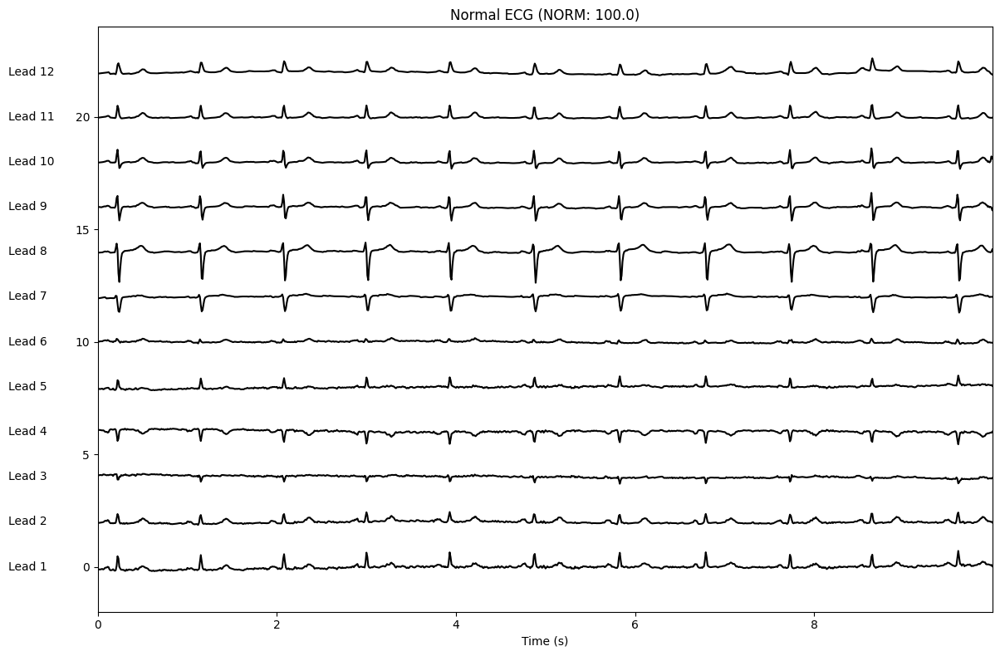

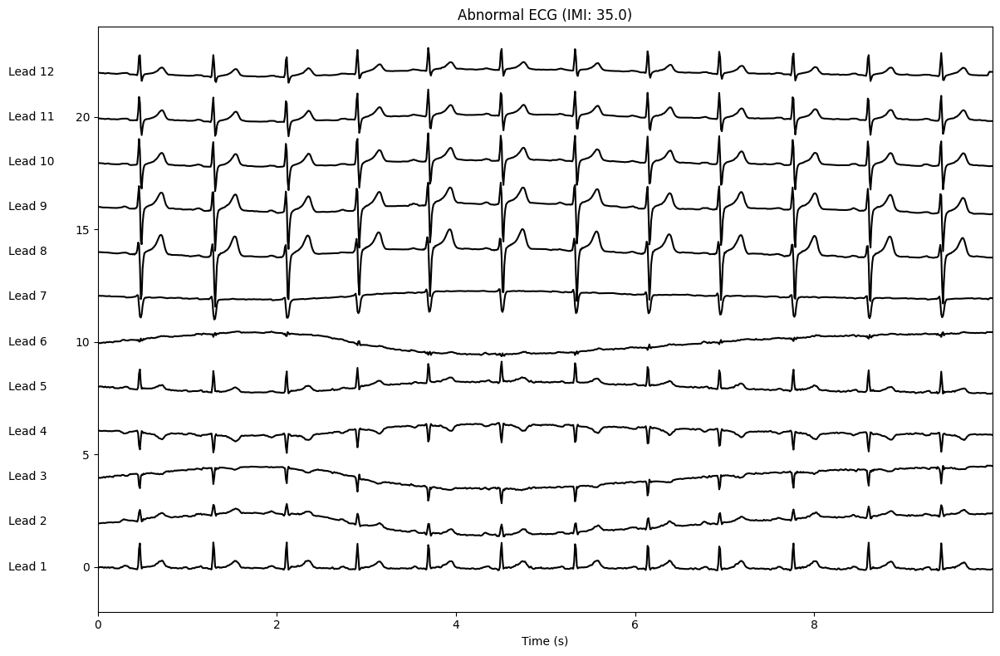

In [8]:
import os
import wfdb
import matplotlib.pyplot as plt
import numpy as np

# --- Find the first record labeled as normal ---
normal_idx = Y[Y.scp_codes.apply(lambda d: 'NORM' in d and d['NORM'] == 100.0)].index[0]
print("Normal ECG ID:", normal_idx)

# Load the normal signal
normal_file = os.path.join(base_path, Y.loc[normal_idx].filename_lr)
normal_sig, _ = wfdb.rdsamp(normal_file)

# --- Find the first record that is actually abnormal ---
abnormal_idx = Y[Y.scp_codes.apply(lambda d: 'NORM' not in d or (d['NORM'] < 100.0 and any(v > 0 for k, v in d.items() if k != 'NORM')))].index[0]
print("Abnormal ECG ID:", abnormal_idx)

# Load the abnormal signal
abnormal_file = os.path.join(base_path, Y.loc[abnormal_idx].filename_lr)
abnormal_sig, _ = wfdb.rdsamp(abnormal_file)

# SCP codes for abnormal ECG
abnormal_scp = Y.loc[abnormal_idx].scp_codes
print("SCP codes for this abnormal ECG:")
for code, value in abnormal_scp.items():
    print(f"{code}: {value}")

# Sampling and plotting parameters
fs = 100  # 100 Hz
n_samples = normal_sig.shape[0]
t = np.arange(n_samples) / fs
offset = 2.0  # vertical spacing

# --- Stacked plot function with automatic SCP codes in title ---
def stacked_plot(sig, title_prefix, scp_codes):
    n_leads = sig.shape[1]
    scaled_sig = sig.copy()
    
    # Scale and offset each lead
    for i in range(n_leads):
        scaled_sig[:, i] = sig[:, i] + i * offset

    # Build title with nonzero SCP codes only
    label_text = ", ".join([f"{k}: {v}" for k, v in scp_codes.items() if v > 0])
    
    plt.figure(figsize=(12, 8))
    for i in range(n_leads):
        plt.plot(t, scaled_sig[:, i], color='black')
        plt.text(-1, i*offset, f'Lead {i+1}', verticalalignment='center', fontsize=10)

    plt.title(f"{title_prefix} ({label_text})")
    plt.xlabel("Time (s)")
    plt.xlim([0, t[-1]])
    plt.ylim([-offset, n_leads*offset])
    plt.tight_layout()
    plt.show()

# --- Plot both ECGs ---
stacked_plot(normal_sig, "Normal ECG", Y.loc[normal_idx].scp_codes)
stacked_plot(abnormal_sig, "Abnormal ECG", abnormal_scp)


## Prepare X (data) and Y (labels) for training

In [ ]:
# Funtion to load and prepare the data: 
import os
import numpy as np
import wfdb
from multiprocessing.dummy import Pool as ThreadPool  # threads, safe in notebooks
from tqdm import tqdm

def _read_wfdb_sample(file_path):
    """Read a single WFDB record."""
    signal, _ = wfdb.rdsamp(file_path)
    return signal

def load_raw_data(df, base_path, batch_size=500, sampling_rate=100, n_jobs=4, save_dir=None):
    """
    Load PTB-XL ECG signals in batches using threads (safe in macOS notebooks).
    
    Args:
        df: DataFrame with ECG metadata (must include 'filename_lr' / 'filename_hr').
        base_path: Path to records100 folder.
        batch_size: Number of ECGs per batch.
        sampling_rate: 100 or 500 Hz.
        n_jobs: Number of threads.
        save_dir: Optional folder to save each batch as .npy for resuming.
    
    Returns:
        List of all loaded ECG signals.
    """
    if save_dir:
        os.makedirs(save_dir, exist_ok=True)

    file_column = 'filename_lr' if sampling_rate == 100 else 'filename_hr'
    all_files = [os.path.join(base_path, f) for f in df[file_column]]
    signals = []
    total_files = len(all_files)
    start_idx = 0

    # Resume from last saved batch
    if save_dir:
        saved_batches = sorted([int(f.split('_')[-1].split('.npy')[0]) 
                                for f in os.listdir(save_dir) if f.endswith('.npy')])
        if saved_batches:
            last_batch_idx = saved_batches[-1]
            start_idx = (last_batch_idx + 1) * batch_size
            print(f"Resuming from batch {last_batch_idx + 1}, file index {start_idx}")

    for i in range(start_idx, total_files, batch_size):
        batch_files = all_files[i:i+batch_size]
        print(f"Loading batch {i//batch_size + 1}: files {i}–{i + len(batch_files) - 1}")

        batch_data = []
        try:
            with ThreadPool(n_jobs) as pool:
                for signal in tqdm(pool.imap(_read_wfdb_sample, batch_files), total=len(batch_files)):
                    batch_data.append(signal)
        except KeyboardInterrupt:
            print("Interrupted! Partial batch not saved.")
            raise

        signals.extend(batch_data)

        # Save batch to disk
        if save_dir:
            batch_file = os.path.join(save_dir, f"ecg_batch_{i//batch_size}.npy")
            np.save(batch_file, np.array(batch_data))
            print(f"Saved batch {i//batch_size} to {batch_file}")

    return signals


In [ ]:
base_path = '/Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/'
save_dir = '/Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/'

# Load 100 Hz ECGs in batches of 500 using 4 threads
X = load_raw_data(Y, base_path, batch_size=500, sampling_rate=100, n_jobs=4, save_dir=save_dir)


Loading batch 1: files 0–499


100%|██████████| 500/500 [00:00<00:00, 1004.01it/s]


Saved batch 0 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_0.npy
Loading batch 2: files 500–999


100%|██████████| 500/500 [00:00<00:00, 1014.22it/s]


Saved batch 1 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_1.npy
Loading batch 3: files 1000–1499


100%|██████████| 500/500 [00:00<00:00, 1005.17it/s]


Saved batch 2 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_2.npy
Loading batch 4: files 1500–1999


100%|██████████| 500/500 [00:00<00:00, 974.40it/s] 


Saved batch 3 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_3.npy
Loading batch 5: files 2000–2499


100%|██████████| 500/500 [00:00<00:00, 1063.61it/s]


Saved batch 4 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_4.npy
Loading batch 6: files 2500–2999


100%|██████████| 500/500 [00:00<00:00, 1065.86it/s]


Saved batch 5 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_5.npy
Loading batch 7: files 3000–3499


100%|██████████| 500/500 [00:00<00:00, 1065.50it/s]


Saved batch 6 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_6.npy
Loading batch 8: files 3500–3999


100%|██████████| 500/500 [00:00<00:00, 1026.10it/s]


Saved batch 7 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_7.npy
Loading batch 9: files 4000–4499


100%|██████████| 500/500 [00:00<00:00, 1027.43it/s]


Saved batch 8 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_8.npy
Loading batch 10: files 4500–4999


100%|██████████| 500/500 [00:00<00:00, 1029.59it/s]


Saved batch 9 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_9.npy
Loading batch 11: files 5000–5499


100%|██████████| 500/500 [00:00<00:00, 1026.44it/s]


Saved batch 10 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_10.npy
Loading batch 12: files 5500–5999


100%|██████████| 500/500 [00:00<00:00, 1051.95it/s]


Saved batch 11 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_11.npy
Loading batch 13: files 6000–6499


100%|██████████| 500/500 [00:00<00:00, 1047.26it/s]


Saved batch 12 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_12.npy
Loading batch 14: files 6500–6999


100%|██████████| 500/500 [00:00<00:00, 1037.92it/s]


Saved batch 13 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_13.npy
Loading batch 15: files 7000–7499


100%|██████████| 500/500 [00:00<00:00, 1009.51it/s]


Saved batch 14 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_14.npy
Loading batch 16: files 7500–7999


100%|██████████| 500/500 [00:00<00:00, 1030.55it/s]


Saved batch 15 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_15.npy
Loading batch 17: files 8000–8499


100%|██████████| 500/500 [00:00<00:00, 1041.89it/s]


Saved batch 16 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_16.npy
Loading batch 18: files 8500–8999


100%|██████████| 500/500 [00:00<00:00, 1035.89it/s]


Saved batch 17 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_17.npy
Loading batch 19: files 9000–9499


100%|██████████| 500/500 [00:00<00:00, 1009.13it/s]


Saved batch 18 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_18.npy
Loading batch 20: files 9500–9999


100%|██████████| 500/500 [00:00<00:00, 1022.28it/s]


Saved batch 19 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_19.npy
Loading batch 21: files 10000–10499


100%|██████████| 500/500 [00:00<00:00, 1013.21it/s]


Saved batch 20 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_20.npy
Loading batch 22: files 10500–10999


100%|██████████| 500/500 [00:00<00:00, 1016.92it/s]


Saved batch 21 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_21.npy
Loading batch 23: files 11000–11499


100%|██████████| 500/500 [00:00<00:00, 1014.73it/s]


Saved batch 22 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_22.npy
Loading batch 24: files 11500–11999


100%|██████████| 500/500 [00:00<00:00, 1010.03it/s]


Saved batch 23 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_23.npy
Loading batch 25: files 12000–12499


100%|██████████| 500/500 [00:00<00:00, 1012.31it/s]


Saved batch 24 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_24.npy
Loading batch 26: files 12500–12999


100%|██████████| 500/500 [00:00<00:00, 1026.41it/s]


Saved batch 25 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_25.npy
Loading batch 27: files 13000–13499


100%|██████████| 500/500 [00:00<00:00, 1011.15it/s]


Saved batch 26 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_26.npy
Loading batch 28: files 13500–13999


100%|██████████| 500/500 [00:00<00:00, 1015.76it/s]


Saved batch 27 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_27.npy
Loading batch 29: files 14000–14499


100%|██████████| 500/500 [00:00<00:00, 1016.89it/s]


Saved batch 28 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_28.npy
Loading batch 30: files 14500–14999


100%|██████████| 500/500 [00:00<00:00, 1013.52it/s]


Saved batch 29 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_29.npy
Loading batch 31: files 15000–15499


100%|██████████| 500/500 [00:00<00:00, 1011.84it/s]


Saved batch 30 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_30.npy
Loading batch 32: files 15500–15999


100%|██████████| 500/500 [00:00<00:00, 1029.34it/s]


Saved batch 31 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_31.npy
Loading batch 33: files 16000–16499


100%|██████████| 500/500 [00:00<00:00, 1037.83it/s]


Saved batch 32 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_32.npy
Loading batch 34: files 16500–16999


100%|██████████| 500/500 [00:00<00:00, 1017.90it/s]


Saved batch 33 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_33.npy
Loading batch 35: files 17000–17499


100%|██████████| 500/500 [00:00<00:00, 1017.99it/s]


Saved batch 34 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_34.npy
Loading batch 36: files 17500–17999


100%|██████████| 500/500 [00:00<00:00, 1024.45it/s]


Saved batch 35 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_35.npy
Loading batch 37: files 18000–18499


100%|██████████| 500/500 [00:00<00:00, 1026.78it/s]


Saved batch 36 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_36.npy
Loading batch 38: files 18500–18999


100%|██████████| 500/500 [00:00<00:00, 1047.26it/s]


Saved batch 37 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_37.npy
Loading batch 39: files 19000–19499


100%|██████████| 500/500 [00:00<00:00, 1036.52it/s]


Saved batch 38 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_38.npy
Loading batch 40: files 19500–19999


100%|██████████| 500/500 [00:00<00:00, 990.40it/s]


Saved batch 39 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_39.npy
Loading batch 41: files 20000–20499


100%|██████████| 500/500 [00:00<00:00, 1004.71it/s]


Saved batch 40 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_40.npy
Loading batch 42: files 20500–20999


100%|██████████| 500/500 [00:00<00:00, 1006.78it/s]


Saved batch 41 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_41.npy
Loading batch 43: files 21000–21499


100%|██████████| 500/500 [00:00<00:00, 993.99it/s]


Saved batch 42 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_42.npy
Loading batch 44: files 21500–21798


100%|██████████| 299/299 [00:00<00:00, 1008.51it/s]


Saved batch 43 to /Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/ecg_batch_43.npy


In [5]:
base_path = '/Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/'
save_dir = '/Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/'


In [ ]:
import numpy as np

save_dir = '/Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/ptb-xl-1.0.3/ecg_batches_100/'

# Get full paths and sort
batch_files = sorted([os.path.join(save_dir, f) for f in os.listdir(save_dir) if f.endswith('.npy')])

# Load all batches and concatenate
X = np.concatenate([np.load(f) for f in batch_files], axis=0)
print(f"X shape: {X.shape}")

In [28]:

# Load metadata
Y = pd.read_csv(os.path.join(base_path, 'ptbxl_database.csv'), index_col='ecg_id')

Y.scp_codes = Y.scp_codes.apply(lambda x: ast.literal_eval(x))

agg_df = pd.read_csv(os.path.join(base_path, 'scp_statements.csv'), index_col=0)
agg_df = agg_df[agg_df.diagnostic == 1]

def aggregate_diagnostic(y_dic):
    tmp = []
    for key in y_dic.keys():
        if key in agg_df.index:
            tmp.append(agg_df.loc[key].diagnostic_class)
    return list(set(tmp))

Y['diagnostic_superclass'] = Y.scp_codes.apply(aggregate_diagnostic) # this will create a new column in Y with the diagnostic superclasses,
print(f"agg shape:{agg_df.shape}")
print(f"Y shape:{Y.shape}")

agg shape:(44, 12)
Y shape:(21799, 28)


In [29]:
print(agg_df.head())

                          description  diagnostic  form  rhythm  \
NDT    non-diagnostic T abnormalities         1.0   1.0     NaN   
NST_          non-specific ST changes         1.0   1.0     NaN   
DIG                  digitalis-effect         1.0   1.0     NaN   
LNGQT                long QT-interval         1.0   1.0     NaN   
NORM                       normal ECG         1.0   NaN     NaN   

      diagnostic_class diagnostic_subclass  \
NDT               STTC                STTC   
NST_              STTC                NST_   
DIG               STTC                STTC   
LNGQT             STTC                STTC   
NORM              NORM                NORM   

                                      Statement Category  \
NDT                    other ST-T descriptive statements   
NST_   Basic roots for coding ST-T changes and abnorm...   
DIG                    other ST-T descriptive statements   
LNGQT                  other ST-T descriptive statements   
NORM                

In [30]:

Y.head()

,patient_id,age,sex,height,weight,nurse,site,device,recording_date,report,...,baseline_drift,static_noise,burst_noise,electrodes_problems,extra_beats,pacemaker,strat_fold,filename_lr,filename_hr,diagnostic_superclass
ecg_id,,,,,,,,,,,,,,,,,,,,,
1,15709.0,56.0,1,NaN,63.0,2.0,0.0,CS-12 E,1984-11-09 09:17:34,sinusrhythmus periphere niederspannung,...,NaN,", I-V1,",NaN,NaN,NaN,NaN,3,records100/00000/00001_lr,records500/00000/00001_hr,[NORM]
2,13243.0,19.0,0,NaN,70.0,2.0,0.0,CS-12 E,1984-11-14 12:55:37,sinusbradykardie sonst normales ekg,...,NaN,NaN,NaN,NaN,NaN,NaN,2,records100/00000/00002_lr,records500/00000/00002_hr,[NORM]
3,20372.0,37.0,1,NaN,69.0,2.0,0.0,CS-12 E,1984-11-15 12:49:10,sinusrhythmus normales ekg,...,NaN,NaN,NaN,NaN,NaN,NaN,5,records100/00000/00003_lr,records500/00000/00003_hr,[NORM]
4,17014.0,24.0,0,NaN,82.0,2.0,0.0,CS-12 E,1984-11-15 13:44:57,sinusrhythmus normales ekg,...,", II,III,AVF",NaN,NaN,NaN,NaN,NaN,3,records100/00000/00004_lr,records500/00000/00004_hr,[NORM]
5,17448.0,19.0,1,NaN,70.0,2.0,0.0,CS-12 E,1984-11-17 10:43:15,sinusrhythmus normales ekg,...,", III,AVR,AVF",NaN,NaN,NaN,NaN,NaN,4,records100/00000/00005_lr,records500/00000/00005_hr,[NORM]


In [ ]:
import os
import numpy as np
import pandas as pd

# Define local save directory
save_dir = '/Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/'

# Create directory if it doesn't exist
os.makedirs(save_dir, exist_ok=True)

# Define full paths for saving
Y_path = os.path.join(save_dir, 'Y.pkl')
X_path = os.path.join(save_dir, 'X.npy')

# Save Y DataFrame and X array locally
Y.to_pickle(Y_path)   # Save with index (ecg_id)
np.save(X_path, X)    # Save NumPy array X

print(f'DataFrame Y saved to {Y_path}')
print(f'NumPy array X saved to {X_path}')
# 

# From here on with saved files  Y and X downloaded directly from saved local files

## Load Data from local files

In [602]:
# Define the path where the saved files are located
load_path = '/Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Data/'

# Load diagnostic aggregation CSV and diagnostic statements if needed again
agg_df = pd.read_csv(os.path.join(load_path, 'scp_statements.csv'), index_col=0)
agg_df = agg_df[agg_df.diagnostic == 1]  # keep only diagnostic codes

# Load the saved NumPy array X
X = np.load(os.path.join(load_path, 'Y_dataframe_X.npy')) # Load the saved NumPy array X () (original from CAatherine)
#X = np.load(os.path.join(load_path, 'X.npy')) # my file
# Load the saved pandas DataFrame Y
Y = pd.read_pickle(os.path.join(load_path, 'Y_dataframe_Y.pkl')) # Load the saved pkl Y () (original from CAatherine)
#Y = pd.read_pickle(os.path.join(load_path, 'Y.pkl'))# my file 
print(" Y and X reloaded" )

 Y and X reloaded


In [603]:
# print shapes of x and y
print(f"X shape: {X.shape}")
print(f"Y shape: {Y.shape}")

# print types
print(f"X type: {X.dtype}")


# print indices
print(f"Y indices: {Y.index}")

X shape: (21799, 1000, 12)
Y shape: (21799, 28)
X type: float64
Y indices: Index([    1,     2,     3,     4,     5,     6,     7,     8,     9,    10,
       ...
       21828, 21829, 21830, 21831, 21832, 21833, 21834, 21835, 21836, 21837],
      dtype='int64', name='ecg_id', length=21799)


In [604]:

agg_df

,description,diagnostic,form,rhythm,diagnostic_class,diagnostic_subclass,Statement Category,SCP-ECG Statement Description,AHA code,aECG REFID,CDISC Code,DICOM Code
NDT,non-diagnostic T abnormalities,1.0,1.0,NaN,STTC,STTC,other ST-T descriptive statements,non-diagnostic T abnormalities,NaN,NaN,NaN,NaN
NST_,non-specific ST changes,1.0,1.0,NaN,STTC,NST_,Basic roots for coding ST-T changes and abnorm...,non-specific ST changes,145.0,MDC_ECG_RHY_STHILOST,NaN,NaN
DIG,digitalis-effect,1.0,1.0,NaN,STTC,STTC,other ST-T descriptive statements,suggests digitalis-effect,205.0,NaN,NaN,NaN
LNGQT,long QT-interval,1.0,1.0,NaN,STTC,STTC,other ST-T descriptive statements,long QT-interval,148.0,NaN,NaN,NaN
NORM,normal ECG,1.0,NaN,NaN,NORM,NORM,Normal/abnormal,normal ECG,1.0,NaN,NaN,F-000B7
IMI,inferior myocardial infarction,1.0,NaN,NaN,MI,IMI,Myocardial Infarction,inferior myocardial infarction,161.0,NaN,NaN,NaN
ASMI,anteroseptal myocardial infarction,1.0,NaN,NaN,MI,AMI,Myocardial Infarction,anteroseptal myocardial infarction,165.0,NaN,NaN,NaN
LVH,left ventricular hypertrophy,1.0,NaN,NaN,HYP,LVH,Ventricular Hypertrophy,left ventricular hypertrophy,142.0,NaN,C71076,NaN
LAFB,left anterior fascicular block,1.0,NaN,NaN,CD,LAFB/LPFB,Intraventricular and intra-atrial Conduction d...,left anterior fascicular block,101.0,MDC_ECG_BEAT_BLK_ANT_L_HEMI,C62267,D3-33140
ISC_,non-specific ischemic,1.0,NaN,NaN,STTC,ISC_,Basic roots for coding ST-T changes and abnorm...,ischemic ST-T changes,226.0,NaN,NaN,NaN


In [605]:
Y.head(10)

,patient_id,age,sex,height,weight,nurse,site,device,recording_date,report,...,baseline_drift,static_noise,burst_noise,electrodes_problems,extra_beats,pacemaker,strat_fold,filename_lr,filename_hr,diagnostic_superclass
ecg_id,,,,,,,,,,,,,,,,,,,,,
1,15709.0,56.0,1,NaN,63.0,2.0,0.0,CS-12 E,1984-11-09 09:17:34,sinusrhythmus periphere niederspannung,...,NaN,", I-V1,",NaN,NaN,NaN,NaN,3,records100/00000/00001_lr,records500/00000/00001_hr,[NORM]
2,13243.0,19.0,0,NaN,70.0,2.0,0.0,CS-12 E,1984-11-14 12:55:37,sinusbradykardie sonst normales ekg,...,NaN,NaN,NaN,NaN,NaN,NaN,2,records100/00000/00002_lr,records500/00000/00002_hr,[NORM]
3,20372.0,37.0,1,NaN,69.0,2.0,0.0,CS-12 E,1984-11-15 12:49:10,sinusrhythmus normales ekg,...,NaN,NaN,NaN,NaN,NaN,NaN,5,records100/00000/00003_lr,records500/00000/00003_hr,[NORM]
4,17014.0,24.0,0,NaN,82.0,2.0,0.0,CS-12 E,1984-11-15 13:44:57,sinusrhythmus normales ekg,...,", II,III,AVF",NaN,NaN,NaN,NaN,NaN,3,records100/00000/00004_lr,records500/00000/00004_hr,[NORM]
5,17448.0,19.0,1,NaN,70.0,2.0,0.0,CS-12 E,1984-11-17 10:43:15,sinusrhythmus normales ekg,...,", III,AVR,AVF",NaN,NaN,NaN,NaN,NaN,4,records100/00000/00005_lr,records500/00000/00005_hr,[NORM]
6,19005.0,18.0,1,NaN,58.0,2.0,0.0,CS-12 E,1984-11-28 13:32:13,sinusrhythmus normales ekg,...,", V1",NaN,NaN,NaN,NaN,NaN,4,records100/00000/00006_lr,records500/00000/00006_hr,[NORM]
7,16193.0,54.0,0,NaN,83.0,2.0,0.0,CS-12 E,1984-11-28 13:32:22,"sinusrhythmus linkstyp t abnormal, wahrscheinl...",...,NaN,NaN,NaN,NaN,NaN,NaN,7,records100/00000/00007_lr,records500/00000/00007_hr,[NORM]
8,11275.0,48.0,0,NaN,95.0,2.0,0.0,CS-12 E,1984-12-01 14:49:52,sinusrhythmus linkstyp qrs(t) abnormal infe...,...,", II,AVF",", I-AVF,",NaN,NaN,NaN,NaN,9,records100/00000/00008_lr,records500/00000/00008_hr,[MI]
9,18792.0,55.0,0,NaN,70.0,2.0,0.0,CS-12 E,1984-12-08 09:44:43,sinusrhythmus normales ekg,...,NaN,", I-AVR,",NaN,NaN,NaN,NaN,10,records100/00000/00009_lr,records500/00000/00009_hr,[NORM]


In [606]:
X

array([[[-1.190e-01, -5.500e-02,  6.400e-02, ..., -2.600e-02,
         -3.900e-02, -7.900e-02],
        [-1.160e-01, -5.100e-02,  6.500e-02, ..., -3.100e-02,
         -3.400e-02, -7.400e-02],
        [-1.200e-01, -4.400e-02,  7.600e-02, ..., -2.800e-02,
         -2.900e-02, -6.900e-02],
        ...,
        [ 6.900e-02,  0.000e+00, -6.900e-02, ...,  2.400e-02,
         -4.100e-02, -5.800e-02],
        [ 8.600e-02,  4.000e-03, -8.100e-02, ...,  2.420e-01,
         -4.600e-02, -9.800e-02],
        [ 2.200e-02, -3.100e-02, -5.400e-02, ...,  1.430e-01,
         -3.500e-02, -1.200e-01]],

       [[ 4.000e-03,  1.380e-01,  1.340e-01, ...,  1.920e-01,
          8.300e-02,  8.800e-02],
        [-2.000e-02,  1.160e-01,  1.360e-01, ...,  1.560e-01,
          5.700e-02,  6.300e-02],
        [-5.300e-02,  9.200e-02,  1.450e-01, ...,  1.070e-01,
          1.300e-02,  2.200e-02],
        ...,
        [ 1.210e-01,  3.980e-01,  2.770e-01, ..., -1.065e+00,
         -4.920e-01, -1.560e-01],
        [-3.

In [607]:
X.shape

(21799, 1000, 12)

In [608]:
import numpy as np
import matplotlib.pyplot as plt

# Example: X is your dataset
# X.shape == (21799, 1000, 12)
print("X.shape:", X.shape)

# Get first sample
sample = X[0]  # expected shape (1000, 12) (would be the index 1 of the Y DataFrame)
if sample.shape[0] == 12 and sample.shape[1] != 12:
    # maybe leads are first axis; transpose to (time, leads)
    sample = sample.T

n_samples, n_leads = sample.shape
print("sample.shape:", sample.shape)

X.shape: (21799, 1000, 12)
sample.shape: (1000, 12)


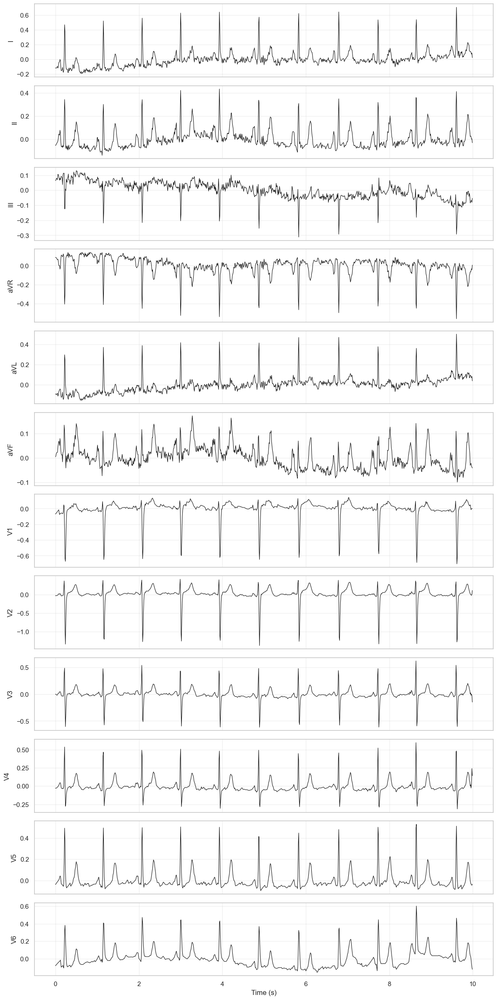

In [609]:
fs = 100  # sampling frequency in Hz — change to your real value
time = np.arange(n_samples) / fs

lead_names = ['I','II','III','aVR','aVL','aVF','V1','V2','V3','V4','V5','V6']  # change if needed

fig, axs = plt.subplots(n_leads, 1, figsize=(12, 2.0*n_leads), sharex=True)
for i, ax in enumerate(axs):
    ax.plot(time, sample[:, i], color='k', linewidth=0.8)
    ax.set_ylabel(lead_names[i] if i < len(lead_names) else f"Lead {i}")
    ax.grid(True, alpha=0.3)
axs[-1].set_xlabel("Time (s)")
plt.tight_layout()
plt.show()

X.shape: (21799, 1000, 12)
sample.shape: (1000, 12)


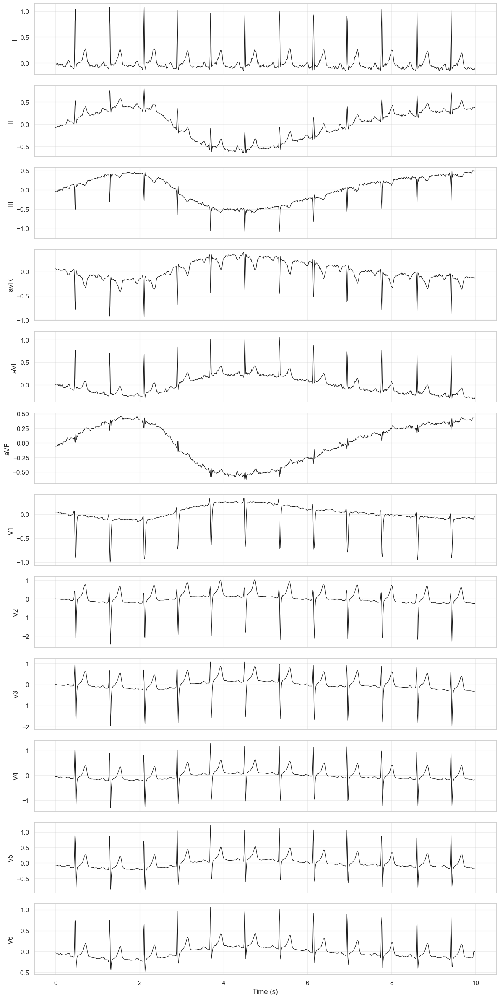

In [610]:
import numpy as np
import matplotlib.pyplot as plt

# Example: X is your dataset
# X.shape == (21799, 1000, 12)
print("X.shape:", X.shape)

# Get first sample
sample = X[7]  # expected shape (1000, 12) (would be the index 8 of the Y DataFrame, and an MI sample from original data set)
if sample.shape[0] == 12 and sample.shape[1] != 12:
    # maybe leads are first axis; transpose to (time, leads)
    sample = sample.T

n_samples, n_leads = sample.shape
print("sample.shape:", sample.shape)
      
fs = 100  # sampling frequency in Hz — change to your real value
time = np.arange(n_samples) / fs

lead_names = ['I','II','III','aVR','aVL','aVF','V1','V2','V3','V4','V5','V6']  # change if needed

fig, axs = plt.subplots(n_leads, 1, figsize=(12, 2.0*n_leads), sharex=True)
for i, ax in enumerate(axs):
    ax.plot(time, sample[:, i], color='k', linewidth=0.8)
    ax.set_ylabel(lead_names[i] if i < len(lead_names) else f"Lead {i}")
    ax.grid(True, alpha=0.3)
axs[-1].set_xlabel("Time (s)")
plt.tight_layout()
plt.show()

In [611]:
# print "superclass" for samples with indices 1 and 8
print("Sample 1 superclass:", Y.iloc[0]['diagnostic_superclass'])
print("Sample 8 superclass:", Y.iloc[7]['diagnostic_superclass'])

Sample 1 superclass: ['NORM']
Sample 8 superclass: ['MI']


In [612]:
# first row by position
print("Y.iloc[0] label:", Y.index[0])        # e.g. 1
print("Y.iloc[0] superclass:", Y.iloc[0]['diagnostic_superclass'])
print("X[0] shape:", X[0].shape)            # X[0] is the first ECG (positional)

# get by label (ecg_id = 1 in your index)
label = Y.index[0]   # e.g. 1
print("Y.loc[label] equals Y.iloc[0]?:", Y.loc[label].equals(Y.iloc[0]))
# to get the corresponding X row for index label 'label' you need its position:
pos = Y.index.get_loc(label)
print("Position of label", label, "is", pos)
print("X[pos] is the matching ECG for that row:", X[pos].shape)

Y.iloc[0] label: 1
Y.iloc[0] superclass: ['NORM']
X[0] shape: (1000, 12)
Y.loc[label] equals Y.iloc[0]?: True
Position of label 1 is 0
X[pos] is the matching ECG for that row: (1000, 12)


In [613]:
# first row by position
print("Y.iloc[7] label:", Y.index[7])        # e.g. 1
print("Y.iloc[8] superclass:", Y.iloc[8]['diagnostic_superclass'])
print("X[8] shape:", X[8].shape)   

Y.iloc[7] label: 8
Y.iloc[8] superclass: ['NORM']
X[8] shape: (1000, 12)


shows everything is aligned right now — your pandas rows (Y) and numpy rows (X) correspond positionally:

Y.iloc[0] has index label 1 and superclass ['NORM']
Y.loc[1] == Y.iloc[0] → True
Y.index.get_loc(1) → 0
X[0] is the matching ECG for that Y row
So you can safely use positional indexing (iloc / numpy indexing) to remove rows from both X and Y as long as you keep using the same mask or positional indices. Below are two safe, copy‑paste options (choose one) and a few checks to avoid mistakes later.

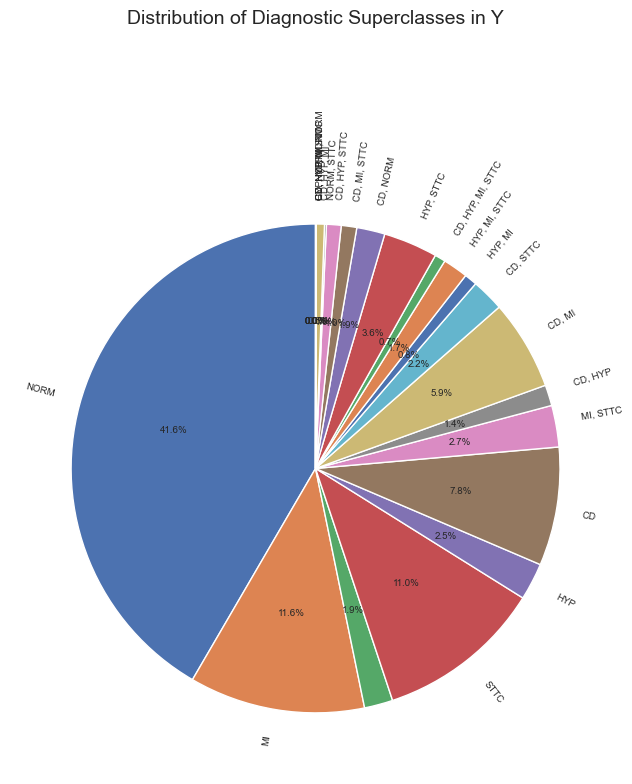

Distribution of Diagnostic Superclasses in Y:
- NORM: 41.60%
- MI: 11.62%
- : 1.89%
- STTC: 11.01%
- HYP: 2.45%
- CD: 7.84%
- MI, STTC: 2.75%
- CD, HYP: 1.38%
- CD, MI: 5.95%
- CD, STTC: 2.16%
- HYP, MI: 0.84%
- HYP, MI, STTC: 1.66%
- CD, HYP, MI, STTC: 0.72%
- HYP, STTC: 3.58%
- CD, NORM: 1.87%
- CD, MI, STTC: 1.02%
- CD, HYP, STTC: 0.97%
- NORM, STTC: 0.13%
- CD, HYP, MI: 0.54%
- CD, NORM, STTC: 0.02%
- CD, HYP, NORM: 0.01%
- HYP, NORM: 0.01%
- CD, HYP, MI, NORM: 0.00%


In [614]:
# Count the occurrences of each unique list of diagnostic superclasses
# Convert the list to a tuple so it's hashable for Counter
superclass_counts = Counter(tuple(sorted(item)) for item in Y['diagnostic_superclass'])

# Calculate total number of samples for percentages
total_samples = len(Y)

# Calculate percentages
superclass_percentages = {
    label: count / total_samples * 100
    for label, count in superclass_counts.items()
}

# Create pie chart
plt.figure(figsize=(8, 8))
# Filter out categories with 0 percentage if needed
plot_data = {', '.join(label): percentage for label, percentage in superclass_percentages.items() if percentage > 0}
plt.pie(plot_data.values(), labels=plot_data.keys(), autopct='%1.1f%%', startangle=90, rotatelabels=True,textprops={'fontsize': 7}) # Added rotatelabels=True
plt.title('Distribution of Diagnostic Superclasses in Y',  fontsize=14, pad=100)


plt.tight_layout()
plt.show()

print("Distribution of Diagnostic Superclasses in Y:")
for label, percentage in superclass_percentages.items():
    print(f"- {', '.join(label)}: {percentage:.2f}%")

# Functions for plotting results



In [ ]:
# Architecture Visualization Functions

def visualize_autoencoder_architecture(model, input_shape):
    """
    Create a visual representation of the autoencoder architecture
    """
    fig, ax = plt.subplots(1, 1, figsize=(20, 8))

    # layer information
    encoder_layers = []
    decoder_layers = []

    # encoder
    for name, layer in model.encoder.named_children():
        if isinstance(layer, nn.Linear):
            encoder_layers.append(('Linear', layer.in_features, layer.out_features))
        elif isinstance(layer, nn.Conv2d):
            encoder_layers.append(('Conv2d', f'{layer.in_channels}ch ({layer.kernel_size[0]}×{layer.kernel_size[0]})k\n',
                                 f'{layer.out_channels}ch'))
        elif isinstance(layer, nn.Flatten):
            encoder_layers.append(('Flatten', '', ''))

    # decoder
    for name, layer in model.decoder.named_children():
        if isinstance(layer, nn.Linear):
            decoder_layers.append(('Linear', layer.in_features, layer.out_features))
        elif isinstance(layer, nn.ConvTranspose2d):
            decoder_layers.append(('ConvTran2d', f'{layer.in_channels}ch',
                                 f'\n{layer.out_channels}ch ({layer.kernel_size[0]}×{layer.kernel_size[0]})k'))
        elif isinstance(layer, nn.Unflatten):
            decoder_layers.append(('Unflatten', '', ''))

    y_pos = 0.5
    # positions for input + encoder + latent + decoder + output
    total_positions = 1 + len(encoder_layers) + 1 + len(decoder_layers) + 1
    x_positions = np.linspace(0.1, 0.9, total_positions)

    # box dimensions
    box_width = 0.035
    box_height = 0.15
    latent_width = 0.045
    latent_height = 0.2

    # Input
    ax.add_patch(plt.Rectangle((x_positions[0]-box_width/2, y_pos-box_height/2), box_width, box_height,
                              facecolor='lightblue', edgecolor='black'))
    ax.text(x_positions[0], y_pos+box_height/2+0.05, 'Input\n' + '×'.join(map(str, input_shape[1:])),
            ha='center', va='bottom', fontsize=10, fontweight='bold')

    # Encoder layers
    for i, (layer_type, in_dim, out_dim) in enumerate(encoder_layers):
        x = x_positions[i+1]
        color = 'lightcoral' if 'Conv' in layer_type else 'lightgreen'

        ax.add_patch(plt.Rectangle((x-box_width/2, y_pos-box_height/2), box_width, box_height,
                                  facecolor=color, edgecolor='black'))
        ax.text(x, y_pos+box_height/2+0.05, f'{layer_type}\n{in_dim} → {out_dim}',
                ha='center', va='bottom', fontsize=9)

        # arrows
        prev_x = x_positions[i]
        arrow_start_x = prev_x + box_width/2
        arrow_end_x = x - box_width/2
        ax.arrow(arrow_start_x, y_pos, arrow_end_x - arrow_start_x - 0.008, 0,
                head_width=0.025, head_length=0.008, fc='black', ec='black')

    # Latent space
    bottleneck_x = x_positions[len(encoder_layers)+1]
    ax.add_patch(plt.Rectangle((bottleneck_x-latent_width/2, y_pos-latent_height/2), latent_width, latent_height,
                              facecolor='gold', edgecolor='red', linewidth=2))
    ax.text(bottleneck_x, y_pos+latent_height/2+0.05, f'Latent\n{model.code_size}D',
            ha='center', va='bottom', fontsize=11, fontweight='bold', color='red')

    # arrows to latent space
    prev_x = x_positions[len(encoder_layers)]
    arrow_start_x = prev_x + box_width/2
    arrow_end_x = bottleneck_x - latent_width/2
    ax.arrow(arrow_start_x, y_pos, arrow_end_x - arrow_start_x - 0.008, 0,
             head_width=0.025, head_length=0.008, fc='black', ec='black')

    # Decoder layers
    for i, (layer_type, in_dim, out_dim) in enumerate(decoder_layers):
        x = x_positions[len(encoder_layers) + 2 + i]
        color = 'lightcoral' if 'Conv' in layer_type else 'lightgreen'

        ax.add_patch(plt.Rectangle((x-box_width/2, y_pos-box_height/2), box_width, box_height,
                                  facecolor=color, edgecolor='black'))
        ax.text(x, y_pos+box_height/2+0.05, f'{layer_type}\n{in_dim} → {out_dim}',
                ha='center', va='bottom', fontsize=9)

        # arrows
        if i == 0:
            # Arrow from latent space to first decoder layer
            arrow_start_x = bottleneck_x + latent_width/2
            arrow_end_x = x - box_width/2 - 0.008
        else:
            # Arrow from previous decoder layer
            prev_x = x_positions[len(encoder_layers) + 1 + i]
            arrow_start_x = prev_x + box_width/2
            arrow_end_x = x - box_width/2 - 0.008

        ax.arrow(arrow_start_x, y_pos, arrow_end_x - arrow_start_x, 0,
                head_width=0.025, head_length=0.008, fc='black', ec='black')

    # Output
    output_x = x_positions[-1]
    ax.add_patch(plt.Rectangle((output_x-box_width/2, y_pos-box_height/2), box_width, box_height,
                              facecolor='lightblue', edgecolor='black'))
    ax.text(output_x, y_pos+box_height/2+0.05, 'Output\n' + '×'.join(map(str, input_shape[1:])),
            ha='center', va='bottom', fontsize=10, fontweight='bold')

    # Final arrow from last decoder layer to output
    prev_x = x_positions[-2]
    arrow_start_x = prev_x + box_width/2
    arrow_end_x = output_x - box_width/2 - 0.008
    ax.arrow(arrow_start_x, y_pos, arrow_end_x - arrow_start_x, 0,
            head_width=0.025, head_length=0.008, fc='black', ec='black')

    # labels
    ax.text(0.3, 0.1, 'ENCODER\n(Compression)', ha='center', va='center',
            fontsize=14, fontweight='bold', color='darkred',
            bbox=dict(boxstyle="round,pad=0.3", facecolor='white', edgecolor='darkred'))

    ax.text(0.7, 0.1, 'DECODER\n(Reconstruction)', ha='center', va='center',
            fontsize=14, fontweight='bold', color='darkblue',
            bbox=dict(boxstyle="round,pad=0.3", facecolor='white', edgecolor='darkblue'))

    ax.set_xlim(0, 1)
    ax.set_ylim(0, 1)
    ax.set_title('Autoencoder Architecture', fontsize=18, fontweight='bold', pad=20)
    ax.axis('off')

    plt.tight_layout()
    plt.show()

def create_information_flow_diagram():
    """
    Create a conceptual diagram showing information flow and dimensionality
    """
    fig, ax = plt.subplots(1, 1, figsize=(14, 6))

    # Define the flow stages
    stages = [
        ('Raw Image', 784, 'lightblue'),
        ('Hidden Layer', 128, 'lightgreen'),
        ('Latent Code', 5, 'gold'),
        ('Hidden Layer', 128, 'lightgreen'),
        ('Reconstructed', 784, 'lightcoral')
    ]

    x_positions = np.linspace(0.1, 0.9, len(stages))

    for i, (name, size, color) in enumerate(stages):
        x = x_positions[i]

        # Draw rectangle with height proportional to dimensionality
        height = 0.1 + (size / 1000) * 0.6  # Scale height
        width = 0.08

        rect = plt.Rectangle((x - width/2, 0.5 - height/2), width, height,
                           facecolor=color, edgecolor='black', linewidth=2)
        ax.add_patch(rect)

        # Add labels
        ax.text(x, 0.5 + height/2 + 0.05, name, ha='center', va='bottom',
                fontsize=12, fontweight='bold')
        ax.text(x, 0.5, str(size), ha='center', va='center',
                fontsize=14, fontweight='bold')

        # Add arrows
        if i < len(stages) - 1:
            arrow_start = x + width/2
            arrow_end = x_positions[i+1] - width/2
            ax.arrow(arrow_start, 0.5, arrow_end - arrow_start, 0,
                    head_width=0.03, head_length=0.02, fc='black', ec='black')

    # Add compression/expansion labels
    ax.text(0.25, 0.15, 'COMPRESSION\\n(Information Bottleneck)', ha='center', va='center',
            fontsize=11, fontweight='bold', color='red',
            bbox=dict(boxstyle="round,pad=0.3", facecolor='white', edgecolor='red'))

    ax.text(0.75, 0.15, 'EXPANSION\\n(Information Recovery)', ha='center', va='center',
            fontsize=11, fontweight='bold', color='blue',
            bbox=dict(boxstyle="round,pad=0.3", facecolor='white', edgecolor='blue'))

    ax.set_xlim(0, 1)
    ax.set_ylim(0, 1)
    ax.set_title('Information Flow: From 784 Dimensions to 5 and Back',
                fontsize=16, fontweight='bold')
    ax.axis('off')

    plt.tight_layout()
    plt.show()




def plot_class_distribution_abs(Y, title):
    counts = Y['diagnostic_superclass'].value_counts()
    labels = [f"{cls}\n{cnt}" for cls, cnt in zip(counts.index, counts.values)]
    
    plt.figure(figsize=(5,5))
    plt.pie(counts, labels=labels, autopct='', startangle=90, colors=plt.cm.tab20.colors)
    plt.title(title)
    plt.show()


    import matplotlib.pyplot as plt
    





In [18]:
COLORS = {
    'encoder': '#FF6B6B',
    'decoder': '#4ECDC4',
    'latent': '#45B7D1',
    'original': '#96CEB4',
    'reconstructed': '#FECA57',
    'noisy': '#FF9FF3'
}


In [19]:
# Vizualization of training history (loss curves) and overfitting monitor

def plot_hist2(history, logscale=True, figsize=(12, 6)):
    """
    Plot training history with enhanced styling
    """
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=figsize)

    loss = history['train_loss']
    v_loss = history['val_loss']
    epochs = history['epoch']

    # Plot training curves
    plot_func = ax1.semilogy if logscale else ax1.plot

    line1 = plot_func(epochs, loss, label='Training Loss',
                     color=COLORS['encoder'], linewidth=3, alpha=0.8)
    line2 = plot_func(epochs, v_loss, label='Validation Loss',
                     color=COLORS['decoder'], linewidth=3, alpha=0.8)

    ax1.set_xlabel('Epoch', fontsize=12)
    ax1.set_ylabel('Loss', fontsize=12)
    ax1.set_title('Training Progress', fontsize=14, fontweight='bold')
    ax1.legend(fontsize=11)
    ax1.grid(True, alpha=0.3)

    # Add improvement metrics
    initial_train_loss = loss[0]
    final_train_loss = loss[-1]
    initial_val_loss = v_loss[0]
    final_val_loss = v_loss[-1]

    train_improvement = ((initial_train_loss - final_train_loss) / initial_train_loss) * 100
    val_improvement = ((initial_val_loss - final_val_loss) / initial_val_loss) * 100

    # Plot loss difference
    loss_diff = np.array(v_loss) - np.array(loss)
    ax2.plot(epochs, loss_diff, color=COLORS['latent'], linewidth=2)
    ax2.axhline(y=0, color='black', linestyle='--', alpha=0.5)
    ax2.set_xlabel('Epoch', fontsize=12)
    ax2.set_ylabel('Validation - Training Loss', fontsize=12)
    ax2.set_title('Overfitting Monitor', fontsize=14, fontweight='bold')
    ax2.grid(True, alpha=0.3)

    plt.tight_layout()
    plt.show()

In [20]:

# PLOT FUNCTION of training loss linear 

def plot_hist(history):
    plt.figure(figsize=(8, 5))
    plt.plot(range(len(history['train_loss'])), history['train_loss'], label='Train Loss', linewidth=2)
    plt.plot(range(len(history['val_loss'])), history['val_loss'], label='Validation Loss', linewidth=2)
    plt.xlabel("Epoch")
    plt.ylabel("Loss (MSE)")
    plt.title("Training & Validation Loss")
    plt.legend()
    plt.grid(True)
    plt.show()

In [293]:
import matplotlib.pyplot as plt

def plot_class_distribution_abs(Y, title, class_colors=None):
    # Flatten lists to single values if needed
    Y = Y.copy()
    Y['diagnostic_superclass'] = Y['diagnostic_superclass'].apply(
        lambda x: x[0] if isinstance(x, list) and len(x) == 1 else x
    )
    
    counts = Y['diagnostic_superclass'].value_counts()
    labels = [f"{cls}\n{cnt}" for cls, cnt in zip(counts.index, counts.values)]

    if class_colors:
        colors = [class_colors.get(cls, "#cccccc") for cls in counts.index]
    else:
        colors = plt.cm.tab20.colors[:len(counts)]
    
    plt.figure(figsize=(5, 5))
    plt.pie(counts, labels=labels, autopct='', startangle=90, colors=colors)
    plt.title(title)
    plt.show()

# Prepare data for training an autoencoder only on normal samples,  segmented into heartbeats for anomaly detection


# Creating the training, validation and Test Sets

## Plan: 
 1. Clean data (used single label samples only for now)
 2. Separate into normals and pathological samples
 3. Prepare training, validation and test sets (train-val in normal samples, test in pathological plus normal samples)
 4. Segment into heartbeats
 5. Create loaders, create model
 6. Create smaller subset for optuna hyperparameter optimization
 7. Run optuna optimization on the smaller subset
 8. Run best model on full training set
 9. Evaluate on test set


## Clean Data (filter records with single labels)

In [205]:
print(Y.columns)
print(Y[['scp_codes', 'diagnostic_superclass']].head())
print(Y[['scp_codes', 'diagnostic_superclass']].tail())

Index(['patient_id', 'age', 'sex', 'height', 'weight', 'nurse', 'site',
       'device', 'recording_date', 'report', 'scp_codes', 'heart_axis',
       'infarction_stadium1', 'infarction_stadium2', 'validated_by',
       'second_opinion', 'initial_autogenerated_report', 'validated_by_human',
       'baseline_drift', 'static_noise', 'burst_noise', 'electrodes_problems',
       'extra_beats', 'pacemaker', 'strat_fold', 'filename_lr', 'filename_hr',
       'diagnostic_superclass'],
      dtype='object')
                                       scp_codes diagnostic_superclass
ecg_id                                                                
1       {'NORM': 100.0, 'LVOLT': 0.0, 'SR': 0.0}                [NORM]
2                   {'NORM': 80.0, 'SBRAD': 0.0}                [NORM]
3                     {'NORM': 100.0, 'SR': 0.0}                [NORM]
4                     {'NORM': 100.0, 'SR': 0.0}                [NORM]
5                     {'NORM': 100.0, 'SR': 0.0}                [NORM

In [206]:
# print shapes of x and y
print(f"X shape: {X.shape}")
print(f"Y shape: {Y.shape}")


X shape: (21799, 1000, 12)
Y shape: (21799, 28)


In [207]:
# raw cell counts (counts the whole cell as one item)
print("Raw value counts:")
print(Y['diagnostic_superclass'].value_counts(dropna=False))

Raw value counts:
diagnostic_superclass
[NORM]                 9069
[MI]                   2532
[STTC]                 2400
[CD]                   1708
[CD, MI]               1297
[STTC, HYP]             608
[MI, STTC]              599
[HYP]                   535
[CD, STTC]              471
[]                      411
[CD, NORM]              407
[STTC, MI, HYP]         338
[CD, HYP]               300
[CD, MI, STTC]          223
[MI, HYP]               183
[HYP, STTC]             173
[CD, STTC, HYP]         156
[STTC, CD, MI, HYP]     140
[CD, MI, HYP]           117
[CD, HYP, STTC]          55
[NORM, STTC]             28
[HYP, MI, STTC]          21
[CD, HYP, MI, STTC]      15
[CD, NORM, STTC]          5
[CD, NORM, HYP]           2
[NORM, HYP]               2
[STTC, HYP, MI]           2
[CD, STTC, HYP, MI]       1
[CD, NORM, HYP, MI]       1
Name: count, dtype: int64


In [208]:
# Keep only ECGs with exactly one diagnostic superclass and that have non-empty superclass
Y_single_label = Y[Y['diagnostic_superclass'].apply(lambda x: len(x) <= 1)]
Y_single_label = Y_single_label[Y_single_label['diagnostic_superclass'].apply(lambda x: len(x) > 0)]
print(f"Original Y shape: {Y.shape}")
print(f"After removing multi-superclass ECGs: {Y_single_label.shape}")

Original Y shape: (21799, 28)
After removing multi-superclass ECGs: (16244, 28)


In [209]:
# --- Align X and filter it like filtered Y ---
X_single_label = X[Y.index.get_indexer(Y_single_label.index)]

# --- Sanity check ---
assert X_single_label.shape[0] == len(Y_single_label), "❌ X and Y not aligned!"

print(f"✅ X_single_label shape: {X_single_label.shape}")
print(f"✅ Final aligned dataset ready for training.")

# --- MAKE INDEX POSITIONAL (keep original ecg_id as a column) ---
Y_single_label = Y_single_label.reset_index()   # original ecg_id becomes a column
# now Y_single_label.index is 0..N-1 and matches X_single_label positions

# --- Checks before stratify ---
print("Label counts:\n", Y_single_label['diagnostic_superclass'].value_counts())
print("Minimum class count:", Y_single_label['diagnostic_superclass'].value_counts().min())

✅ X_single_label shape: (16244, 1000, 12)
✅ Final aligned dataset ready for training.
Label counts:
 diagnostic_superclass
[NORM]    9069
[MI]      2532
[STTC]    2400
[CD]      1708
[HYP]      535
Name: count, dtype: int64
Minimum class count: 535


reset_index() without drop=True preserves the original index (ecg_id) as a column. If you prefer a different name: rename that column after reset (e.g. Y_single_label.rename(columns={'ecg_id':'sample_id'}, inplace=True)).
No change is needed to X (it's a numpy array). After reset, Y_single_label.iloc[i] corresponds to X_single_label[i], which makes splitting straightforward and safer.

In [211]:
# --- Extract flat label for stratification ---
y_labels = Y_single_label['diagnostic_superclass'].apply(lambda x: x[0])

# --- Checks before stratify ---
print("Label counts:\n", y_labels.value_counts())
print("Minimum class count:", y_labels.value_counts().min())

Label counts:
 diagnostic_superclass
NORM    9069
MI      2532
STTC    2400
CD      1708
HYP      535
Name: count, dtype: int64
Minimum class count: 535


##  Split normal vs pathological samples

In [799]:
Y_single_label

,ecg_id,patient_id,age,sex,height,weight,nurse,site,device,recording_date,...,baseline_drift,static_noise,burst_noise,electrodes_problems,extra_beats,pacemaker,strat_fold,filename_lr,filename_hr,diagnostic_superclass
0,1,15709.0,56.0,1,NaN,63.0,2.0,0.0,CS-12 E,1984-11-09 09:17:34,...,NaN,", I-V1,",NaN,NaN,NaN,NaN,3,records100/00000/00001_lr,records500/00000/00001_hr,[NORM]
1,2,13243.0,19.0,0,NaN,70.0,2.0,0.0,CS-12 E,1984-11-14 12:55:37,...,NaN,NaN,NaN,NaN,NaN,NaN,2,records100/00000/00002_lr,records500/00000/00002_hr,[NORM]
2,3,20372.0,37.0,1,NaN,69.0,2.0,0.0,CS-12 E,1984-11-15 12:49:10,...,NaN,NaN,NaN,NaN,NaN,NaN,5,records100/00000/00003_lr,records500/00000/00003_hr,[NORM]
3,4,17014.0,24.0,0,NaN,82.0,2.0,0.0,CS-12 E,1984-11-15 13:44:57,...,", II,III,AVF",NaN,NaN,NaN,NaN,NaN,3,records100/00000/00004_lr,records500/00000/00004_hr,[NORM]
4,5,17448.0,19.0,1,NaN,70.0,2.0,0.0,CS-12 E,1984-11-17 10:43:15,...,", III,AVR,AVF",NaN,NaN,NaN,NaN,NaN,4,records100/00000/00005_lr,records500/00000/00005_hr,[NORM]
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16239,21833,17180.0,67.0,1,NaN,NaN,1.0,2.0,AT-60 3,2001-05-31 09:14:35,...,NaN,", alles,",NaN,NaN,1ES,NaN,7,records100/21000/21833_lr,records500/21000/21833_hr,[STTC]
16240,21834,20703.0,300.0,0,NaN,NaN,1.0,2.0,AT-60 3,2001-06-05 11:33:39,...,NaN,NaN,NaN,NaN,NaN,NaN,4,records100/21000/21834_lr,records500/21000/21834_hr,[NORM]
16241,21835,19311.0,59.0,1,NaN,NaN,1.0,2.0,AT-60 3,2001-06-08 10:30:27,...,NaN,", I-AVR,",NaN,NaN,NaN,NaN,2,records100/21000/21835_lr,records500/21000/21835_hr,[STTC]
16242,21836,8873.0,64.0,1,NaN,NaN,1.0,2.0,AT-60 3,2001-06-09 18:21:49,...,NaN,NaN,NaN,NaN,SVES,NaN,8,records100/21000/21836_lr,records500/21000/21836_hr,[NORM]


In [ ]:
X_single_label

## Use normals that has 'NORM' in the diagnostic superclass, rest taken as pathological

In [801]:
import numpy as np
import pandas as pd

# Assumptions:
# - Y_single_label: DataFrame aligned with X_single_label (one row per ECG)
# - X_single_label: numpy array (N, ...) aligned with Y_single_label by position
assert X_single_label.shape[0] == len(Y_single_label), "X/Y must be aligned"

# 1) Build mask: TRUE when diagnostic_superclass contains 'NORM'
def contains_norm(cell):
    if pd.isna(cell):
        return False
    if isinstance(cell, (list, tuple)):
        return 'NORM' in cell
    if isinstance(cell, str):
        # handle plain string like "NORM" or stringified list "['NORM']"
        return 'NORM' in cell
    return False

norm_mask = Y_single_label['diagnostic_superclass'].apply(contains_norm)

print("Total ECGs:", len(Y_single_label))
print("Marked as normal (diagnostic_superclass contains 'NORM'):", norm_mask.sum())

# 2) Optional: flag suspicious normals where scp_codes disagree (e.g., other non-zero codes)
def scp_disagrees(row):
    scp = row.get('scp_codes', None)
    if not isinstance(scp, dict):
        return False
    # consider disagreement if any non-NORM code > 0
    for k, v in scp.items():
        if k == 'NORM':
            continue
        try:
            if float(v) > 1e-6:
                return True
        except Exception:
            return True
    return False

suspicious = Y_single_label.loc[norm_mask].apply(scp_disagrees, axis=1)
n_suspicious = suspicious.sum()
print(f"Suspicious normals (diagnostic_superclass contains 'NORM' but scp_codes show other codes > 0): {n_suspicious}")
if n_suspicious > 0:
    display(Y_single_label.loc[norm_mask].loc[suspicious].head(20))

# 3) Build X/Y normal and pathological sets (use boolean -> positional indexing for X)
Y_norm = Y_single_label.loc[norm_mask].copy().reset_index(drop=True)
X_norm = X_single_label[norm_mask.to_numpy()].copy()

pathol_mask = ~norm_mask
Y_pathol = Y_single_label.loc[pathol_mask].copy().reset_index(drop=True)
X_pathol = X_single_label[pathol_mask.to_numpy()].copy()

# 4) Save indices for reproducibility (global indices relative to Y_single_label)
np.save("norm_idx.npy", Y_single_label.index[norm_mask].to_numpy())
np.save("pathol_idx.npy", Y_single_label.index[pathol_mask].to_numpy())

# 5) Sanity checks
assert X_norm.shape[0] == len(Y_norm)
assert X_pathol.shape[0] == len(Y_pathol)
# ensure no overlap of ecg_id if ecg_id is a column
if 'ecg_id' in Y_single_label.columns:
    overlap = set(Y_norm['ecg_id']).intersection(set(Y_pathol['ecg_id']))
    assert len(overlap) == 0, f"Overlap of ecg_id between normal and pathol: {overlap}"

print("Shapes after split:")
print("  normals:", X_norm.shape, Y_norm.shape)
print("  pathol :", X_pathol.shape, Y_pathol.shape)

Total ECGs: 16244
Marked as normal (diagnostic_superclass contains 'NORM'): 9069
Suspicious normals (diagnostic_superclass contains 'NORM' but scp_codes show other codes > 0): 120


,ecg_id,patient_id,age,sex,height,weight,nurse,site,device,recording_date,...,baseline_drift,static_noise,burst_noise,electrodes_problems,extra_beats,pacemaker,strat_fold,filename_lr,filename_hr,diagnostic_superclass
185,219,21519.0,78.0,1,NaN,NaN,1.0,2.0,CS-12,1986-05-30 11:28:38,...,NaN,NaN,NaN,NaN,VES,NaN,9,records100/00000/00219_lr,records500/00000/00219_hr,[NORM]
359,436,2247.0,69.0,0,165.0,72.0,4.0,1.0,AT-6 C 5.8,1987-02-08 15:39:19,...,NaN,NaN,NaN,NaN,ES,NaN,3,records100/00000/00436_lr,records500/00000/00436_hr,[NORM]
490,628,3476.0,80.0,0,168.0,70.0,3.0,1.0,AT-6 C 5.5,1987-04-17 07:04:58,...,NaN,NaN,NaN,NaN,NaN,NaN,1,records100/00000/00628_lr,records500/00000/00628_hr,[NORM]
552,715,7220.0,74.0,0,173.0,67.0,1.0,1.0,AT-6 C 5.8,1987-05-02 09:06:24,...,NaN,", mittel,",NaN,NaN,1ES,NaN,6,records100/00000/00715_lr,records500/00000/00715_hr,[NORM]
635,818,19662.0,27.0,1,NaN,50.0,2.0,0.0,CS-12 E,1987-06-23 07:18:38,...,NaN,NaN,NaN,NaN,1ES,NaN,9,records100/00000/00818_lr,records500/00000/00818_hr,[NORM]
1530,1993,7593.0,73.0,0,176.0,67.0,3.0,1.0,AT-6 C 5.8,1988-07-25 17:29:51,...,NaN,NaN,NaN,NaN,1ES,NaN,10,records100/01000/01993_lr,records500/01000/01993_hr,[NORM]
2030,2629,17864.0,65.0,0,NaN,77.0,0.0,0.0,CS-12 E,1989-03-26 12:28:29,...,NaN,", alles,",NaN,NaN,1ES,NaN,9,records100/02000/02629_lr,records500/02000/02629_hr,[NORM]
2226,2883,12892.0,64.0,1,NaN,NaN,1.0,2.0,CS-12,1989-05-24 00:20:32,...,NaN,NaN,NaN,NaN,4VES,NaN,2,records100/02000/02883_lr,records500/02000/02883_hr,[NORM]
2245,2910,9849.0,84.0,0,NaN,NaN,1.0,2.0,CS-12,1989-06-04 18:36:42,...,NaN,NaN,NaN,NaN,3VES,NaN,10,records100/02000/02910_lr,records500/02000/02910_hr,[NORM]
3060,3962,7875.0,75.0,0,NaN,NaN,11.0,1.0,AT-6 C 5.5,1990-04-10 15:14:06,...,NaN,NaN,NaN,NaN,1ES,NaN,1,records100/03000/03962_lr,records500/03000/03962_hr,[NORM]


Shapes after split:
  normals: (9069, 1000, 12) (9069, 29)
  pathol : (7175, 1000, 12) (7175, 29)


In [803]:
Y_pathol.head()
Y_norm.head() # Diagnostic superclass of X_norm was coverted to string...reconvert to list to be consistent with previous cells
# Y_norm['diagnostic_superclass'] = Y_norm['diagnostic_superclass'].apply(lambda x: [x] if isinstance(x, str) else x)
Y_norm.head()

,ecg_id,patient_id,age,sex,height,weight,nurse,site,device,recording_date,...,baseline_drift,static_noise,burst_noise,electrodes_problems,extra_beats,pacemaker,strat_fold,filename_lr,filename_hr,diagnostic_superclass
0,1,15709.0,56.0,1,NaN,63.0,2.0,0.0,CS-12 E,1984-11-09 09:17:34,...,NaN,", I-V1,",NaN,NaN,NaN,NaN,3,records100/00000/00001_lr,records500/00000/00001_hr,[NORM]
1,2,13243.0,19.0,0,NaN,70.0,2.0,0.0,CS-12 E,1984-11-14 12:55:37,...,NaN,NaN,NaN,NaN,NaN,NaN,2,records100/00000/00002_lr,records500/00000/00002_hr,[NORM]
2,3,20372.0,37.0,1,NaN,69.0,2.0,0.0,CS-12 E,1984-11-15 12:49:10,...,NaN,NaN,NaN,NaN,NaN,NaN,5,records100/00000/00003_lr,records500/00000/00003_hr,[NORM]
3,4,17014.0,24.0,0,NaN,82.0,2.0,0.0,CS-12 E,1984-11-15 13:44:57,...,", II,III,AVF",NaN,NaN,NaN,NaN,NaN,3,records100/00000/00004_lr,records500/00000/00004_hr,[NORM]
4,5,17448.0,19.0,1,NaN,70.0,2.0,0.0,CS-12 E,1984-11-17 10:43:15,...,", III,AVR,AVF",NaN,NaN,NaN,NaN,NaN,4,records100/00000/00005_lr,records500/00000/00005_hr,[NORM]


## Optional used of more restrictive/refined normal/ pathological separation using the scp-codes can be used tested (give similar results)

In [ ]:
# Now, further refine normal/pathol based on scp_codes if needed:
import numpy as np

# quick asserts that X/Y are aligned
assert X_single_label.shape[0] == len(Y_single_label), "X_single_label and Y_single_label must be aligned"

# helper with tolerance and type checks
def is_strict_normal(scp):
    # scp should be a dict-like mapping label->score (percent)
    if not isinstance(scp, dict):
        return False
    n_val = float(scp.get('NORM', 0.0))
    # treat NORM >= 99.9% as "100%" to be robust to floats
    if n_val < 99.9:
        return False
    # all other scores must be (approx) zero
    for k, v in scp.items():
        if k == 'NORM':
            continue
        if float(v) > 1e-6:
            return False
    return True

# Strict normal mask (pandas Series)
strict_normal_mask = Y_single_label['scp_codes'].apply(is_strict_normal)

# Make copies of the filtered DataFrames to avoid SettingWithCopy
Y_normal_strict = Y_single_label.loc[strict_normal_mask].copy()
X_normal_strict = X_single_label[strict_normal_mask.to_numpy()]

print(f"Strictly normal ECGs (100% NORM, no other codes > 0): {len(Y_normal_strict)}")

# If you want to force the superclass to exactly ['NORM'] for these rows:
Y_normal_strict.loc[:, 'diagnostic_superclass'] = [['NORM']]  # assigns the list object for each row

# Relaxed normal: 'NORM' present in diagnostic_superclass and no other scp_codes > 0
def is_relaxed_normal(row):
    scp = row['scp_codes']
    diag = row['diagnostic_superclass']
    if not isinstance(scp, dict):
        return False
    # no other code > 0
    for k, v in scp.items():
        if k == 'NORM':
            continue
        if float(v) > 1e-6:
            return False
    # 'NORM' must be present in the superclass (handles list format)
    if isinstance(diag, (list, tuple)) and len(diag) >= 1:
        return 'NORM' in diag
    if isinstance(diag, str):
        return diag == 'NORM'
    return False

relaxed_normal_mask = Y_single_label.apply(is_relaxed_normal, axis=1)
Y_normal_relaxed = Y_single_label.loc[relaxed_normal_mask].copy()
X_normal_relaxed = X_single_label[relaxed_normal_mask.to_numpy()]

print(f"Relaxed normal ECGs (NORM in superclass, no other scp_codes > 0): {len(Y_normal_relaxed)}")

# Pathological = everything else (use strict or relaxed complement depending on your decision)
pathol_mask = ~strict_normal_mask
Y_pathol = Y_single_label.loc[pathol_mask].copy()
X_pathol = X_single_label[pathol_mask.to_numpy()]

print(f"Abnormal ECGs (pathol): {X_pathol.shape[0]}")
print(f"Total ECGs: {X_single_label.shape[0]}")
print(f"Y_pathol.shape: {Y_pathol.shape}")
print(f"X_pathol.shape: {X_pathol.shape}")
print(f"Y_normal_strict.shape: {Y_normal_strict.shape}")
print(f"X_normal_strict.shape: {X_normal_strict.shape}")

# Save indices for reproducibility
normal_strict_idx = Y_normal_strict.index.to_numpy()
np.save("normal_strict_idx.npy", normal_strict_idx)
np.save("pathol_idx.npy", Y_pathol.index.to_numpy())

Strictly normal ECGs (100% NORM, no other codes > 0): 6995
Relaxed normal ECGs (NORM in superclass, no other scp_codes > 0): 8949
Abnormal ECGs (pathol): 9249
Total ECGs: 16244
Y_pathol.shape: (9249, 29)
X_pathol.shape: (9249, 1000, 12)
Y_normal_strict.shape: (6995, 29)
X_normal_strict.shape: (6995, 1000, 12)


In [798]:
assert set(Y_normal_strict.index).issubset(set(Y_normal_relaxed.index))
assert X_normal_strict.shape[0] == len(Y_normal_strict)
assert X_pathol.shape[0] == len(Y_pathol)
display(Y_normal_strict.head())
display(Y_normal_relaxed.head())

,ecg_id,patient_id,age,sex,height,weight,nurse,site,device,recording_date,...,baseline_drift,static_noise,burst_noise,electrodes_problems,extra_beats,pacemaker,strat_fold,filename_lr,filename_hr,diagnostic_superclass
0,1,15709.0,56.0,1,NaN,63.0,2.0,0.0,CS-12 E,1984-11-09 09:17:34,...,NaN,", I-V1,",NaN,NaN,NaN,NaN,3,records100/00000/00001_lr,records500/00000/00001_hr,[NORM]
2,3,20372.0,37.0,1,NaN,69.0,2.0,0.0,CS-12 E,1984-11-15 12:49:10,...,NaN,NaN,NaN,NaN,NaN,NaN,5,records100/00000/00003_lr,records500/00000/00003_hr,[NORM]
3,4,17014.0,24.0,0,NaN,82.0,2.0,0.0,CS-12 E,1984-11-15 13:44:57,...,", II,III,AVF",NaN,NaN,NaN,NaN,NaN,3,records100/00000/00004_lr,records500/00000/00004_hr,[NORM]
4,5,17448.0,19.0,1,NaN,70.0,2.0,0.0,CS-12 E,1984-11-17 10:43:15,...,", III,AVR,AVF",NaN,NaN,NaN,NaN,NaN,4,records100/00000/00005_lr,records500/00000/00005_hr,[NORM]
5,6,19005.0,18.0,1,NaN,58.0,2.0,0.0,CS-12 E,1984-11-28 13:32:13,...,", V1",NaN,NaN,NaN,NaN,NaN,4,records100/00000/00006_lr,records500/00000/00006_hr,[NORM]


,ecg_id,patient_id,age,sex,height,weight,nurse,site,device,recording_date,...,baseline_drift,static_noise,burst_noise,electrodes_problems,extra_beats,pacemaker,strat_fold,filename_lr,filename_hr,diagnostic_superclass
0,1,15709.0,56.0,1,NaN,63.0,2.0,0.0,CS-12 E,1984-11-09 09:17:34,...,NaN,", I-V1,",NaN,NaN,NaN,NaN,3,records100/00000/00001_lr,records500/00000/00001_hr,[NORM]
1,2,13243.0,19.0,0,NaN,70.0,2.0,0.0,CS-12 E,1984-11-14 12:55:37,...,NaN,NaN,NaN,NaN,NaN,NaN,2,records100/00000/00002_lr,records500/00000/00002_hr,[NORM]
2,3,20372.0,37.0,1,NaN,69.0,2.0,0.0,CS-12 E,1984-11-15 12:49:10,...,NaN,NaN,NaN,NaN,NaN,NaN,5,records100/00000/00003_lr,records500/00000/00003_hr,[NORM]
3,4,17014.0,24.0,0,NaN,82.0,2.0,0.0,CS-12 E,1984-11-15 13:44:57,...,", II,III,AVF",NaN,NaN,NaN,NaN,NaN,3,records100/00000/00004_lr,records500/00000/00004_hr,[NORM]
4,5,17448.0,19.0,1,NaN,70.0,2.0,0.0,CS-12 E,1984-11-17 10:43:15,...,", III,AVR,AVF",NaN,NaN,NaN,NaN,NaN,4,records100/00000/00005_lr,records500/00000/00005_hr,[NORM]


In [627]:
# code chat GPT cleaned:# Robust check: ensure diagnostic_superclass is list-like; avoid NaN issues
mislabel_mask = Y_pathol['diagnostic_superclass'].apply(
    lambda x: isinstance(x, (list, tuple)) and ('NORM' in x)
)

print(f"Found {mislabel_mask.sum()} mislabelled pathological samples")
# Inspect a few before dropping
display(Y_pathol.loc[mislabel_mask].head(10))

# Save the original index values being removed (for reproducibility)
removed_indices = Y_pathol.index[mislabel_mask].to_numpy()
import numpy as np
np.save("removed_pathol_mislabels_idx.npy", removed_indices)

# Remove from Y and X using the boolean mask (positional selection on X)
Y_pathol_clean = Y_pathol.loc[~mislabel_mask].copy().reset_index(drop=True)
X_pathol_clean = X_pathol[~mislabel_mask.to_numpy()].copy()

print(f"Pathological samples after cleaning: {len(Y_pathol_clean)}")
print(f"Y_pathol_clean.shape: {Y_pathol_clean.shape}")
print(f"X_pathol_clean.shape: {X_pathol_clean.shape}")

# Sanity check alignment
assert X_pathol_clean.shape[0] == len(Y_pathol_clean), "❌ X / Y still misaligned after cleaning!"

Found 2074 mislabelled pathological samples


,ecg_id,patient_id,age,sex,height,weight,nurse,site,device,recording_date,...,baseline_drift,static_noise,burst_noise,electrodes_problems,extra_beats,pacemaker,strat_fold,filename_lr,filename_hr,diagnostic_superclass
1,2,13243.0,19.0,0,NaN,70.0,2.0,0.0,CS-12 E,1984-11-14 12:55:37,...,NaN,NaN,NaN,NaN,NaN,NaN,2,records100/00000/00002_lr,records500/00000/00002_hr,[NORM]
10,11,11243.0,20.0,1,NaN,57.0,2.0,0.0,CS-12 E,1984-12-16 14:20:39,...,", II-AVL,AVF",", I-AVL,",NaN,NaN,NaN,NaN,5,records100/00000/00011_lr,records500/00000/00011_hr,[NORM]
11,12,11031.0,43.0,1,NaN,44.0,2.0,0.0,CS-12 E,1984-12-21 08:02:26,...,NaN,NaN,NaN,NaN,NaN,NaN,8,records100/00000/00012_lr,records500/00000/00012_hr,[NORM]
22,27,10316.0,56.0,0,NaN,87.0,2.0,0.0,CS-12 E,1985-01-30 07:02:34,...,NaN,NaN,NaN,NaN,NaN,NaN,6,records100/00000/00027_lr,records500/00000/00027_hr,[NORM]
31,37,9123.0,25.0,1,NaN,62.0,2.0,0.0,CS-12 E,1985-02-15 08:55:56,...,NaN,NaN,NaN,NaN,NaN,NaN,1,records100/00000/00037_lr,records500/00000/00037_hr,[NORM]
33,40,19501.0,60.0,0,NaN,85.0,2.0,0.0,CS-12 E,1985-02-20 11:43:45,...,NaN,NaN,NaN,NaN,NaN,NaN,10,records100/00000/00040_lr,records500/00000/00040_hr,[NORM]
51,60,15065.0,55.0,0,NaN,80.0,2.0,0.0,CS-12 E,1985-06-13 09:54:24,...,NaN,NaN,NaN,NaN,NaN,NaN,1,records100/00000/00060_lr,records500/00000/00060_hr,[NORM]
55,64,12864.0,31.0,0,NaN,NaN,2.0,0.0,CS-12 E,1985-07-03 13:22:51,...,NaN,NaN,NaN,NaN,NaN,NaN,3,records100/00000/00064_lr,records500/00000/00064_hr,[NORM]
59,68,14101.0,48.0,1,NaN,92.0,0.0,0.0,CS-12 E,1985-07-25 07:04:29,...,NaN,", alles,",NaN,NaN,NaN,NaN,7,records100/00000/00068_lr,records500/00000/00068_hr,[NORM]
67,76,21214.0,38.0,1,NaN,75.0,0.0,0.0,CS-12 E,1985-09-21 11:04:47,...,NaN,", I-AVL,",NaN,NaN,NaN,NaN,10,records100/00000/00076_lr,records500/00000/00076_hr,[NORM]


Pathological samples after cleaning: 7175
Y_pathol_clean.shape: (7175, 29)
X_pathol_clean.shape: (7175, 1000, 12)


## Split into training (only normals), validation (only normals) and test sets (few normals and all pathologicals or a balanced data set if prefer) for anomaly detection

In [ ]:
from sklearn.model_selection import train_test_split

# Split normal ECGs into train/validation and test sets.

# select wich normal to use:

# use the basil split: 

print("Shapes after split taking care only of diagnoistic super class:")
print("  normals:", X_norm.shape, Y_norm.shape)
print("  pathol :", X_pathol.shape, Y_pathol.shape)

# optional: 
# if using other strict masks then select this here: 

# Y_norm = Y_normal_relaxed
# X_norm = X_normal_relaxed


# or  (uncomment to use strict normals)
Y_norm = Y_normal_strict
X_norm = X_normal_strict

Y_pathol= Y_pathol_clean
X_pathol = X_pathol_clean

print("Shapes after takig care also scp codes:")
print("  normals:", X_norm.shape, Y_norm.shape)
print("  pathol :", X_pathol.shape, Y_pathol.shape)

RANDOM_STATE = 42
rng = np.random.default_rng(RANDOM_STATE)

# split the X_norm into X-train, val and test sets:

X_train_norm, X_temp_norm, Y_train_norm, Y_temp_norm = train_test_split(
    X_norm, Y_norm, test_size=0.3, random_state=42
)
X_valid_norm, X_test_norm, Y_valid_norm, Y_test_norm = train_test_split(
    X_temp_norm, Y_temp_norm, test_size=0.5, random_state=42
)

# Optional: reset indices of Y subsets to simplify alignment checks later
Y_train_norm = Y_train_norm.reset_index(drop=True)
Y_valid_norm = Y_valid_norm.reset_index(drop=True)
Y_test_norm  = Y_test_norm.reset_index(drop=True)




# Create test sets: full and balanced

# Y_pathol, X_pathol are your full pathological sets (aligned)
# Y_test_norm, X_test_norm are holdout normals (aligned)
# Full test:
X_test_full = np.concatenate([X_test_norm, X_pathol], axis=0)
Y_test_full = pd.concat([Y_test_norm.reset_index(drop=True), Y_pathol.reset_index(drop=True)], axis=0).reset_index(drop=True)


RNG = np.random.default_rng(42)
# Balanced test: pick up to n_per_class from each pathology class, plus same number normals
n_per_class = 200  # choose based on available counts
pathol_labels = Y_pathol['diagnostic_superclass'].apply(lambda L: L[0] if isinstance(L,(list,tuple)) and len(L)>0 else str(L))
classes = pathol_labels.unique()

selected_pathol_idx = []
for cls in classes:
    idx = np.where(pathol_labels == cls)[0]
    k = min(n_per_class, len(idx))
    chosen = RNG.choice(idx, size=k, replace=False)
    selected_pathol_idx.append(chosen)
selected_pathol_idx = np.concatenate(selected_pathol_idx).astype(int)

X_pathol_bal = X_pathol[selected_pathol_idx]
Y_pathol_bal = Y_pathol.iloc[selected_pathol_idx].reset_index(drop=True)

# Choose same number of normals
n_normals_needed = X_pathol_bal.shape[0]
norm_idx = RNG.choice(X_test_norm.shape[0], size=n_normals_needed, replace=False)
X_norm_bal = X_test_norm[norm_idx]
Y_norm_bal = Y_test_norm.iloc[norm_idx].reset_index(drop=True)

# final balanced test
X_test_bal = np.concatenate([X_norm_bal, X_pathol_bal], axis=0)
Y_test_bal = pd.concat([Y_norm_bal, Y_pathol_bal], axis=0).reset_index(drop=True)

# shuffle balanced test
perm = RNG.permutation(len(X_test_bal))
X_test_bal = X_test_bal[perm]
Y_test_bal = Y_test_bal.iloc[perm].reset_index(drop=True)



print(f"X_train_norm shape: {X_train_norm.shape}")
print(f"Y_train_norm shape: {Y_train_norm.shape}")
print(f"X_valid_norm shape: {X_valid_norm.shape}")
print(f"Y_valid_norm shape: {Y_valid_norm.shape}")

print(f"X_test_norm shape: {X_test_norm.shape}")
print(f"Y_test_norm shape: {Y_test_norm.shape}")



print(f"X_test_full shape: {X_test_full.shape}")
print(f"Y_test_full shape: {Y_test_full.shape}")

print(f"X_test_bal shape: {X_test_bal.shape}")
print(f"Y_test_bal shape: {Y_test_bal.shape}")



Shapes after split taking care only of diagnoistic super class:
  normals: (6995, 1000, 12) (6995, 29)
  pathol : (7175, 1000, 12) (7175, 29)
Shapes after takig care also scp codes:
  normals: (6995, 1000, 12) (6995, 29)
  pathol : (7175, 1000, 12) (7175, 29)
X_train_norm shape: (4896, 1000, 12)
Y_train_norm shape: (4896, 29)
X_valid_norm shape: (1049, 1000, 12)
Y_valid_norm shape: (1049, 29)
X_test_norm shape: (1050, 1000, 12)
Y_test_norm shape: (1050, 29)
X_test_full shape: (8225, 1000, 12)
Y_test_full shape: (8225, 29)
X_test_bal shape: (1600, 1000, 12)
Y_test_bal shape: (1600, 29)


In [ ]:
# chosse wich test set to use:
X_test = X_test_full
Y_test = Y_test_full
Y_test

# or 
#X_test = X_test_bal
#Y_test = Y_test_bal

,ecg_id,patient_id,age,sex,height,weight,nurse,site,device,recording_date,...,baseline_drift,static_noise,burst_noise,electrodes_problems,extra_beats,pacemaker,strat_fold,filename_lr,filename_hr,diagnostic_superclass
0,7004,4216.0,54.0,0,175.0,96.0,9.0,1.0,AT-6 C 5.5,1991-09-19 07:33:09,...,NaN,NaN,NaN,NaN,NaN,NaN,8,records100/07000/07004_lr,records500/07000/07004_hr,NORM
1,5375,17277.0,28.0,1,NaN,54.0,0.0,0.0,CS-12 E,1990-11-16 08:01:00,...,NaN,NaN,NaN,NaN,NaN,NaN,8,records100/05000/05375_lr,records500/05000/05375_hr,NORM
2,8333,7814.0,83.0,1,161.0,52.0,1.0,1.0,AT-6 6,1992-07-02 11:32:29,...,NaN,NaN,NaN,NaN,NaN,NaN,1,records100/08000/08333_lr,records500/08000/08333_hr,NORM
3,17121,13381.0,37.0,0,NaN,NaN,0.0,0.0,CS100 3,1996-10-25 13:34:59,...,NaN,NaN,NaN,NaN,NaN,NaN,4,records100/17000/17121_lr,records500/17000/17121_hr,NORM
4,13876,15257.0,37.0,0,NaN,80.0,0.0,0.0,CS-12 E,1995-03-11 07:51:11,...,NaN,", I-AVR,",NaN,NaN,NaN,NaN,7,records100/13000/13876_lr,records500/13000/13876_hr,NORM
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8220,21824,19977.0,69.0,0,NaN,NaN,1.0,2.0,AT-60 3,2001-05-10 08:10:23,...,NaN,NaN,NaN,NaN,NaN,NaN,8,records100/21000/21824_lr,records500/21000/21824_hr,[MI]
8221,21826,9178.0,82.0,1,NaN,NaN,1.0,2.0,AT-60 3,2001-05-13 18:20:52,...,NaN,", I-AVF,",NaN,NaN,NaN,NaN,10,records100/21000/21826_lr,records500/21000/21826_hr,[MI]
8222,21832,7954.0,63.0,0,NaN,NaN,1.0,2.0,AT-60 3,2001-05-30 14:14:25,...,NaN,NaN,NaN,NaN,NaN,NaN,7,records100/21000/21832_lr,records500/21000/21832_hr,[CD]
8223,21833,17180.0,67.0,1,NaN,NaN,1.0,2.0,AT-60 3,2001-05-31 09:14:35,...,NaN,", alles,",NaN,NaN,1ES,NaN,7,records100/21000/21833_lr,records500/21000/21833_hr,[STTC]


In [631]:
print(f"Y_test shape: {Y_test.shape}")

Y_test shape: (8225, 29)


In [632]:
import matplotlib.pyplot as plt

def plot_class_distribution_abs(Y, title, class_colors=None):
    # Flatten lists to single values if needed
    Y = Y.copy()
    Y['diagnostic_superclass'] = Y['diagnostic_superclass'].apply(
        lambda x: x[0] if isinstance(x, list) and len(x) == 1 else x
    )
    
    counts = Y['diagnostic_superclass'].value_counts()
    labels = [f"{cls}\n{cnt}" for cls, cnt in zip(counts.index, counts.values)]

    if class_colors:
        colors = [class_colors.get(cls, "#cccccc") for cls in counts.index]
    else:
        colors = plt.cm.tab20.colors[:len(counts)]
    
    plt.figure(figsize=(5, 5))
    plt.pie(counts, labels=labels, autopct='', startangle=90, colors=colors)
    plt.title(title)
    plt.show()

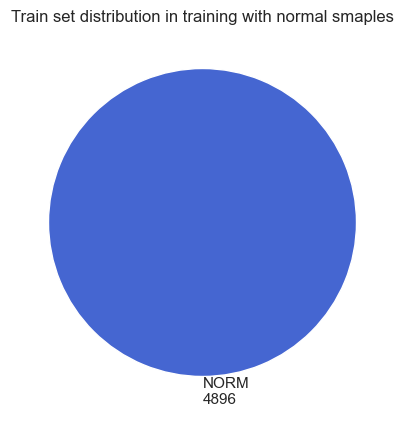

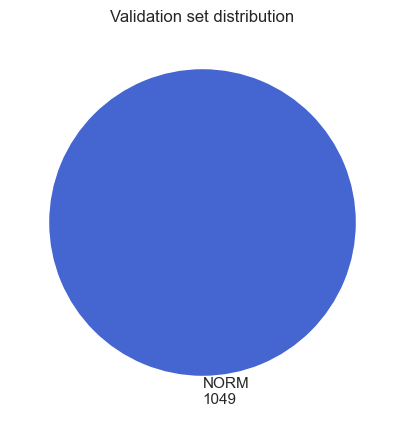

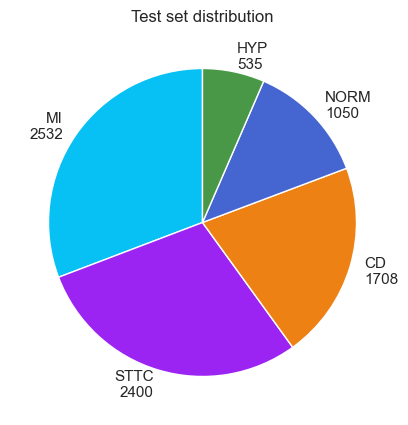

In [633]:
class_colors = {
    'NORM': "#4566D1",
    'HYP': "#489848",
    'MI': "#07C1F4",
    'CD': "#EE8114",
    'STTC': "#9C24F2",

}

plot_class_distribution_abs(Y_train_norm, "Train set distribution in training with normal smaples", class_colors=class_colors)
plot_class_distribution_abs(Y_valid_norm, "Validation set distribution",class_colors=class_colors)
plot_class_distribution_abs(Y_test, "Test set distribution", class_colors=class_colors)


# Segmentation of the ECGS into "individual" heartbeats

![ECG Example](./ECG_pathologies.png)

## How does it works:
 
- creating two functions thats used the neurokit package:
- Segments a multi-lead ECG signal into individual heartbeats based on R-peak detection.
The function takes an entire ECG dataset (X, Y) and cuts each full ECG into smaller heartbeat segments (centered on R-peaks), while keeping track of:
- The label (e.g. NORM, MI, etc.) for each segment.
- From which original ECG that segment came from.

Paramethers:
X: list or array of ECG signals, each of shape (n_samples, n_leads).
Y: dataframe with at least a 'diagnostic_superclass' column — one label per ECG.
sampling_rate: Hz (100 Hz here).
window_before/window_after: time (in seconds) before and after each R-peak to include in each heartbeat segment.
lead_index: which lead to use for R-peak detection (default = 0).
pad_edges: if True, it pads segments that would fall partly outside signal edges.
normalize: if True, normalizes each lead per segment.


It calls a helper (segment_heartbeats_multilead) that:
Detects R-peaks using neurokit2.
Extracts fixed-length windows around each R-peak.


Returns:
        X_seg: (num_segments, segment_length, num_leads)
        Y_seg: list of diagnostic_superclass labels
        ECG_idx: list of ECG indices for traceability


## ECG segmentation Functions

In [634]:
import numpy as np
import pandas as pd
import neurokit2 as nk
from tqdm import tqdm


def segment_heartbeats_multilead(ecg_signal, sampling_rate=100,
                                 window_before=0.2, window_after=0.6,
                                 lead_index=0, pad_edges=True, normalize=True):
    """
    Segments a multi-lead ECG into heartbeats using R-peaks.
    Optionally normalizes each lead of each segment.

    Returns:
        heartbeats: (num_beats, segment_length, num_leads)
        rpeak_indices: indices of detected R-peaks
    """
    if ecg_signal.ndim != 2:
        raise ValueError(f"Expected ECG shape (seq_len, num_leads), got {ecg_signal.shape}")

    ecg_lead = ecg_signal[:, lead_index]
    _, rpeaks = nk.ecg_peaks(ecg_lead, sampling_rate=sampling_rate)
    rpeak_indices = np.array(rpeaks["ECG_R_Peaks"], dtype=int)

    heartbeats = []
    window_samples_before = int(window_before * sampling_rate)
    window_samples_after = int(window_after * sampling_rate)
    segment_length = window_samples_before + window_samples_after

    for r in rpeak_indices:
        start = r - window_samples_before
        end = r + window_samples_after

        if start < 0 or end > ecg_signal.shape[0]:
            if pad_edges:
                pad_left = max(-start, 0)
                pad_right = max(end - ecg_signal.shape[0], 0)
                segment = ecg_signal[max(start,0):min(end,ecg_signal.shape[0]), :]
                if pad_left > 0 or pad_right > 0:
                    segment = np.pad(segment, ((pad_left, pad_right),(0,0)), 'constant')
            else:
                continue
        else:
            segment = ecg_signal[start:end, :]

        # Normalize each lead per segment
        if normalize:
            segment = (segment - segment.mean(axis=0)) / (segment.std(axis=0) + 1e-8)

        heartbeats.append(segment)

    return np.array(heartbeats), rpeak_indices


def segment_dataset_with_labels(X, Y, sampling_rate=100,
                                window_before=0.2, window_after=0.6,
                                lead_index=0, pad_edges=True, normalize=True):
    """
    Segments a dataset and aligns labels to each heartbeat.
    Returns:
        X_seg: (num_segments, segment_length, num_leads)
        Y_seg: list of diagnostic_superclass labels
        ECG_idx: list of original ECG indices for traceability
    """
    X_seg_list = []
    Y_seg_list = []
    ECG_idx_list = [] # map segments back to original ECG

    for idx in tqdm(range(len(X)), desc="Segmenting ECGs"):
        ecg = X[idx]
        label = Y.iloc[idx]['diagnostic_superclass']

        heartbeats, _ = segment_heartbeats_multilead(
            ecg, sampling_rate=sampling_rate,
            window_before=window_before, window_after=window_after,
            lead_index=lead_index, pad_edges=pad_edges, normalize=normalize
        )

        if len(heartbeats) == 0:
            continue  # skip ECGs with no detected beats

        X_seg_list.append(heartbeats)
        Y_seg_list.extend([label] * len(heartbeats))
        ECG_idx_list.extend([idx] * len(heartbeats))  # track original ECG

    X_seg = np.concatenate(X_seg_list, axis=0)
    return X_seg, Y_seg_list, ECG_idx_list




## Apply segmentation functions to X_train, X_Val and and X_test


In [ ]:
# apply to: X_train_norm shape: (4896, 1000, 12)
#X_valid_norm shape: (1049, 1000, 12)
#X_test_norm shape: (1050, 1000, 12)
#X_test shape: (5262, 1000, 12)

# --- Apply to train / val / test ---
# with normalization
#X_train_seg, Y_train_seg, train_ecg_idx = segment_dataset_with_labels(X_train_norm, Y_train_all)
#X_val_seg, Y_val_seg, val_ecg_idx       = segment_dataset_with_labels(X_valid_norm, Y_val_all)
#X_test_seg, Y_test_seg, test_ecg_idx    = segment_dataset_with_labels(X_test_all, Y_test_all)

# without normalization
X_train_seg, Y_train_seg, train_ecg_idx = segment_dataset_with_labels(X_train_norm, Y_train_norm, normalize=False)
X_val_seg,   Y_val_seg,   val_ecg_idx   = segment_dataset_with_labels(X_valid_norm,   Y_valid_norm,  normalize=False)
X_test_seg,  Y_test_seg,  test_ecg_idx  = segment_dataset_with_labels(X_test,  Y_test,  normalize=False)


# Convert labels to DataFrame for easier handling
Y_train_seg_df = pd.DataFrame({'diagnostic_superclass': Y_train_seg, 'ecg_idx': train_ecg_idx})
Y_val_seg_df   = pd.DataFrame({'diagnostic_superclass': Y_val_seg,   'ecg_idx': val_ecg_idx})
Y_test_seg_df  = pd.DataFrame({'diagnostic_superclass': Y_test_seg,  'ecg_idx': test_ecg_idx})

# --- Sanity checks ---
print(f"✅ X_train_seg: {X_train_seg.shape}, Y_train_seg: {len(Y_train_seg_df)}")
print(f"✅ X_val_seg:   {X_val_seg.shape},   Y_val_seg:   {len(Y_val_seg_df)}")
print(f"✅ X_test_seg:  {X_test_seg.shape},  Y_test_seg:  {len(Y_test_seg_df)}")

# Check class distributions
print("\n📊 Train class distribution:")
print(Y_train_seg_df['diagnostic_superclass'].value_counts(normalize=True))
print("\n📊 Validation class distribution:")
print(Y_val_seg_df['diagnostic_superclass'].value_counts(normalize=True))
print("\n📊 Test class distribution:")
print(Y_test_seg_df['diagnostic_superclass'].value_counts(normalize=True))


Segmenting ECGs: 100%|██████████| 8225/8225 [00:02<00:00, 3447.22it/s]


✅ X_train_seg: (55174, 80, 12), Y_train_seg: 55174
✅ X_val_seg:   (11895, 80, 12),   Y_val_seg:   11895
✅ X_test_seg:  (99875, 80, 12),  Y_test_seg:  99875

📊 Train class distribution:
diagnostic_superclass
NORM    1.0
Name: proportion, dtype: float64

📊 Validation class distribution:
diagnostic_superclass
NORM    1.0
Name: proportion, dtype: float64

📊 Test class distribution:
diagnostic_superclass
[STTC]    0.306633
[MI]      0.305141
[CD]      0.205016
NORM      0.120160
[HYP]     0.063049
Name: proportion, dtype: float64


| Dimension | Meaning   (train set)                      |
| --------- | ------------------------------------------ |
| `55174`  | number of segments (heartbeats)            |
| `80`      | number of time steps (samples) per segment |
| `12`      | number of leads (channels) per sample      |

In [636]:
# --- Sanity checks on shapes ---  
sampling_rate = 100
window_before = 0.2
window_after = 0.6
assert X_train_seg.shape[0] == len( Y_train_seg) == len(train_ecg_idx), "Segmentation produced mismatched lengths"
seg_len_expected = int(round((window_before + window_after) * sampling_rate))
assert X_train_seg.shape[1] == seg_len_expected, "Segment length mismatch"

assert X_val_seg.shape[0] == len( Y_val_seg) == len(val_ecg_idx), "Segmentation produced mismatched lengths"
assert X_val_seg.shape[1] == seg_len_expected, "Segment length mismatch"
assert X_test_seg.shape[0] == len( Y_test_seg) == len(test_ecg_idx), "Segmentation produced mismatched lengths"
assert X_test_seg.shape[1] == seg_len_expected, "Segment length mismatch"




In [637]:
# Replace these names with your variables

# Y_train, Y_val, Y_test : dataframes you passed to segmentation; each has a column 'ecg_id' (stable id)
import numpy as np

print("Example ECG_idx_train[:10]:", train_ecg_idx[:10])
print("train split size (n_ecgs):", len(Y_train_seg))
print("max ECG_idx_train:", np.max(train_ecg_idx), " expected max local index:", len(Y_train_seg)-1)

# If max(ECG_idx_train) <= len(Y_train)-1 it's likely local positions. 
# If values look like large ints/strings and not in 0..len-1, they're probably a ready global ids.

Example ECG_idx_train[:10]: [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
train split size (n_ecgs): 55174
max ECG_idx_train: 4895  expected max local index: 55173


### now indices of ecgs are local for each set.... 

### code to retrive the original index of the ECGs in case is needed

In [ ]:
# we retrieve indexes as local positions  during segmentation, 
# Map local positional ECG_idx -> global ecg_id (if segmentation was done per-split)
# If ECG_idx_train contains local positions into X_train/Y_train:
train_global_ids = Y_train_norm['ecg_id'].to_numpy()    # shape (n_train_ecg,) # mapped to a global ecg_id
val_global_ids   = Y_valid_norm['ecg_id'].to_numpy()
test_global_ids  = Y_test['ecg_id'].to_numpy()

# Map positional ECG_idx -> global ecg_id
# Do this only if ECG_idx arrays are positional (0..len(split)-1)
# Map positional ECG_idx -> global ecg_id
# Do this only if ECG_idx arrays are positional (0..len(split)-1)
ECG_idx_train_global = train_global_ids[np.array(train_ecg_idx, dtype=int)]
ECG_idx_val_global   = val_global_ids[np.array(val_ecg_idx, dtype=int)]
ECG_idx_test_global  = test_global_ids[np.array(test_ecg_idx, dtype=int)]

# Save results
np.save("ECG_idx_train_global.npy", ECG_idx_train_global)
np.save("ECG_idx_val_global.npy", ECG_idx_val_global)
np.save("ECG_idx_test_global.npy", ECG_idx_test_global)

import numpy as np
u_tr = np.unique(ECG_idx_train_global)
u_val = np.unique(ECG_idx_val_global)
u_te  = np.unique(ECG_idx_test_global)

print("train∩val:", np.intersect1d(u_tr, u_val))
print("train∩test:", np.intersect1d(u_tr, u_te))
print("val∩test:", np.intersect1d(u_val, u_te))

assert len(np.intersect1d(u_tr, u_val)) == 0
assert len(np.intersect1d(u_tr, u_te)) == 0
assert len(np.intersect1d(u_val, u_te)) == 0


train∩val: []
train∩test: []
val∩test: []


# Analysis / Vizualization of the segmented heartbeats in train, val and test sets

In [639]:
pd.Series(train_ecg_idx).value_counts().head()


2996    23
1465    22
3141    20
4654    20
3426    19
Name: count, dtype: int64

In [815]:
import pandas as pd

# Combine segment indices into a DataFrame
train_seg_counts = pd.Series(train_ecg_idx).value_counts().sort_index()
val_seg_counts = pd.Series(val_ecg_idx).value_counts().sort_index()
test_seg_counts = pd.Series(test_ecg_idx).value_counts().sort_index()

# Inspect how many segments each ECG produced
print(train_seg_counts.head())
print(f"\nAverage segments per ECG in training set: {train_seg_counts.mean():.2f}")
print(f"Min: {train_seg_counts.min()}, Max: {train_seg_counts.max()}")


# Inspect how many segments each ECG produced
print(val_seg_counts.head())
print(f"\nAverage segments per ECG in validation set: {val_seg_counts.mean():.2f}")
print(f"Min: {val_seg_counts.min()}, Max: {val_seg_counts.max()}")

print(test_seg_counts.head())
print(f"\nAverage segments per ECG in test set: {test_seg_counts.mean():.2f}")
print(f"Min: {test_seg_counts.min()}, Max: {test_seg_counts.max()}")


0    11
1    11
2    12
3     9
4     9
Name: count, dtype: int64

Average segments per ECG in training set: 11.27
Min: 7, Max: 23
0    12
1    11
2    15
3    12
4    12
Name: count, dtype: int64

Average segments per ECG in validation set: 11.34
Min: 6, Max: 21
0     8
1    12
2    11
3    10
4    10
Name: count, dtype: int64

Average segments per ECG in test set: 12.14
Min: 4, Max: 29


Fewer segments = fewer detected R-peaks, likely due to low heart rate, short recording, or weak detection.

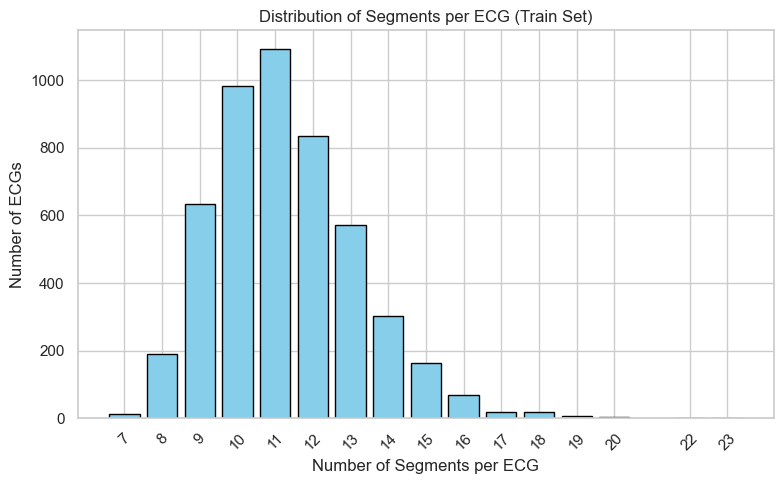

In [642]:
import matplotlib.pyplot as plt

# Get all observed segment counts and their frequencies
seg_counts_vals = train_seg_counts.value_counts().sort_index()
x_vals = seg_counts_vals.index
y_vals = seg_counts_vals.values

plt.figure(figsize=(8,5))
plt.bar(x_vals, y_vals, color='skyblue', edgecolor='black')
plt.title('Distribution of Segments per ECG (Train Set)')
plt.xlabel('Number of Segments per ECG')
plt.ylabel('Number of ECGs')
plt.xticks(x_vals, rotation=45) # show all integer counts as x-axis ticks
plt.tight_layout()
plt.show()

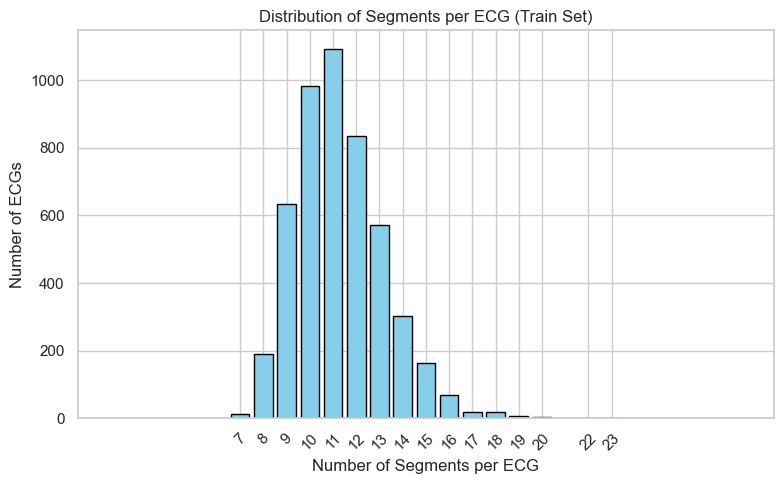

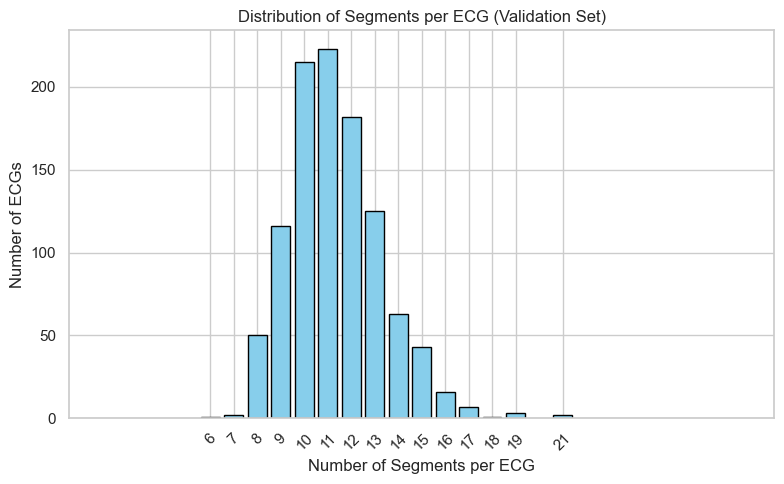

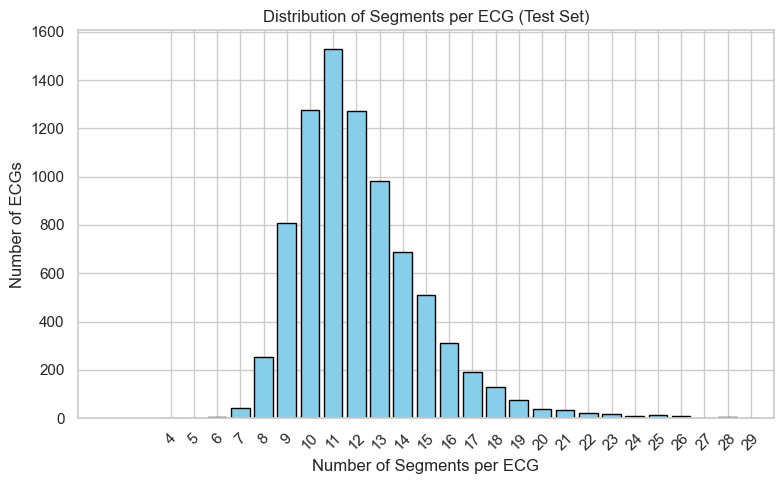

In [817]:
for split_name, seg_counts in zip(
    ['Train', 'Validation', 'Test'],
    [train_seg_counts, val_seg_counts, test_seg_counts]
):
    seg_counts_vals = seg_counts.value_counts().sort_index()
    x_vals = seg_counts_vals.index
    y_vals = seg_counts_vals.values

    plt.figure(figsize=(8,5))
    plt.bar(x_vals, y_vals, color='skyblue', edgecolor='black')
    plt.title(f'Distribution of Segments per ECG ({split_name} Set)')
    plt.xlabel('Number of Segments per ECG')
    plt.ylabel('Number of ECGs')
    plt.xticks(x_vals, rotation=45) # show all integer counts as x-axis ticks
# want that all plots have the same x-axis limits
    plt.xlim(0, max(train_seg_counts.max(), val_seg_counts.max(), test_seg_counts.max()) + 1)
    plt.tight_layout()
    plt.show()



In [916]:
# Find ECGs with fewer than 5 segments
few_segments_ecgs = train_seg_counts[train_seg_counts < 8]

print(f"Number of ECGs with fewer than 8 segments: {len(few_segments_ecgs)}")
print("\nECG indices and number of segments:")
print(few_segments_ecgs)



Number of ECGs with fewer than 8 segments: 12

ECG indices and number of segments:
34      7
237     7
381     7
415     7
432     7
1674    7
1934    7
2242    7
2786    7
3318    7
4036    7
4635    7
Name: count, dtype: int64


In [828]:
import matplotlib.pyplot as plt
import neurokit2 as nk
import numpy as np

def plot_ecg_with_rpeaks_and_windows(ecg_idx, X_ecg, Y_ecg, lead=0, sampling_rate=100, window_before=0.2, window_after=0.6):
    """
    Plots ECG waveform for a given ecg_idx from X_ecg and class from Y_ecg,
    overlays R-peaks, and shows heartbeat segmentation windows.
    Prints the type of the sample (Normal or pathology).

    Parameters:
    - ecg_idx: int, position in X_ecg/Y_ecg
    - X_ecg: np.ndarray, shape (n_ecgs, seq_len, n_leads)
    - Y_ecg: DataFrame, with 'diagnostic_superclass' column
    - lead: int, which lead to plot
    - sampling_rate: int, Hz
    - window_before: float, seconds before R-peak
    - window_after: float, seconds after R-peak
    """

    ecg_signal = X_ecg[ecg_idx] # takes the ecg at position ecg_idx
    label_type = Y_ecg.iloc[ecg_idx]['diagnostic_superclass'] # get the label for that ecg
    print(f"ECG {ecg_idx} type: {label_type}")

    # R-peak detection (for chosen lead)
    _, rpeaks = nk.ecg_peaks(ecg_signal[:, lead], sampling_rate=sampling_rate)
    rpeak_indices = np.array(rpeaks["ECG_R_Peaks"], dtype=int)

    win_before_pts = int(window_before * sampling_rate)
    win_after_pts  = int(window_after  * sampling_rate)

    # Plot
    plt.figure(figsize=(15,4))
    plt.plot(ecg_signal[:, lead], label=f'Lead {lead}')
    plt.scatter(rpeak_indices, ecg_signal[rpeak_indices, lead], color='red', label='R-peaks')

    # Draw segment windows
    for r in rpeak_indices:
        start = max(r - win_before_pts, 0)
        end   = min(r + win_after_pts, ecg_signal.shape[0])
        plt.axvspan(start, end, color="yellow", alpha=0.2)

    plt.title(f"ECG #{ecg_idx} - Lead {lead+1} - Class: {label_type} with R-peaks and Segmentation Windows")
    plt.xlabel("Sample index")
    plt.ylabel("Amplitude")
    plt.legend()
    plt.show()

In [830]:
# Find ECG indices with exactly 11 segments
ecg_idx_11_segments = train_seg_counts[train_seg_counts == 11].index.tolist()[:5]   # up to 5 ECGs with 11 segments

# Find ECG indices with exactly 30 segments
ecg_idx_19_plus_segments = train_seg_counts[train_seg_counts > 19].index.tolist()[:5]   # up to 5 ECGs with >19 segments


# Find ECG indices with exactly 30 segments
ecg_idx_20_segments = train_seg_counts[train_seg_counts == 20].index.tolist()[:5]   # up to 5 ECGs with 20 segments

print(f"Found {len(ecg_idx_11_segments)} ECGs with 11 segments:", ecg_idx_11_segments)
print(f"Found {len(ecg_idx_20_segments)} ECGs with 20 segments:", ecg_idx_20_segments)
print(f"Found {len(ecg_idx_19_plus_segments)} ECGs with >19 segments:", ecg_idx_19_plus_segments)

Found 5 ECGs with 11 segments: [0, 1, 9, 23, 36]
Found 2 ECGs with 20 segments: [3141, 4654]
Found 4 ECGs with >19 segments: [1465, 2996, 3141, 4654]


ECG 0 type: NORM


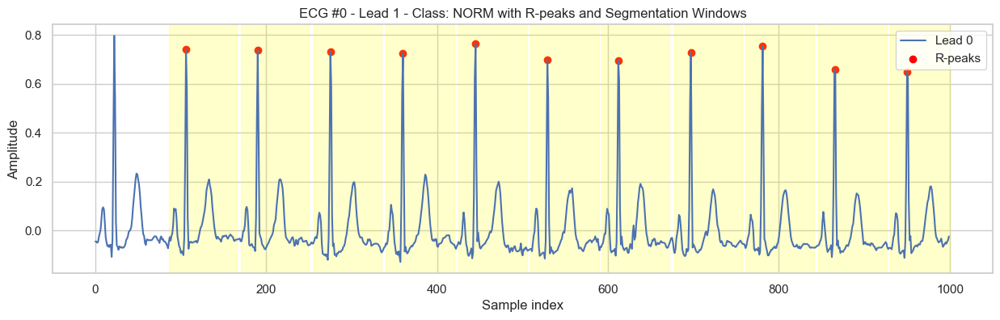

ECG 1 type: NORM


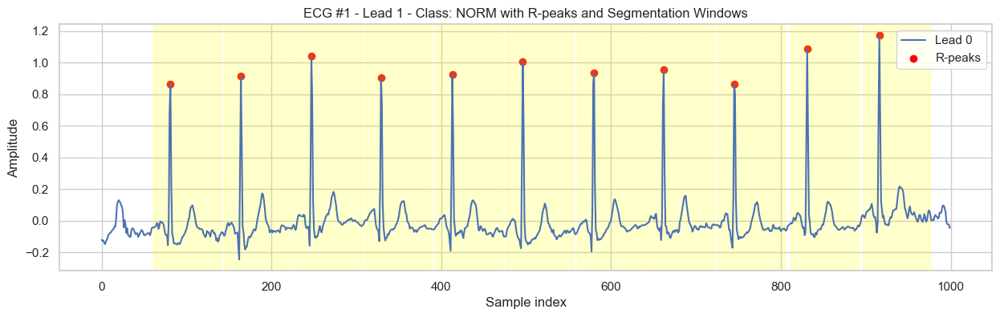

ECG 9 type: NORM


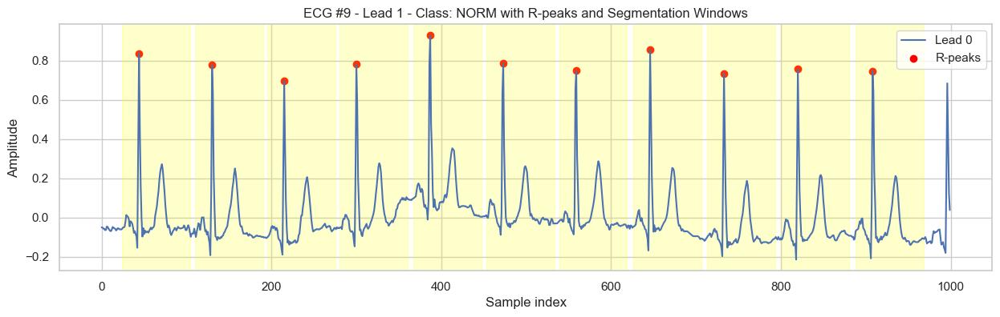

ECG 23 type: NORM


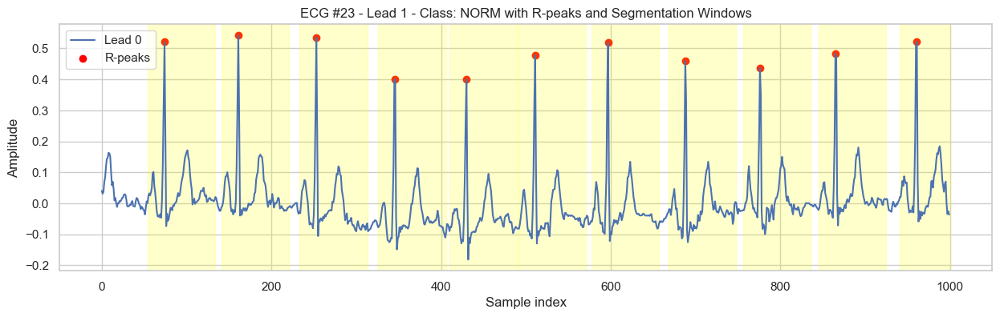

ECG 36 type: NORM


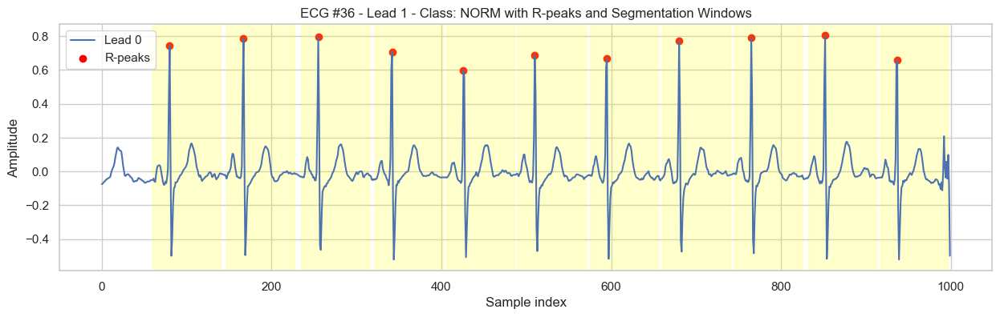

In [831]:
# Plot ECGs with 11 segments
for ecg_idx in ecg_idx_11_segments:
    plot_ecg_with_rpeaks_and_windows(ecg_idx, X_train_norm, Y_train_norm, lead=0, sampling_rate=100, window_before=0.2, window_after=0.6)



ECG 3141 type: NORM


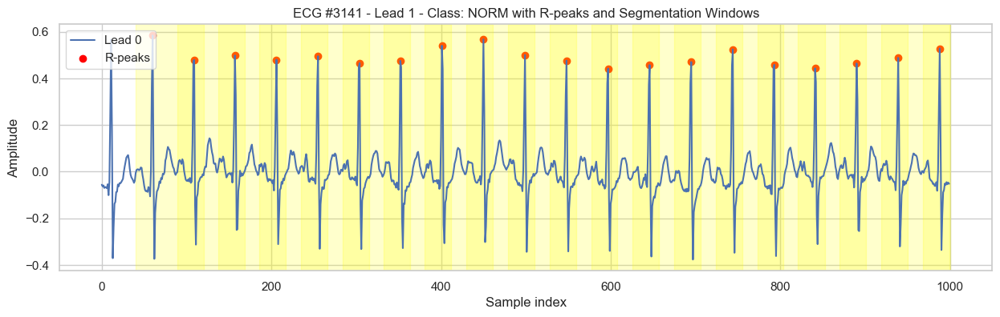

ECG 4654 type: NORM


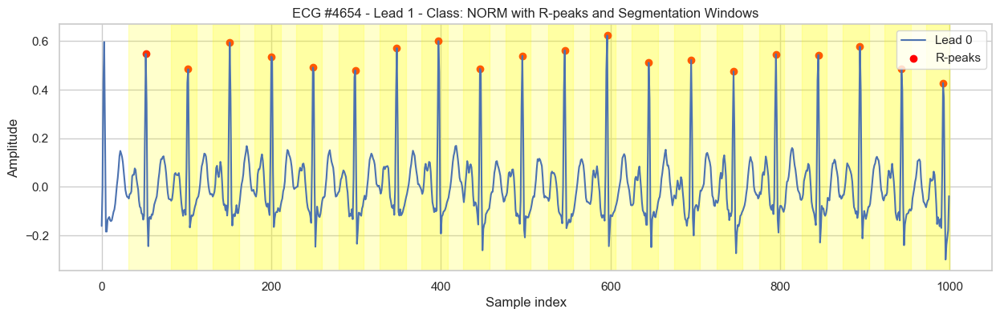

In [832]:
# Plot ECGs with 20 segments
for ecg_idx in ecg_idx_20_segments:
    plot_ecg_with_rpeaks_and_windows(ecg_idx, X_train_norm, Y_train_norm, lead=0, sampling_rate=100, window_before=0.2, window_after=0.6)



ECG 1465 type: NORM


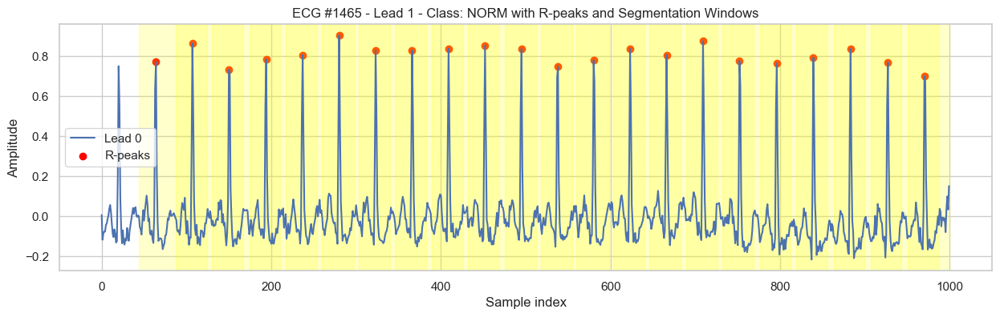

ECG 2996 type: NORM


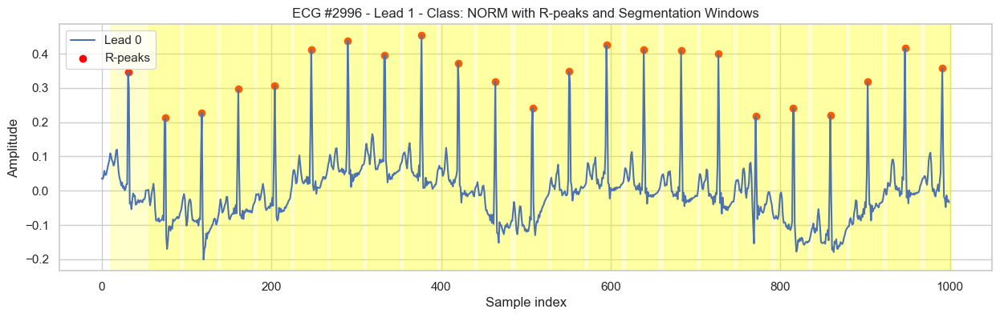

ECG 3141 type: NORM


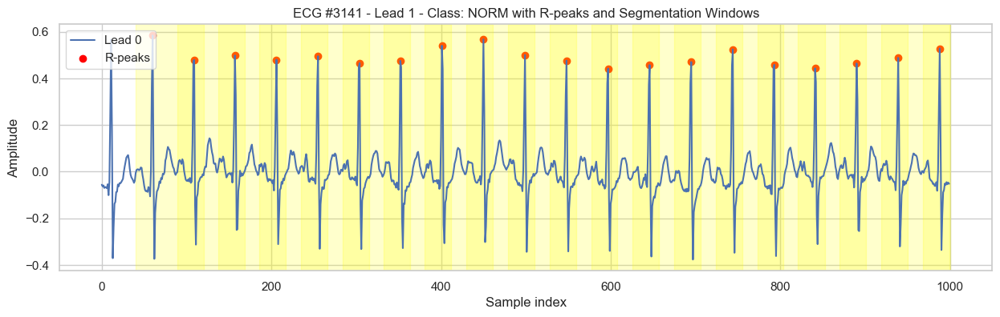

ECG 4654 type: NORM


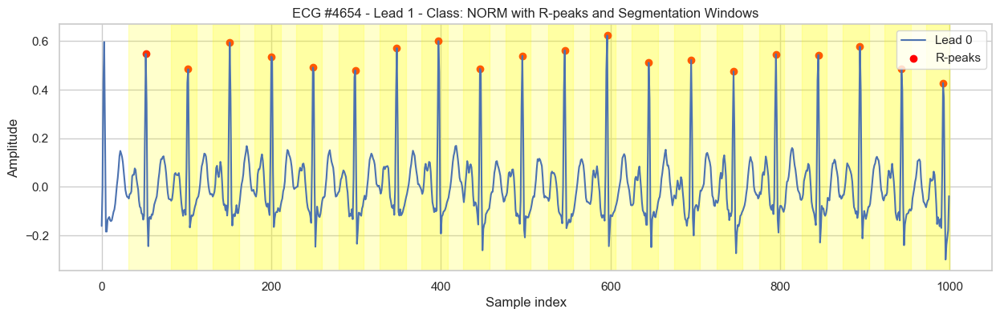

In [ ]:
# Plot ECGs with 19 plus-segments
for ecg_idx in ecg_idx_19_plus_segments:
    plot_ecg_with_rpeaks_and_windows(ecg_idx, X_train_norm, Y_train_norm, lead=0, sampling_rate=100, window_before=0.2, window_after=0.6)



ECG 34 type: NORM


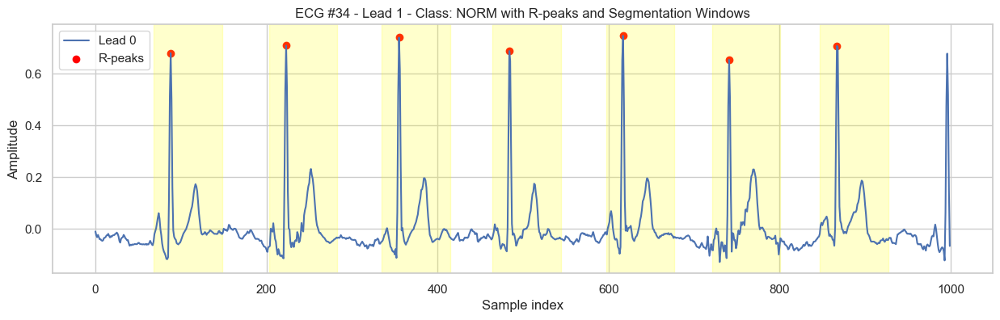

ECG 237 type: NORM


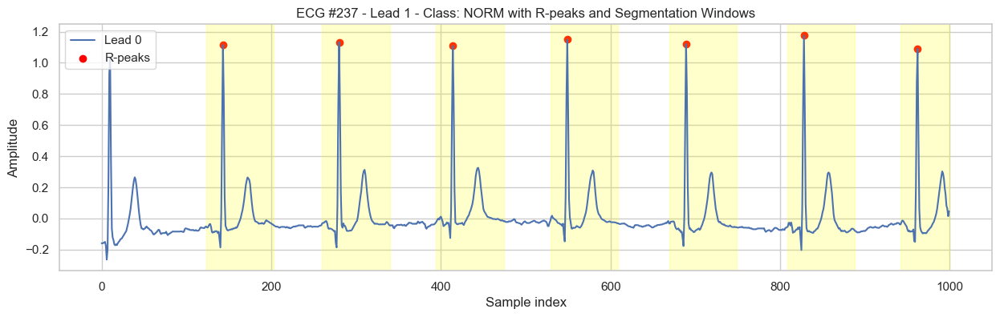

ECG 381 type: NORM


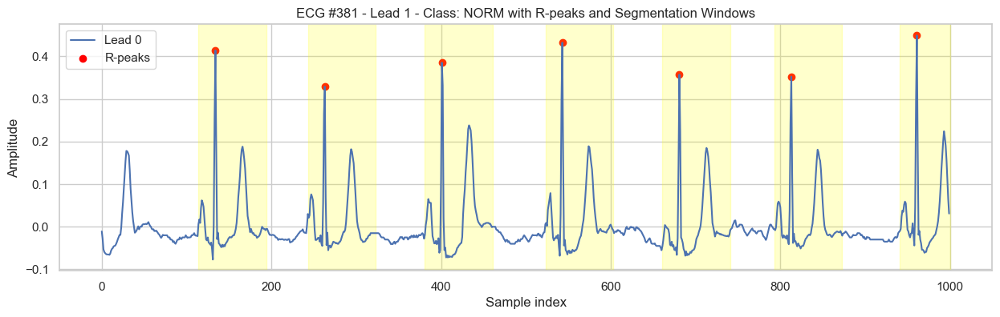

ECG 415 type: NORM


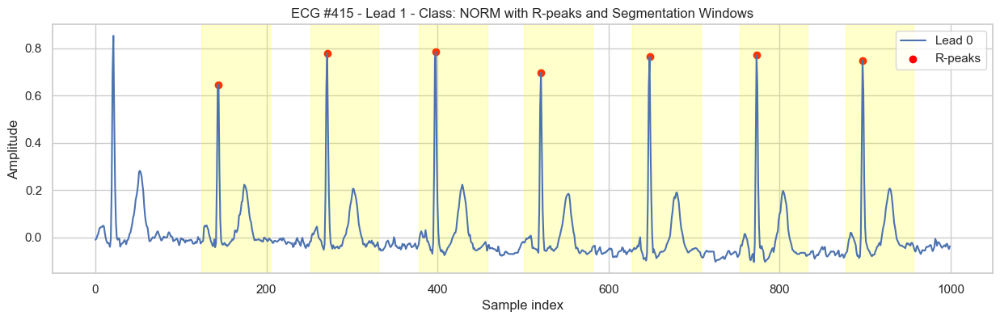

ECG 432 type: NORM


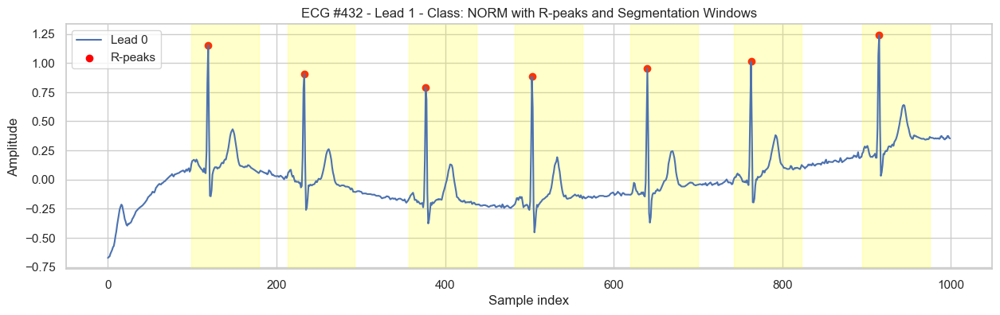

ECG 1674 type: NORM


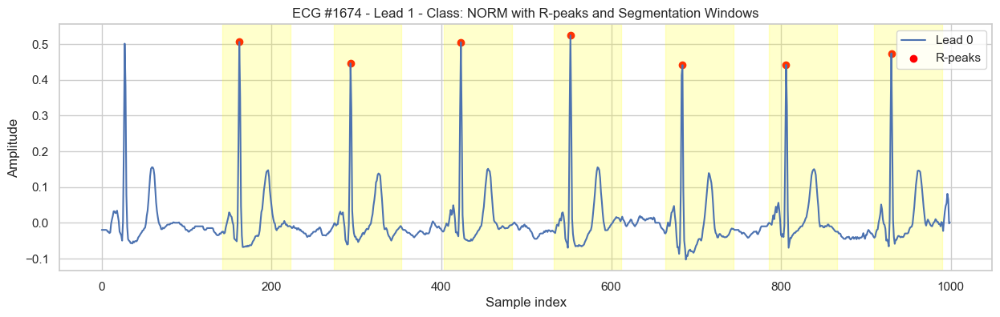

ECG 1934 type: NORM


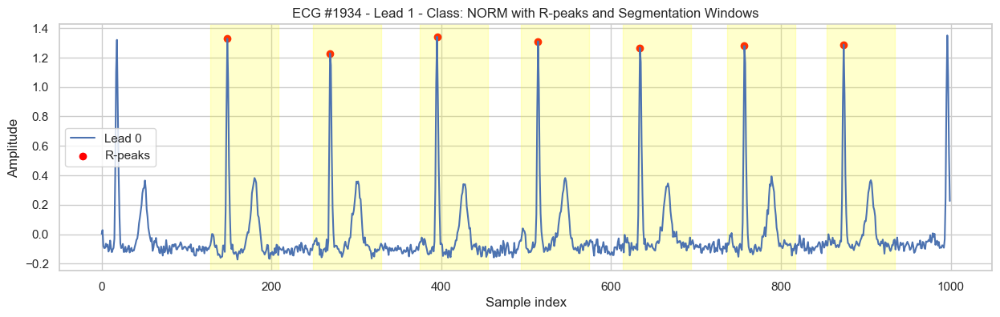

ECG 2242 type: NORM


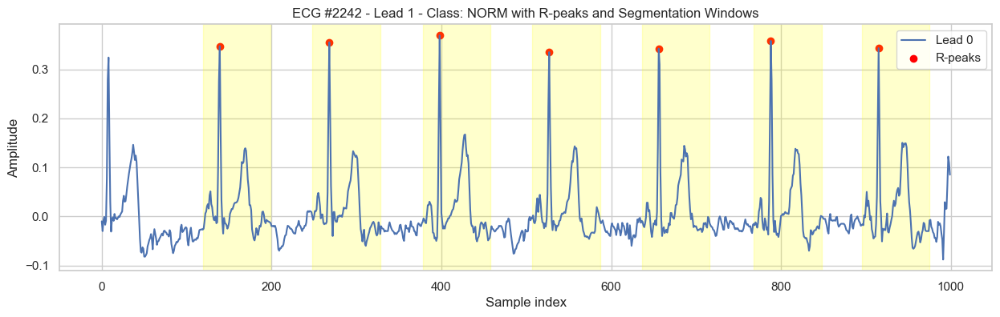

ECG 2786 type: NORM


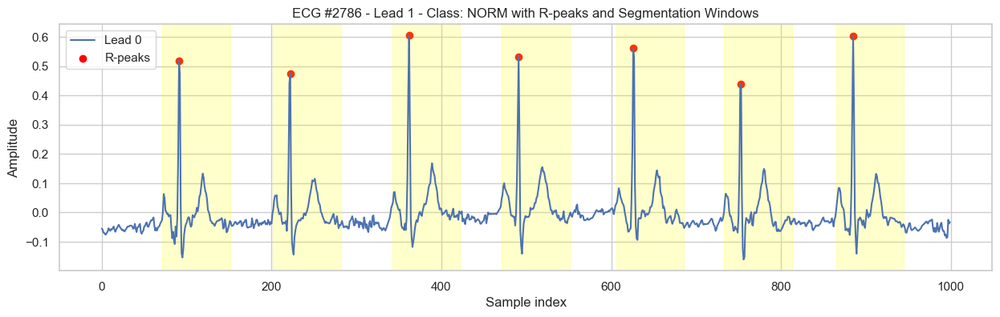

ECG 3318 type: NORM


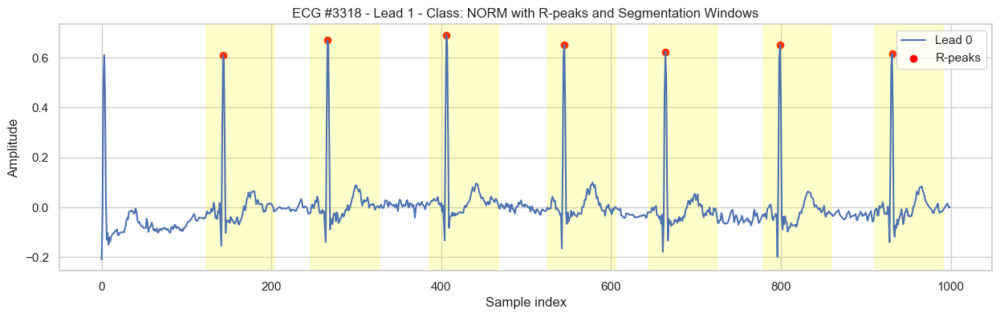

ECG 4036 type: NORM


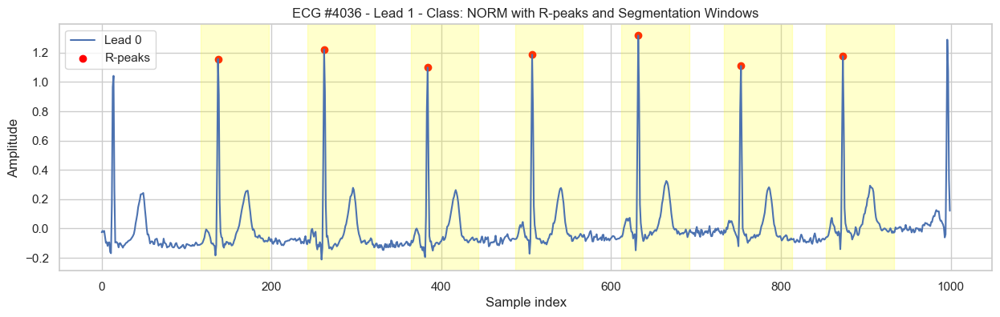

ECG 4635 type: NORM


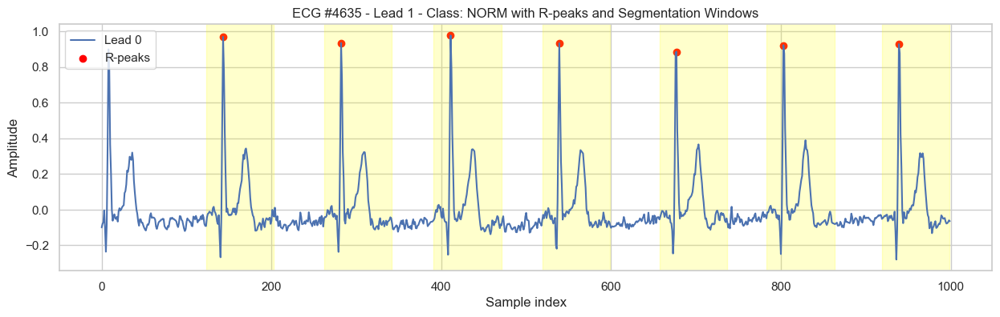

In [918]:
ecg_idx_list=few_segments_ecgs.index.tolist()
for ecg_idx in ecg_idx_list:
    plot_ecg_with_rpeaks_and_windows(ecg_idx, X_train_norm, Y_train_norm, lead=0, sampling_rate=100, window_before=0.2, window_after=0.6)

In [929]:
# Find ECGs with fewer than 5 segments in test set
few_segments_ecgs = test_seg_counts[test_seg_counts < 7]

ECG 2182 type: ['MI']


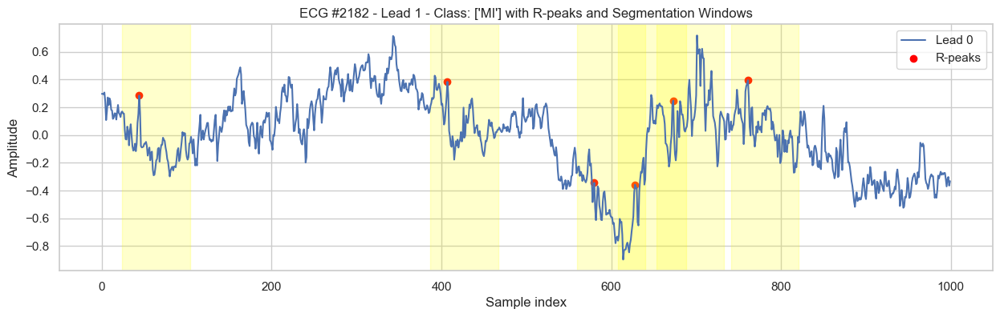

ECG 2237 type: ['HYP']


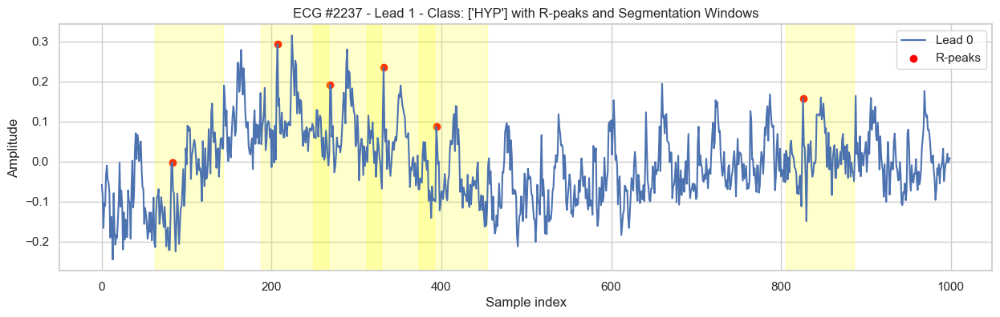

ECG 2576 type: ['MI']


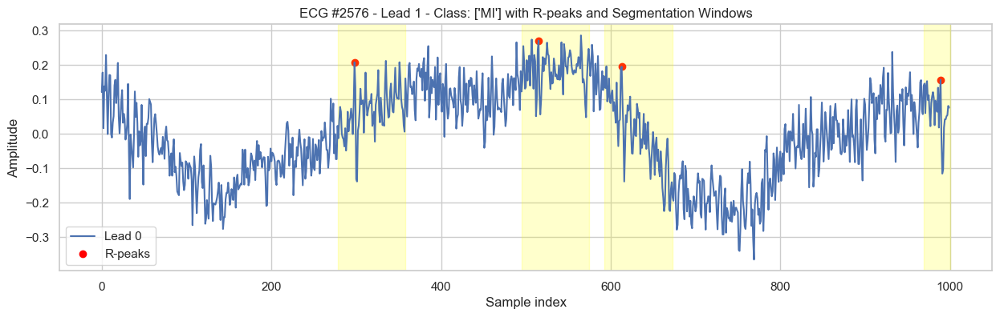

ECG 3754 type: ['STTC']


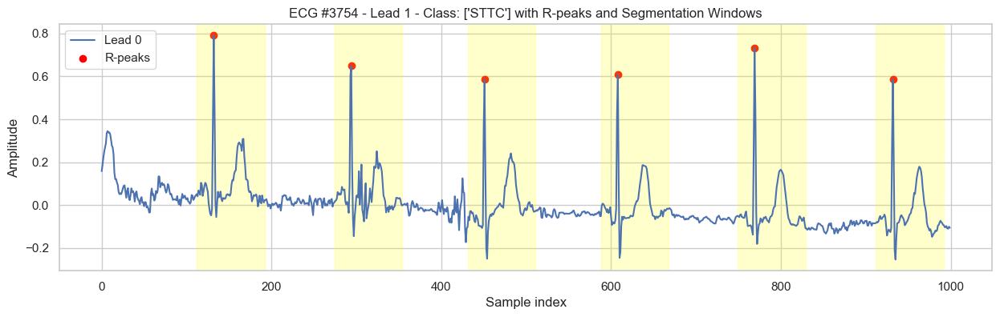

ECG 4215 type: ['CD']


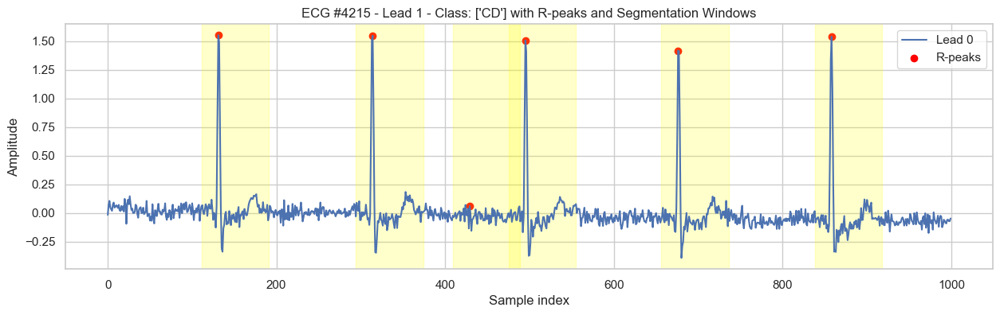

ECG 5245 type: ['MI']


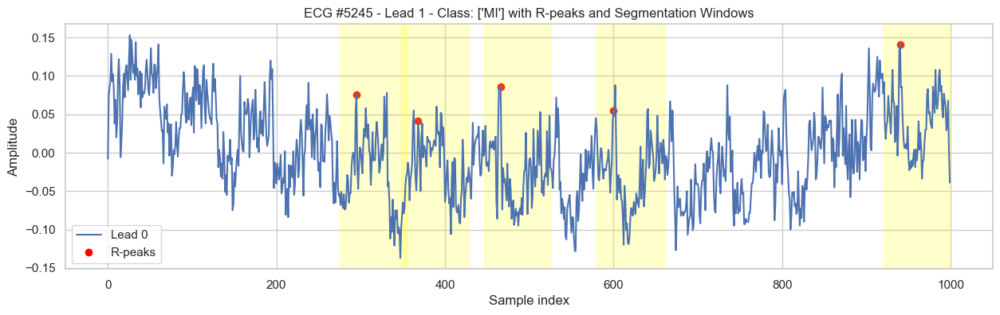

ECG 6348 type: ['MI']


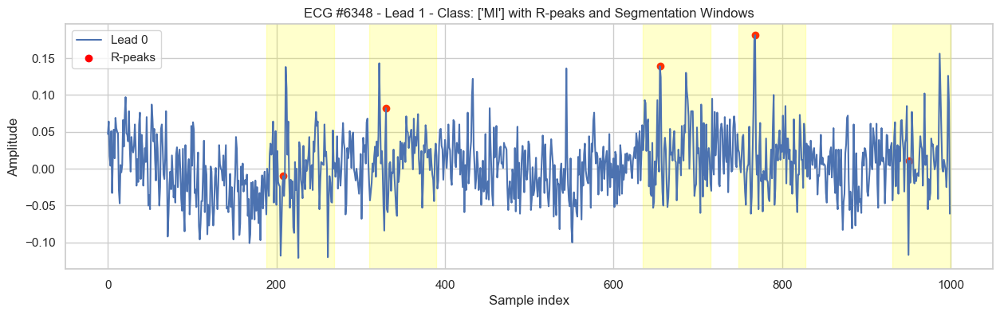

ECG 6691 type: ['HYP']


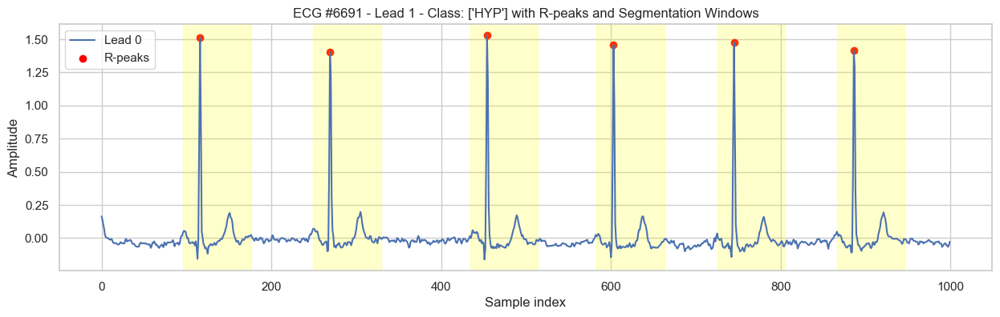

In [930]:
ecg_idx_list=few_segments_ecgs.index.tolist()
for ecg_idx in ecg_idx_list:
    plot_ecg_with_rpeaks_and_windows(ecg_idx, X_test, Y_test, lead=0, sampling_rate=100, window_before=0.2, window_after=0.6)

In [650]:
print(Y_train_seg_df.head())
print(Y_train_seg_df.tail())

  diagnostic_superclass  ecg_idx
0                  NORM        0
1                  NORM        0
2                  NORM        0
3                  NORM        0
4                  NORM        0
      diagnostic_superclass  ecg_idx
55169                  NORM     4895
55170                  NORM     4895
55171                  NORM     4895
55172                  NORM     4895
55173                  NORM     4895


In [651]:
X_train_seg

array([[[-0.046, -0.085, -0.04 , ..., -0.036,  0.267,  0.03 ],
        [-0.027, -0.084, -0.057, ..., -0.034,  0.261,  0.033],
        [-0.042, -0.084, -0.042, ..., -0.035,  0.254,  0.035],
        ...,
        [-0.043, -0.03 ,  0.012, ..., -0.04 , -0.18 ,  0.041],
        [-0.038, -0.029,  0.008, ..., -0.04 , -0.192,  0.038],
        [-0.037, -0.031,  0.007, ..., -0.039, -0.193,  0.035]],

       [[-0.044, -0.041,  0.003, ..., -0.051, -0.206,  0.03 ],
        [-0.044, -0.036,  0.007, ..., -0.05 , -0.218,  0.031],
        [-0.028, -0.033, -0.005, ..., -0.04 , -0.214,  0.033],
        ...,
        [-0.042, -0.004,  0.038, ..., -0.02 , -0.234, -0.089],
        [-0.053, -0.005,  0.048, ..., -0.021, -0.229, -0.09 ],
        [-0.061, -0.005,  0.056, ..., -0.019, -0.23 , -0.089]],

       [[-0.053, -0.008,  0.045, ..., -0.011, -0.208, -0.1  ],
        [-0.043, -0.003,  0.04 , ..., -0.006, -0.2  , -0.098],
        [-0.03 , -0.007,  0.023, ..., -0.003, -0.195, -0.087],
        ...,
        [-0.

In [786]:
import matplotlib.pyplot as plt
import random

def plot_existing_segments(X_seg, Y_seg_df, class_labels, n_samples_per_class=2, max_beats=8):
    for cls in class_labels:
        # Get indices for this class
        idxs = [i for i, row in enumerate(Y_seg_df['diagnostic_superclass']) if cls in row]
        if len(idxs) == 0:
            continue
        selected_idxs = random.sample(idxs, min(n_samples_per_class, len(idxs)))
        
        for i in selected_idxs:
            segment = X_seg[i]  # shape: (segment_length, num_leads)
            
            plt.figure(figsize=(8,4))
            for lead in range(segment.shape[1]):
                plt.plot(segment[:, lead] + lead*0.5, label=f'Lead {lead+1}')
            plt.title(f'Class: {cls} | Segment ECG index: {i}')
            plt.xlabel('Sample points')
            plt.ylabel('Amplitude + offset')
            plt.grid(True, alpha=0.3)
            plt.legend(loc='upper right')
            plt.show()


In [ ]:
# Example classes you have
classes = ['NORM', 'MI', 'CD', 'HYP', 'STTC']

# Plot a few normal and pathological samples
# this would work for whole data set...for only training in normals, then call the test set
# plot_existing_segments(X_train_seg, Y_train_seg_df, class_labels=classes, n_samples_per_class=2, max_beats=8)

plot_existing_segments(X_test_seg, Y_test_seg_df, class_labels=classes, n_samples_per_class=3, max_beats=8)


In [789]:
import numpy as np
import matplotlib.pyplot as plt
import random
import neurokit2 as nk

def plot_heartbeats_by_class(X, Y, class_labels, n_samples_per_class=2, max_beats=8, sampling_rate=100):
    """
    Plot segmented heartbeats for a few samples per class.
    
    X : np.array, shape (n_samples, seq_len, n_leads)
        ECG signals
    Y : pd.DataFrame or list of label sets
        Labels corresponding to each sample
    class_labels : list of str
        List of classes to plot
    n_samples_per_class : int
        Number of ECGs to randomly select per class
    max_beats : int
        Max number of heartbeats to plot per ECG
    sampling_rate : int
        ECG sampling rate (Hz)
    """
    
    for cls in class_labels:
        # Get indices for this class
        if isinstance(Y, pd.DataFrame):
            idxs = [i for i, row in enumerate(Y['diagnostic_superclass']) if cls in (row if isinstance(row, list) else [])]
        else:
            idxs = [i for i, lbls in enumerate(Y) if cls in lbls]
        
        if len(idxs) == 0:
            continue
        
        selected_idxs = random.sample(idxs, min(n_samples_per_class, len(idxs)))
        
        for i in selected_idxs:
            ecg = X[i]  # shape (seq_len, n_leads)
            
            # Segment into heartbeats
            _, rpeaks = nk.ecg_peaks(ecg[:,0], sampling_rate=sampling_rate)
            r_indices = rpeaks["ECG_R_Peaks"]
            
            heartbeats = []
            for r in r_indices[:max_beats]:
                start = int(r - 0.2 * sampling_rate)
                end = int(r + 0.6 * sampling_rate)
                if start < 0 or end > ecg.shape[0]:
                    continue
                heartbeats.append(ecg[start:end,:])
            
            if len(heartbeats) == 0:
                continue
            
            heartbeats = np.array(heartbeats)  # shape (num_beats, beat_len, n_leads)
            
            # Plot stacked heartbeats
            plt.figure(figsize=(10, 6))
            for j, hb in enumerate(heartbeats):
                for lead in range(hb.shape[1]):
                    offset = j + lead*0.5  # stagger for clarity
                    plt.plot(hb[:, lead] + offset, label=f'Lead {lead+1}' if j==0 else "")
            plt.title(f'Class: {cls} | Sample index: {i}')
            plt.xlabel('Sample points')
            plt.ylabel('Amplitude + offset')
            plt.grid(True, alpha=0.3)
            plt.legend(loc='upper right')
            plt.show()


In [836]:
# Y_test had combination of string and list in diagnistic_superclass, convert to list for visualization
Y_test_fixed = Y_test.copy()
Y_test_fixed['diagnostic_superclass'] = Y_test_fixed['diagnostic_superclass'].apply(lambda x: [x] if isinstance(x, str) else x)

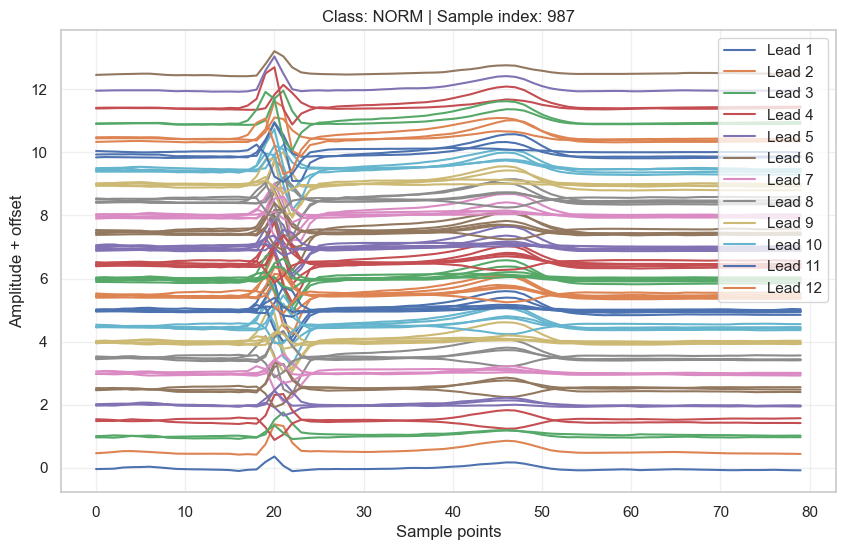

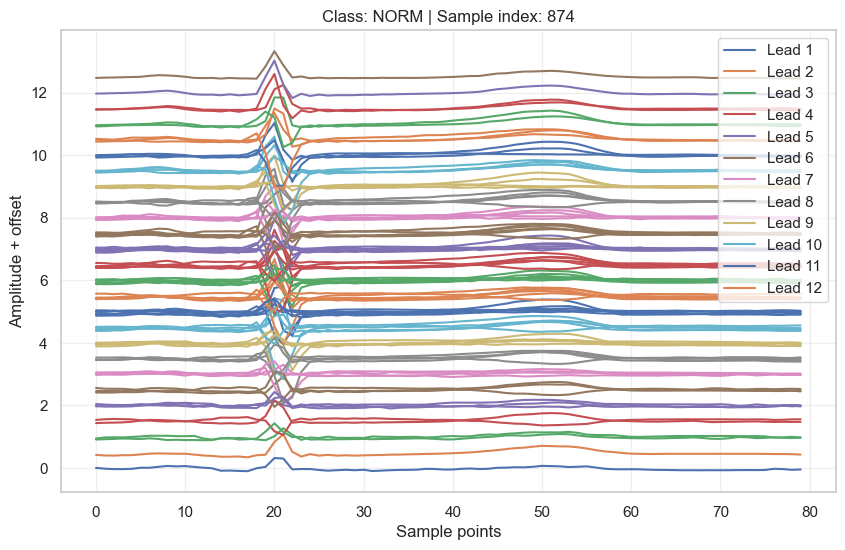

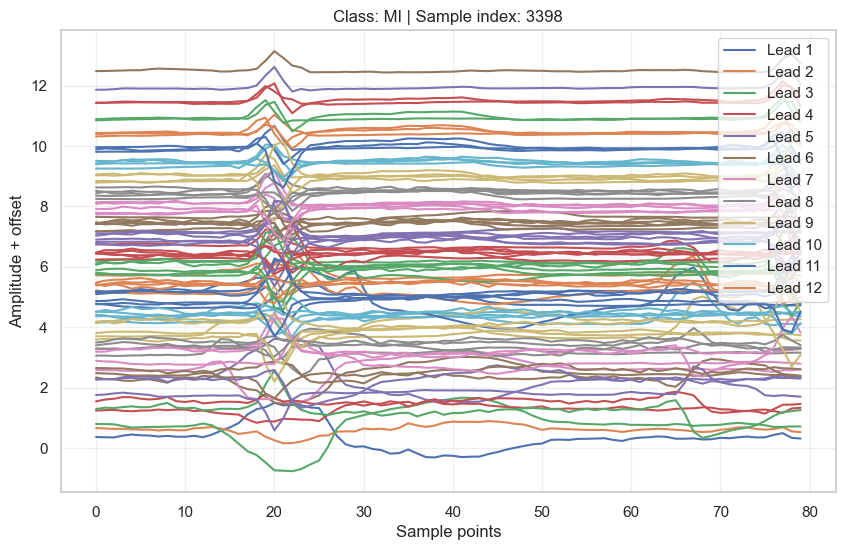

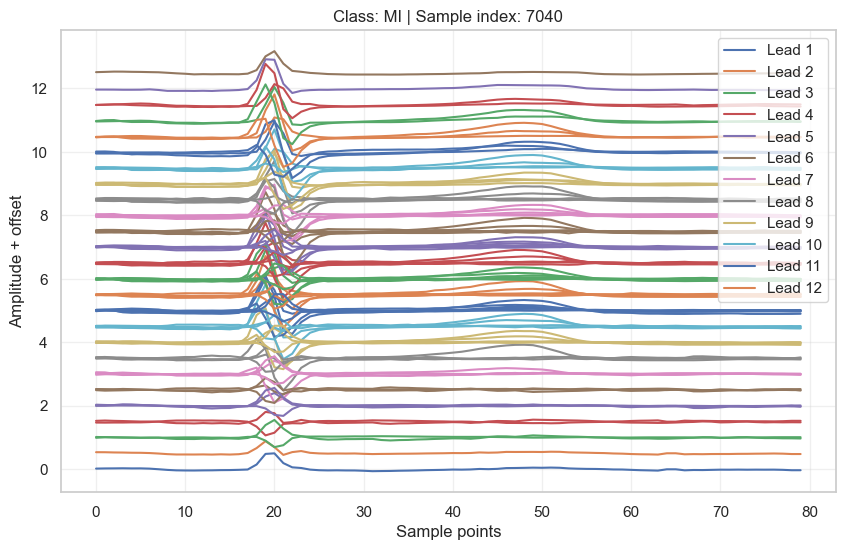

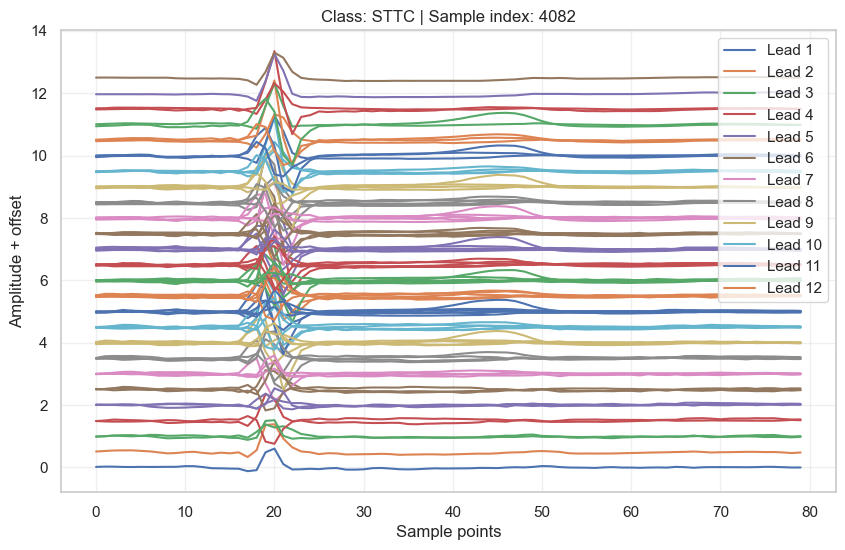

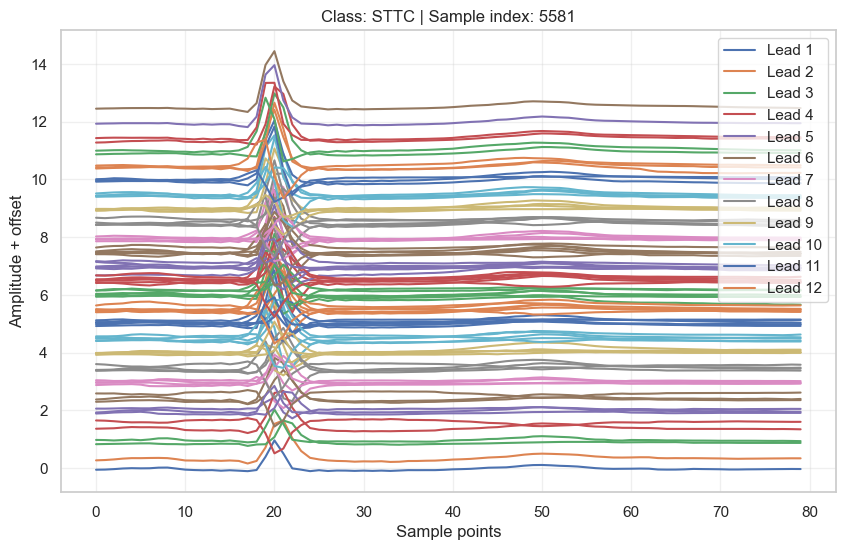

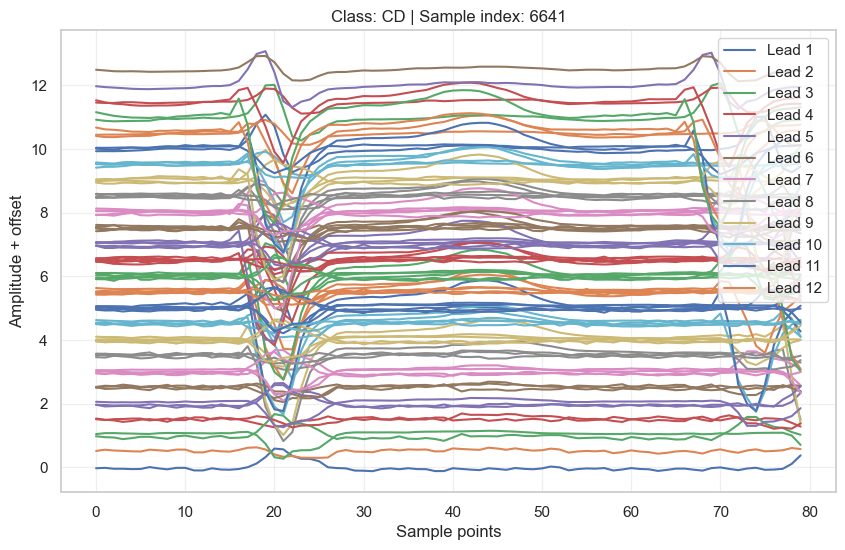

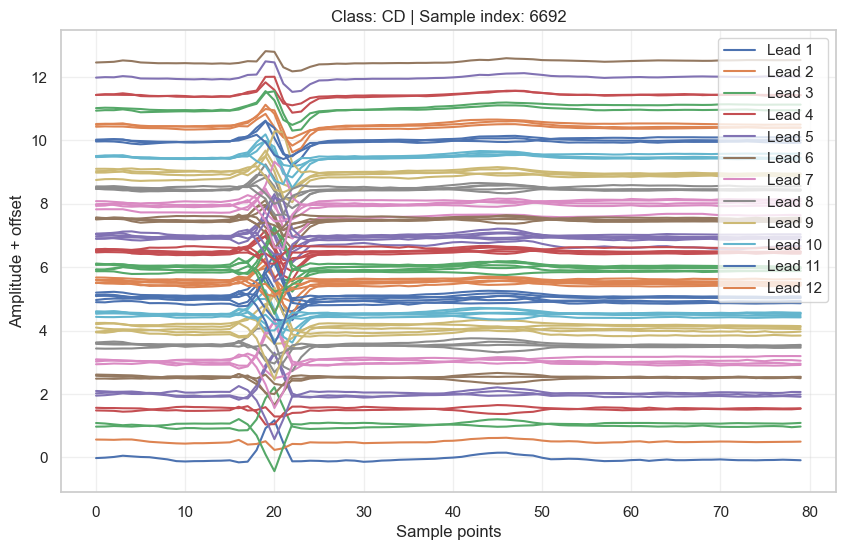

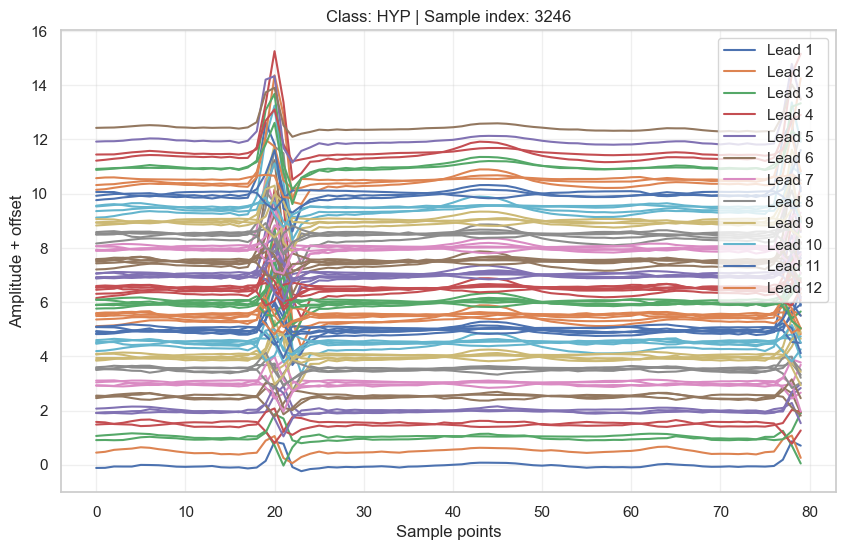

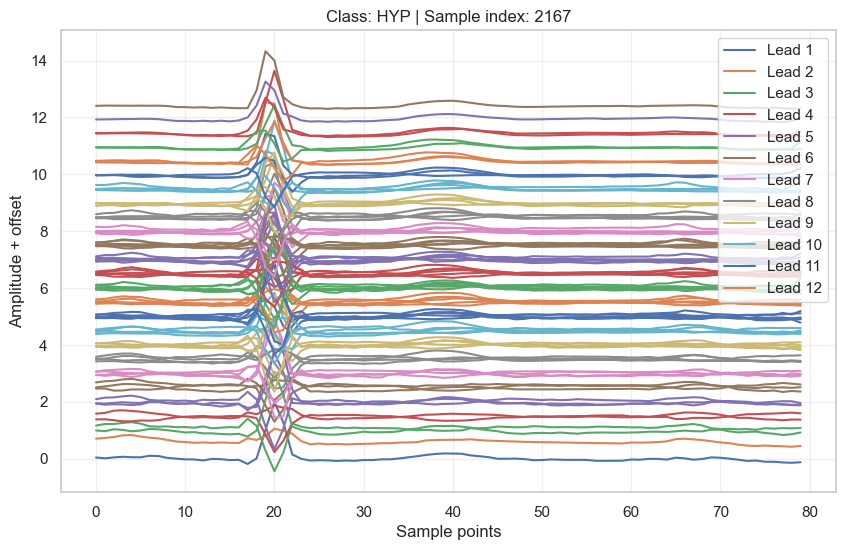

In [837]:
classes = ['NORM', 'MI', 'STTC', 'CD', 'HYP']
# for examples on the whole data set
#plot_heartbeats_by_class(X_train_all, Y_train_all, class_labels=classes, n_samples_per_class=3)
# for examples on the the training on normals data set, use the test set
plot_heartbeats_by_class(X_test, Y_test_fixed, class_labels=classes, n_samples_per_class=2)

# Setting up Data for Autoencoder

## Define the Data set that allow to Add Segment IDs

In [ ]:
# This is working to add the segments ID to the class
class CleanHeartbeatDataset(Dataset):
    """
    Dataset for segmented heartbeats.
    Returns normalized signals, optionally labels, and segment IDs.
    """
    def __init__(self, heartbeats, labels=None, segment_ids=None, mean=None, std=None):
        if isinstance(heartbeats, np.ndarray):
            heartbeats = list(heartbeats)

        # Keep only valid samples (and keep labels/IDs in sync)
        valid_data = [
            (hb, labels[i] if labels is not None else 0,
             segment_ids[i] if segment_ids is not None else str(i))
            for i, hb in enumerate(heartbeats)
            if hb is not None and len(hb) > 0
        ]

        self.heartbeats = [torch.tensor(hb, dtype=torch.float32) for hb, _, _ in valid_data]
        self.labels = [lbl for _, lbl, _ in valid_data]
        self.segment_ids = [sid for _, _, sid in valid_data]
# store normalization parameters that will be applied per lead if provided when we initialize the dataset
        self.mean = torch.tensor(mean, dtype=torch.float32) if mean is not None else None
        self.std = torch.tensor(std, dtype=torch.float32) if std is not None else None

    def __len__(self):
        return len(self.heartbeats) # reeturn number of heartbeats

    def __getitem__(self, idx):
        clean = self.heartbeats[idx]

        # Apply per-lead normalization
        if self.mean is not None and self.std is not None:
            clean = (clean - self.mean) / self.std

        noisy = clean.clone()
        label = self.labels[idx]
        seg_id = self.segment_ids[idx]

        return noisy, clean, label, seg_id

# returns:
#noisy: the (optionally normalized) segment
##clean: the same segment (could be used differently in denoising autoencoders)
#label: class label (or 0 if none provided)
# seg_id: unique ID for traceability (can match back to original ECG, etc.)




## Define the collate function for batching the segments into the data loader (optionaly add noise and accepts segments IDs)

In [ ]:
def collate_ae_dataset_IDs(samples, noise_rate=0.0, fs=100):
    """
    Collate ECG samples into a batch for denoising autoencoder training.
    Adds synthetic noise to a fraction of samples (noise_rate).
    Returns: noisy batch, clean batch, labels (optional), segment IDs, applied_noise_types
    """
    # Extract noisy, clean, labels, seg_ids for each sample in the batch
    noisy_list, clean_list, labels_list, seg_ids_list = [], [], [], []
    applied_noise_types = []

    for noisy, clean, label, seg_id in samples:
        noisy_list.append(noisy)
        clean_list.append(clean)
        labels_list.append(label)
        seg_ids_list.append(seg_id)
        applied_noise_types.append('clean')  # default

    # Stack tensors, combine all segments into tensors
    xns = torch.stack(noisy_list) # batch noisy segments 
    xs  = torch.stack(clean_list) # batch clean segments

    # Apply noise to a fraction of samples if requested when preparing the loaders
    total_size = xs.shape[0]
    num_noisy = int(total_size * noise_rate)
    if num_noisy > 0:
        noise_types = ['gaussian', 'baseline', 'powerline', 'randomburst']
        k = max(1, num_noisy // 4)
        noise_indices = np.random.permutation(total_size)

        for i, noise_type in enumerate(noise_types):
            idx_range = noise_indices[i*k:(i+1)*k]
            for idx in idx_range:
                applied_noise_types[idx] = noise_type
                for lead in range(xns.shape[2]):
                    if noise_type == 'gaussian':
                        xns[idx, :, lead] += 0.03 * torch.randn(xns[idx, :, lead].shape)
                    elif noise_type == 'baseline':
                        t = torch.arange(xns.shape[1]) / fs
                        xns[idx, :, lead] += 0.05 * torch.sin(2 * np.pi * 0.3 * t)
                    elif noise_type == 'powerline':
                        t = torch.arange(xns.shape[1]) / fs
                        phase = np.random.uniform(0, 2*np.pi)
                        xns[idx, :, lead] += 0.1 * torch.sin(2*np.pi*20*t + phase)
                    elif noise_type == 'randomburst':
                        for _ in range(3):
                            start = np.random.randint(0, xns.shape[1]-15)
                            xns[idx, start:start+15, lead] += 0.1 * torch.randn(15)

    return xns.to(device), xs.to(device), labels_list, seg_ids_list, applied_noise_types


 Returns
xns: batch of noisy (or clean) inputs (moved to device)
xs: batch of clean originals (target outputs, moved to device)
labels_list: labels for each segment
seg_ids_list: IDs for traceability/debugging
applied_noise_types: list of noise types assigned to each

In [658]:
m = X_train_seg.mean(axis=(0,1))  # mean per lead
s = X_train_seg.std(axis=(0,1))   # std per lead

print(f'm: {m}')
print(f's: {s}')

m: [ 0.00286657  0.00387957  0.00101305 -0.0033682   0.00098515  0.00248309
 -0.00177193  0.00219227  0.00429775  0.00548004  0.00540675  0.00355655]
s: [0.13749609 0.16543396 0.11906208 0.14000798 0.09845419 0.12653041
 0.18245262 0.289069   0.26912383 0.2661953  0.24975314 0.21803337]


In [659]:
m = torch.tensor(m, dtype=torch.float32)
s = torch.tensor(s, dtype=torch.float32)

## Build Datasets and DataLoaders for training with the entire dataset

### Build the Datasets

In [ ]:
#Use the modified CleanHeartbeatDataset with per-lead normalization (using the computed mean and std from training set)
train_dataset = CleanHeartbeatDataset(X_train_seg, mean=m, std=s)
val_dataset   = CleanHeartbeatDataset(X_val_seg,   mean=m, std=s)



test_dataset = CleanHeartbeatDataset(
    heartbeats=X_test_seg,
    labels= Y_test_seg,         # true diagnostic labels
    segment_ids= test_ecg_idx,
    mean=m,
    std=s
)

/var/folders/_q/5x9zh28s2pj47my26qs5235c0000gn/T/ipykernel_1250/4048109713.py:23: UserWarning:

To copy construct from a tensor, it is recommended to use sourceTensor.detach().clone() or sourceTensor.detach().clone().requires_grad_(True), rather than torch.tensor(sourceTensor).

/var/folders/_q/5x9zh28s2pj47my26qs5235c0000gn/T/ipykernel_1250/4048109713.py:24: UserWarning:

To copy construct from a tensor, it is recommended to use sourceTensor.detach().clone() or sourceTensor.detach().clone().requires_grad_(True), rather than torch.tensor(sourceTensor).



### Build the DataLoaders

In [662]:
from functools import partial

NOISE_RATE = 0.2 # 20% of samples will have noise added
BATCH_SIZE = 64
sampling_rate = 100

# Collate function that adds any kind of noise
collate_fn_IDs = partial(collate_ae_dataset_IDs, noise_rate=NOISE_RATE, fs=sampling_rate)

train_loader = torch.utils.data.DataLoader(
    train_dataset,
    batch_size=BATCH_SIZE,
    shuffle=True,
    collate_fn=collate_fn_IDs,
    drop_last=True
)

val_loader = torch.utils.data.DataLoader(
    val_dataset,
    batch_size=BATCH_SIZE,
    shuffle=False,
    collate_fn=collate_fn_IDs,
    drop_last=True
)

test_loader = torch.utils.data.DataLoader(
    test_dataset,
    batch_size=BATCH_SIZE,
    shuffle=False,
    collate_fn=partial(collate_ae_dataset_IDs, noise_rate=0.0, fs=sampling_rate)  # no noise for testing
)



In [663]:
print(len(test_dataset.heartbeats), len(test_dataset.labels), len(test_dataset.segment_ids))


99875 99875 99875


In [664]:
# Grab one batch from the test loader
batch = next(iter(test_loader))

# Print info for each item in the batch
for i, item in enumerate(batch):
    if torch.is_tensor(item):
        print(f"Item {i}: Tensor, shape = {item.shape}, dtype = {item.dtype}")
        print(f"  First sample, first 5 values (first lead): {item[0, :5, 0]}")
        print(f"  Min: {item.min().item():.4f}, Max: {item.max().item():.4f}, Mean: {item.mean().item():.4f}")
    elif isinstance(item, list):
        print(f"Item {i}: list, length = {len(item)}, first 5 elements: {item[:5]}")
    else:
        print(f"Item {i}: type = {type(item)}")


Item 0: Tensor, shape = torch.Size([64, 80, 12]), dtype = torch.float32
  First sample, first 5 values (first lead): tensor([-0.3336, -0.2972, -0.3190, -0.3336, -0.1081], device='mps:0')
  Min: -8.2899, Max: 9.9922, Mean: 0.0189
Item 1: Tensor, shape = torch.Size([64, 80, 12]), dtype = torch.float32
  First sample, first 5 values (first lead): tensor([-0.3336, -0.2972, -0.3190, -0.3336, -0.1081], device='mps:0')
  Min: -8.2899, Max: 9.9922, Mean: 0.0189
Item 2: list, length = 64, first 5 elements: ['NORM', 'NORM', 'NORM', 'NORM', 'NORM']
Item 3: list, length = 64, first 5 elements: [0, 0, 0, 0, 0]
Item 4: list, length = 64, first 5 elements: ['clean', 'clean', 'clean', 'clean', 'clean']


the loader in the test data set are returnen what we wanted

In [ ]:
# Grab one batch from the val loader
batch = next(iter(val_loader))

# Print info for each item in the batch
for i, item in enumerate(batch):
    if torch.is_tensor(item):
        print(f"Item {i}: Tensor, shape = {item.shape}, dtype = {item.dtype}")
        print(f"  First sample, first 5 values (first lead): {item[0, :5, 0]}")
        print(f"  Min: {item.min().item():.4f}, Max: {item.max().item():.4f}, Mean: {item.mean().item():.4f}")
    elif isinstance(item, list):
        print(f"Item {i}: list, length = {len(item)}, first 5 elements: {item[:5]}")
    else:
        print(f"Item {i}: type = {type(item)}")

Item 0: Tensor, shape = torch.Size([64, 80, 12]), dtype = torch.float32
  First sample, first 5 values (first lead): tensor([-0.3627, -0.2390, -0.0354,  0.0301,  0.1392], device='mps:0')
  Min: -12.1005, Max: 14.1559, Mean: -0.0102
Item 1: Tensor, shape = torch.Size([64, 80, 12]), dtype = torch.float32
  First sample, first 5 values (first lead): tensor([-0.3627, -0.2390, -0.0354,  0.0301,  0.1392], device='mps:0')
  Min: -12.0778, Max: 14.1489, Mean: -0.0117
Item 2: list, length = 64, first 5 elements: [0, 0, 0, 0, 0]
Item 3: list, length = 64, first 5 elements: ['0', '1', '2', '3', '4']
Item 4: list, length = 64, first 5 elements: ['clean', 'clean', 'clean', 'clean', 'clean']


In [666]:
batch = next(iter(test_loader))
print("First 5 segment IDs:", batch[3][:5])


First 5 segment IDs: [0, 0, 0, 0, 0]


## Prepare Dataset and DataLoaders for Autoencoder Hyperparameter Optimization (Optuna)- create small dataset & loaders

In [667]:
# genenerate small train and val loaders for optuna optimization
sample_frac = 0.05  # 5% for fast trials
n_train = int(len(X_train_seg) * sample_frac)
n_val = int(len(X_val_seg) * sample_frac)

idx_train = np.random.choice(len(X_train_seg), n_train, replace=False)
idx_val = np.random.choice(len(X_val_seg), n_val, replace=False)

X_train_small = X_train_seg[idx_train]
Y_train_small = Y_train_seg_df.iloc[idx_train]

X_val_small = X_val_seg[idx_val]
Y_val_small = Y_val_seg_df.iloc[idx_val]



train_dataset_small = CleanHeartbeatDataset(X_train_small, mean=m, std=s)
valid_dataset_small = CleanHeartbeatDataset(X_val_small, mean=m, std=s)




# Collate function that adds any kind of noise and gets IDs
collate_fn_IDs = partial(collate_ae_dataset_IDs, noise_rate=NOISE_RATE, fs=sampling_rate)
batch_size = 64

train_loader_small = torch.utils.data.DataLoader(
    train_dataset_small,
    batch_size=BATCH_SIZE,
    shuffle=True,
    collate_fn=collate_fn_IDs,
    drop_last=True
)
valid_loader_small = torch.utils.data.DataLoader(
    valid_dataset_small,
    batch_size=BATCH_SIZE,
    shuffle=True,
    collate_fn=collate_fn_IDs,
    drop_last=True
)

/var/folders/_q/5x9zh28s2pj47my26qs5235c0000gn/T/ipykernel_1250/4048109713.py:23: UserWarning:

To copy construct from a tensor, it is recommended to use sourceTensor.detach().clone() or sourceTensor.detach().clone().requires_grad_(True), rather than torch.tensor(sourceTensor).

/var/folders/_q/5x9zh28s2pj47my26qs5235c0000gn/T/ipykernel_1250/4048109713.py:24: UserWarning:

To copy construct from a tensor, it is recommended to use sourceTensor.detach().clone() or sourceTensor.detach().clone().requires_grad_(True), rather than torch.tensor(sourceTensor).



# Setting up the Autoencoder, Model definition, training loop and Optuna Optimization

In [ ]:
# check device

print(f"Using device: {device}")

In [ ]:
# Directory to save models locally
save_dir = './Models_Train_Only_Normals_SegmentsDenoisingAE'
os.makedirs(save_dir, exist_ok=True)

## MODEL definition

In [ ]:
# =====================================================
# MODEL definition
# =====================================================
class DenoisingConvAutoencoder(nn.Module):
    def __init__(self, input_length=80, num_leads=12, code_size=128, dropout_rate=0.1):
        super(DenoisingConvAutoencoder, self).__init__()

        # Encoder: Downsample roughly 80 -> 40 -> 20 -> 10 -> 5
        self.encoder = nn.Sequential(
            nn.Conv1d(num_leads, 32, kernel_size=7, stride=2, padding=3),
            nn.ReLU(),
            nn.BatchNorm1d(32),
            nn.Dropout(dropout_rate),

            nn.Conv1d(32, 64, kernel_size=5, stride=2, padding=2),
            nn.ReLU(),
            nn.BatchNorm1d(64),

            nn.Conv1d(64, 128, kernel_size=3, stride=2, padding=1),
            nn.ReLU(),
            nn.BatchNorm1d(128),

            nn.Conv1d(128, code_size, kernel_size=3, stride=2, padding=1),
            nn.ReLU(),
            nn.BatchNorm1d(code_size),
        )

        # Decoder: Upsample back to 80
        self.decoder = nn.Sequential(
            nn.ConvTranspose1d(code_size, 128, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            nn.BatchNorm1d(128),

            nn.ConvTranspose1d(128, 64, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            nn.BatchNorm1d(64),

            nn.ConvTranspose1d(64, 32, kernel_size=5, stride=2, padding=2, output_padding=1),
            nn.ReLU(),
            nn.BatchNorm1d(32),
            nn.Dropout(dropout_rate),

            nn.ConvTranspose1d(32, num_leads, kernel_size=7, stride=2, padding=3, output_padding=1)
        )

    def forward(self, x):
        x = x.permute(0, 2, 1)  # (batch, 12, 80) pytoch expects (batch, channels, length), we had (batch, length, channels)
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)

        # Ensure output has exactly 80 samples
        if decoded.shape[2] != 80:
            if decoded.shape[2] > 80:
                decoded = decoded[:, :, :80]
            else:
                padding_needed = 80 - decoded.shape[2]
                decoded = torch.nn.functional.pad(decoded, (0, padding_needed))

        decoded = decoded.permute(0, 2, 1)  # (batch, 80, 12) # back to (batch, length, channels)
        return decoded

## Training Function & Optuna Objective

In [ ]:

# =====================================================
# TRAINING FUNCTION 
# =====================================================
def train_simple_autoencoder(model, train_loader, valid_loader, learning_rate=1e-4,
                             n_epochs=50, patience=5, factor=0.5,
                             trial=None, trial_number=None, save_dir='./Models_Train_Only_Normals_SegmentsDenoisingAE'):
    os.makedirs(save_dir, exist_ok=True)
    model_name = f"{model.__class__.__name__}_trial_{trial_number}.pth" if trial_number is not None else f"{model.__class__.__name__}.pth"
    model_path = os.path.join(save_dir, model_name)

    model.to(device)
    criterion = nn.MSELoss()
    optimizer = optim.Adam(model.parameters(), lr=learning_rate)
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=factor, patience=patience)

    history = {'epoch': [], 'train_loss': [], 'val_loss': []}
    best_val_loss = float('inf')
    epochs_no_improve = 0

    pbar = tqdm(range(n_epochs), desc=f"Training {model.__class__.__name__}")
    for epoch in pbar:
        model.train()
        train_loss = 0.0
        for noisy_data, clean_data,_ , _ , _ in train_loader: # we only unpack the clean and noise tensors
            noisy_data, clean_data = noisy_data.to(device), clean_data.to(device)

            optimizer.zero_grad()
            output = model(noisy_data)
            loss = criterion(output, clean_data)
            loss.backward()
            optimizer.step()
            train_loss += loss.item() * noisy_data.size(0)
        train_loss /= len(train_loader.dataset)

        model.eval()
        val_loss = 0.0
        with torch.no_grad():
            for noisy_data, clean_data,_ , _ , _ in valid_loader:
                noisy_data, clean_data = noisy_data.to(device), clean_data.to(device)
                output = model(noisy_data)
                vloss = criterion(output, clean_data)
                val_loss += vloss.item() * noisy_data.size(0)
        val_loss /= len(valid_loader.dataset)

        scheduler.step(val_loss)

        history['epoch'].append(epoch)
        history['train_loss'].append(train_loss)
        history['val_loss'].append(val_loss)

        pbar.set_postfix({'train_loss': f'{train_loss:.5f}', 'val_loss': f'{val_loss:.5f}'})

        if trial is not None:
            trial.report(val_loss, epoch)
            if trial.should_prune():
                raise optuna.TrialPruned()

        if val_loss < best_val_loss:
            best_val_loss = val_loss
            epochs_no_improve = 0
            torch.save(model.state_dict(), model_path)
        else:
            epochs_no_improve += 1
            if epochs_no_improve >= patience:
                break

    print(f"✅ Training complete. Best model saved at: {model_path}")
    return model, history, model_path

# =====================================================
# OPTUNA OBJECTIVE
# =====================================================
# define the objective function for optuna, which creates a model, trains it, and returns the validation loss
def objective(trial, train_loader, valid_loader, histories, save_dir='./Models_Train_Only_Normals_SegmentsDenoisingAE/optuna_optimization'):
    code_size = trial.suggest_int('code_size', 64, 256, step=32)
    dropout_rate = trial.suggest_float('dropout_rate', 0.1, 0.2, step=0.05)
# this creates a fresh instance of the model
    model = DenoisingConvAutoencoder(input_length=80, num_leads=12, code_size=code_size, dropout_rate=dropout_rate)

    trained_model, history, model_path = train_simple_autoencoder(
        model=model,
        train_loader=train_loader,
        valid_loader=valid_loader,
        n_epochs=50,
        patience=5,
        factor=0.5,
        trial=trial,
        trial_number=trial.number,
        save_dir=save_dir
    )

    histories.append(history)
    return min(history['val_loss'])

# =====================================================
# RUN OPTUNA
# =====================================================
# save each time in  a different forlder with a time stamp


def run_optuna_optimization(train_loader, valid_loader, n_trials=5):
    # --- Create a unique folder per run ---
    from datetime import datetime
    timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")
    save_dir = f'./Models_Train_Only_Normals_SegmentsDenoisingAE/optuna_optimization_{timestamp}'
    os.makedirs(save_dir, exist_ok=True)
    print(f"🔹 Models will be saved in: {save_dir}")

    # --- Optuna setup ---
    pruner = optuna.pruners.MedianPruner(n_startup_trials=2, n_warmup_steps=5, interval_steps=1) # adjust as needed, to skip unpromising trials early) and a seeded TPE sampler (for reproducibility).
    study = optuna.create_study(direction='minimize', pruner=pruner,
                                sampler=optuna.samplers.TPESampler(seed=42))

    histories = []
    study.optimize(lambda trial: objective(trial, train_loader, valid_loader, histories, save_dir),
                   n_trials=n_trials, show_progress_bar=True)

    print(f"\n✅ Best trial number: {study.best_trial.number}")
    print(f"✅ Best validation loss: {study.best_value:.6f}")
    print(f"✅ Best hyperparameters: {study.best_trial.params}")
    return study, histories




Using device: mps


# Run Optuna Optimization on the small dataloaders

In [669]:
study, histories = run_optuna_optimization(train_loader_small, train_loader_small, n_trials=20)


[I 2025-11-11 15:37:30,467] A new study created in memory with name: no-name-049357cf-42ff-4c78-92ca-50d5672f01b4


🔹 Models will be saved in: ./Models_Train_Only_Normals_SegmentsDenoisingAE/optuna_optimization_20251111_153730


  0%|          | 0/20 [00:00<?, ?it/s]

Training DenoisingConvAutoencoder: 100%|██████████| 50/50 [00:28<00:00,  1.73it/s, train_loss=0.16318, val_loss=0.10066]


✅ Training complete. Best model saved at: ./Models_Train_Only_Normals_SegmentsDenoisingAE/optuna_optimization_20251111_153730/DenoisingConvAutoencoder_trial_0.pth
[I 2025-11-11 15:37:59,428] Trial 0 finished with value: 0.10008122663380357 and parameters: {'code_size': 128, 'dropout_rate': 0.2}. Best is trial 0 with value: 0.10008122663380357.


Training DenoisingConvAutoencoder: 100%|██████████| 50/50 [00:29<00:00,  1.67it/s, train_loss=0.13893, val_loss=0.08347]


✅ Training complete. Best model saved at: ./Models_Train_Only_Normals_SegmentsDenoisingAE/optuna_optimization_20251111_153730/DenoisingConvAutoencoder_trial_1.pth
[I 2025-11-11 15:38:29,313] Trial 1 finished with value: 0.08346749838925169 and parameters: {'code_size': 224, 'dropout_rate': 0.15000000000000002}. Best is trial 1 with value: 0.08346749838925169.


Training DenoisingConvAutoencoder:  24%|██▍       | 12/50 [00:07<00:23,  1.63it/s, train_loss=0.27556, val_loss=0.21233]


[I 2025-11-11 15:38:36,709] Trial 2 pruned. 


Training DenoisingConvAutoencoder:  10%|█         | 5/50 [00:03<00:29,  1.51it/s, train_loss=0.48305, val_loss=0.34995]


[I 2025-11-11 15:38:40,033] Trial 3 pruned. 


Training DenoisingConvAutoencoder:  10%|█         | 5/50 [00:03<00:32,  1.39it/s, train_loss=0.48298, val_loss=0.34865]


[I 2025-11-11 15:38:43,650] Trial 4 pruned. 


Training DenoisingConvAutoencoder:  10%|█         | 5/50 [00:03<00:29,  1.50it/s, train_loss=0.50446, val_loss=0.37013]


[I 2025-11-11 15:38:46,996] Trial 5 pruned. 


Training DenoisingConvAutoencoder: 100%|██████████| 50/50 [00:29<00:00,  1.71it/s, train_loss=0.12271, val_loss=0.07246]


✅ Training complete. Best model saved at: ./Models_Train_Only_Normals_SegmentsDenoisingAE/optuna_optimization_20251111_153730/DenoisingConvAutoencoder_trial_6.pth
[I 2025-11-11 15:39:16,256] Trial 6 finished with value: 0.07246465333740809 and parameters: {'code_size': 224, 'dropout_rate': 0.1}. Best is trial 6 with value: 0.07246465333740809.


Training DenoisingConvAutoencoder:  10%|█         | 5/50 [00:03<00:30,  1.49it/s, train_loss=0.42918, val_loss=0.34579]


[I 2025-11-11 15:39:19,617] Trial 7 pruned. 


Training DenoisingConvAutoencoder:  10%|█         | 5/50 [00:03<00:29,  1.51it/s, train_loss=0.45261, val_loss=0.34512]


[I 2025-11-11 15:39:22,940] Trial 8 pruned. 


Training DenoisingConvAutoencoder:  10%|█         | 5/50 [00:03<00:30,  1.49it/s, train_loss=0.40888, val_loss=0.33152]


[I 2025-11-11 15:39:26,306] Trial 9 pruned. 


Training DenoisingConvAutoencoder:  44%|████▍     | 22/50 [00:13<00:17,  1.57it/s, train_loss=0.19429, val_loss=0.14329]


[I 2025-11-11 15:39:40,301] Trial 10 pruned. 


Training DenoisingConvAutoencoder:  10%|█         | 5/50 [00:03<00:32,  1.40it/s, train_loss=0.43368, val_loss=0.32474]


[I 2025-11-11 15:39:43,875] Trial 11 pruned. 


Training DenoisingConvAutoencoder:  14%|█▍        | 7/50 [00:04<00:28,  1.49it/s, train_loss=0.36394, val_loss=0.26368]


[I 2025-11-11 15:39:48,585] Trial 12 pruned. 


Training DenoisingConvAutoencoder:  10%|█         | 5/50 [00:03<00:31,  1.44it/s, train_loss=0.42983, val_loss=0.31915]


[I 2025-11-11 15:39:52,064] Trial 13 pruned. 


Training DenoisingConvAutoencoder:  10%|█         | 5/50 [00:03<00:32,  1.40it/s, train_loss=0.40263, val_loss=0.31788]


[I 2025-11-11 15:39:55,661] Trial 14 pruned. 


Training DenoisingConvAutoencoder:  10%|█         | 5/50 [00:03<00:31,  1.42it/s, train_loss=0.42448, val_loss=0.32145]


[I 2025-11-11 15:39:59,189] Trial 15 pruned. 


Training DenoisingConvAutoencoder:  10%|█         | 5/50 [00:03<00:31,  1.44it/s, train_loss=0.39626, val_loss=0.32114]


[I 2025-11-11 15:40:02,686] Trial 16 pruned. 


Training DenoisingConvAutoencoder:  12%|█▏        | 6/50 [00:04<00:30,  1.42it/s, train_loss=0.39068, val_loss=0.28911]


[I 2025-11-11 15:40:06,921] Trial 17 pruned. 


Training DenoisingConvAutoencoder:  10%|█         | 5/50 [00:03<00:30,  1.47it/s, train_loss=0.44070, val_loss=0.33573]


[I 2025-11-11 15:40:10,333] Trial 18 pruned. 


Training DenoisingConvAutoencoder:  10%|█         | 5/50 [00:03<00:31,  1.42it/s, train_loss=0.39924, val_loss=0.31773]


[I 2025-11-11 15:40:13,873] Trial 19 pruned. 

✅ Best trial number: 6
✅ Best validation loss: 0.072465
✅ Best hyperparameters: {'code_size': 224, 'dropout_rate': 0.1}


✅ Best trial number: 6
✅ Best validation loss: 0.072465
✅ Best hyperparameters: {'code_size': 224, 'dropout_rate': 0.1}


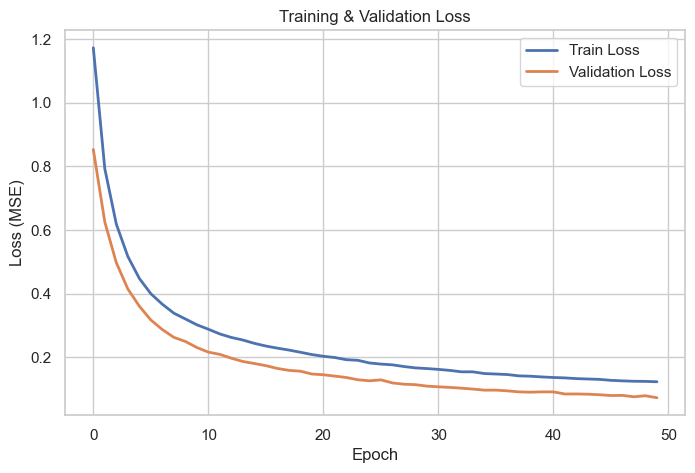

🔹 Best model saved at: ./Models_Train_Only_Normals_SegmentsDenoisingAE/DenoisingConvAutoencoder_trial_6.pth


In [671]:
# 1️⃣ Best trial info
best_trial_num = study.best_trial.number
best_val_loss = study.best_value
best_params = study.best_trial.params
print(f"✅ Best trial number: {best_trial_num}")
print(f"✅ Best validation loss: {best_val_loss:.6f}")
print(f"✅ Best hyperparameters: {best_params}")

# 2️⃣ Map best trial number to history
completed_trials = [t.number for t in study.trials if t.state == optuna.trial.TrialState.COMPLETE]
best_history_index = completed_trials.index(best_trial_num)
best_history = histories[best_history_index]

# 3️⃣ Plot training/validation losses
plot_hist(best_history)

# 4️⃣ Path of the saved model
# Assuming your save_dir is the timestamped folder used in run_optuna_optimization
import os
model_filename = f"DenoisingConvAutoencoder_trial_{best_trial_num}.pth"
model_path = os.path.join(save_dir, model_filename)
print(f"🔹 Best model saved at: {model_path}")




In [672]:
best_trial = study.best_trial
print("Best trial parameters:", best_trial.params)

Best trial parameters: {'code_size': 224, 'dropout_rate': 0.1}


# Retrain the Model on the Full Training Dataset Using the Best Hyperparameters from Optuna

In [ ]:
best_params = study.best_trial.params # was also saved  before, just for safety reasons
# I make a new instance of the model, to retrain on the whole data set....
# Did not load the weights of the previous model since this will bias to the small data set. Training will start with randomly initialized weights, but with the best hyperparameters.
best_model = DenoisingConvAutoencoder(

    input_length=80,
    num_leads=12,
    code_size=best_trial.params['code_size'],
    dropout_rate=best_trial.params['dropout_rate']
).to(device)



In [675]:
print(f"Using device: {device}")

Using device: mps


In [676]:
from datetime import datetime

# Create a unique folder for this fine-tune run
timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")
final_save_dir = f'./Models_Train_Only_Normals_SegmentsDenoisingAE/fine_tuned_models_{timestamp}'
os.makedirs(save_dir, exist_ok=True)
print(f"🔹 Fine-tuned models will be saved in: {save_dir}")


fine_tuned_model, fine_tune_history, fine_tuned_path = train_simple_autoencoder(
    model=best_model,
    train_loader= train_loader,
    valid_loader= val_loader,
    learning_rate=0.00005,   # smaller 5e-5 LR for fine-tuning (get less stable)
    n_epochs= 300,         # longer training 
    patience=30,
    factor=0.5,
    trial_number='fine_tuned',
    save_dir= final_save_dir
)

🔹 Fine-tuned models will be saved in: ./Models_Train_Only_Normals_SegmentsDenoisingAE


Training DenoisingConvAutoencoder:  62%|██████▏   | 185/300 [1:29:43<55:46, 29.10s/it, train_loss=0.04218, val_loss=0.01946]    

✅ Training complete. Best model saved at: ./Models_Train_Only_Normals_SegmentsDenoisingAE/fine_tuned_models_20251111_155805/DenoisingConvAutoencoder_trial_fine_tuned.pth


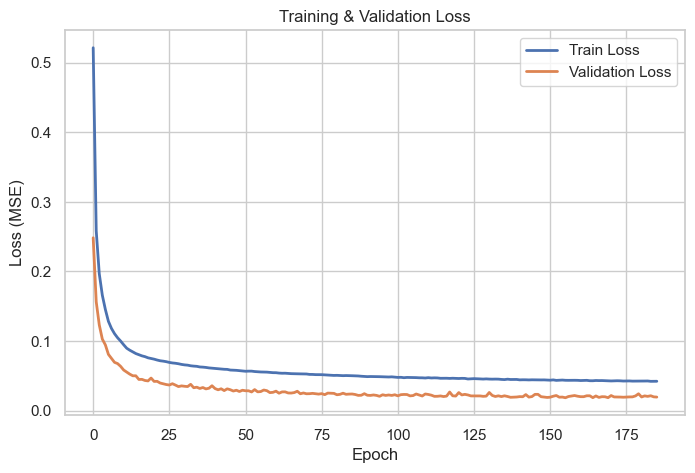

In [677]:
plot_hist(fine_tune_history)

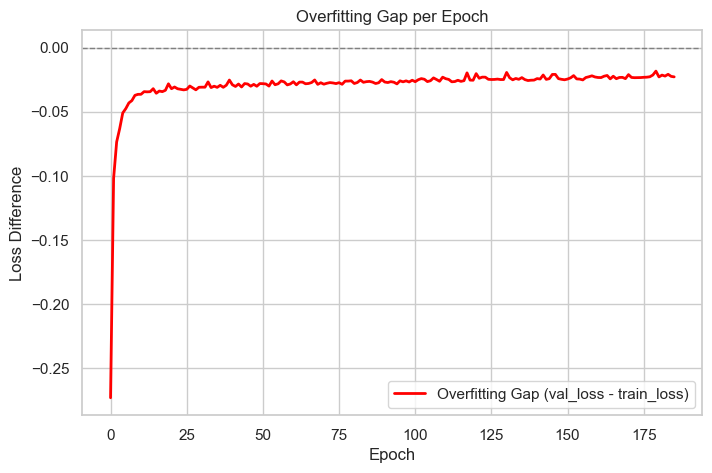

In [679]:
import matplotlib.pyplot as plt
import numpy as np

train_loss = np.array(fine_tune_history['train_loss'])
val_loss = np.array(fine_tune_history['val_loss'])
epochs = np.arange(len(train_loss))

# Calculate overfitting gap per epoch
overfit_gap = val_loss - train_loss

plt.figure(figsize=(8,5))
plt.plot(epochs, overfit_gap, label='Overfitting Gap (val_loss - train_loss)', color='red', linewidth=2)
plt.axhline(0, color='gray', linestyle='--', linewidth=1)
plt.xlabel('Epoch')
plt.ylabel('Loss Difference')
plt.title('Overfitting Gap per Epoch')
plt.legend()
plt.grid(True)
plt.show()


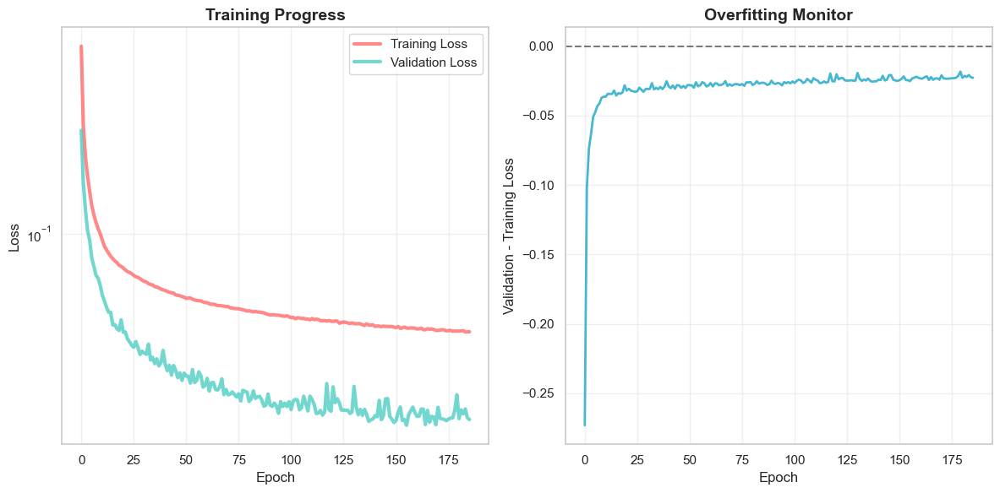

In [680]:
plot_hist2(fine_tune_history)

In [682]:
# save the fine-tuned model, weight, history,hyperparameters  (code size, dropout, etc) for later use
import pickle
model_save_path = os.path.join(final_save_dir, 'fine_tuned_denoising_autoencoder.pth')
torch.save({
    'model_state_dict': fine_tuned_model.state_dict(),
    'history': fine_tune_history,
    'hyperparameters': best_params,
}, model_save_path)
print(f"✅ Fine-tuned model and training details saved at: {model_save_path}")

✅ Fine-tuned model and training details saved at: ./Models_Train_Only_Normals_SegmentsDenoisingAE/fine_tuned_models_20251111_155805/fine_tuned_denoising_autoencoder.pth


In [683]:
import os
import json
import inspect
import torch
import joblib
import numpy as np
from datetime import datetime

def save_full_run(out_dir, model, history, hyperparameters,
                  mean=None, std=None,
                  train_ids=None, val_ids=None, test_ids=None,
                  label_encoder=None,
                  optimizer=None, last_epoch=None):
    os.makedirs(out_dir, exist_ok=True)
    timestamp = datetime.utcnow().strftime("%Y%m%d_%H%M%S")
    ckpt_path = os.path.join(out_dir, f"checkpoint_{timestamp}.pth")

    # Basic checkpoint dict
    ckpt = {
        'model_state_dict': model.state_dict(),
        'history': history,
        'hyperparameters': hyperparameters,
        'saved_at': datetime.utcnow().isoformat() + 'Z',
    }

    # optionally include optimizer/epoch for resuming
    if optimizer is not None:
        ckpt['optimizer_state_dict'] = optimizer.state_dict()
    if last_epoch is not None:
        ckpt['last_epoch'] = int(last_epoch)

    # Add explicit constructor args for easy re-instantiation
    # prefer explicit keys if present in hyperparameters, otherwise fall back to guesses
    cfg = {
        'input_length': int(hyperparameters.get('input_length', 80)),
        'num_leads': int(hyperparameters.get('num_leads', 12)),
        'code_size': int(hyperparameters.get('code_size', hyperparameters.get('latent_dim', hyperparameters.get('bottleneck_dim', 128)))),
        'dropout_rate': float(hyperparameters.get('dropout_rate', hyperparameters.get('dropout', 0.1)))
    }
    ckpt['constructor_cfg'] = cfg

    # parameter counts
    n_params = sum(p.numel() for p in model.parameters())
    n_trainable = sum(p.numel() for p in model.parameters() if p.requires_grad)
    ckpt['n_params'] = int(n_params)
    ckpt['n_trainable_params'] = int(n_trainable)

    # collect dropout layer info
    dropout_info = []
    for name, module in model.named_modules():
        mtype = type(module).__name__
        if 'Dropout' in mtype:
            p = getattr(module, 'p', None)
            dropout_info.append({'name': name, 'type': mtype, 'p': float(p) if p is not None else None})
    ckpt['dropout_info'] = dropout_info

    # Save checkpoint file (weights + metadata)
    torch.save(ckpt, ckpt_path)

    # Save model class source (if possible)
    src_path = None
    try:
        model_src = inspect.getsource(type(model))
        src_path = os.path.join(out_dir, "model_class.py")
        with open(src_path, "w") as f:
            f.write("# Saved model class source\n")
            f.write(model_src)
    except Exception as e:
        # If model class defined interactively, this may fail in some envs; keep going
        print("Could not automatically save model source:", e)
        src_path = None

    # Save normalization stats
    if mean is not None and std is not None:
        np.save(os.path.join(out_dir, "norm_mean.npy"), np.asarray(mean, dtype=np.float32))
        np.save(os.path.join(out_dir, "norm_std.npy"), np.asarray(std, dtype=np.float32))

    # Save split id lists if provided
    if train_ids is not None:
        np.save(os.path.join(out_dir, "train_ecg_ids.npy"), np.asarray(train_ids))
    if val_ids is not None:
        np.save(os.path.join(out_dir, "val_ecg_ids.npy"), np.asarray(val_ids))
    if test_ids is not None:
        np.save(os.path.join(out_dir, "test_ecg_ids.npy"), np.asarray(test_ids))

    # Save label encoder if provided
    if label_encoder is not None:
        joblib.dump(label_encoder, os.path.join(out_dir, "label_encoder.joblib"))

    # Save a manifest with sizes & metadata
    def hr(n):
        for unit in ['B','KB','MB','GB']:
            if n < 1024.0: return f"{n:.2f}{unit}"
            n /= 1024.0
        return f"{n:.2f}TB"

    manifest = {
        'checkpoint_path': ckpt_path,
        'checkpoint_bytes': os.path.getsize(ckpt_path),
        'checkpoint_hr': hr(os.path.getsize(ckpt_path)),
        'n_params': n_params,
        'n_trainable_params': n_trainable,
        'dropout_info': dropout_info,
        'constructor_cfg': cfg,
        'model_source_path': src_path,
        'saved_at': ckpt['saved_at']
    }
    manifest_path = os.path.join(out_dir, "manifest.json")
    with open(manifest_path, "w") as f:
        json.dump(manifest, f, indent=2)

    print("Saved checkpoint:", ckpt_path)
    if src_path:
        print("Saved model class source:", src_path)
    print("Saved manifest:", manifest_path)
    return ckpt_path, manifest_path

In [ ]:
# call the funtion to saved the entire check point

out_dir = final_save_dir  # or whatever folder you created earlier

# Ensure hyperparameters include the constructor args we expect
hp = dict(best_params) if 'best_params' in globals() else {}
hp.update({'input_length': 80, 'num_leads': 12})  # be explicit if needed

ckpt_path, manifest_path = save_full_run(
    out_dir=out_dir,
    model=fine_tuned_model,
    history=fine_tune_history,
    hyperparameters=hp,
    mean=m,                   # numpy array or torch tensor of per-lead means
    std=s,                    # numpy array or torch tensor of per-lead stds
    train_ids=globals().get('train_ids', None),
    val_ids=globals().get('val_ids', None),
    test_ids=globals().get('test_ids', None),
    label_encoder=globals().get('label_encoder', None),
    optimizer=globals().get('optimizer', None),
    last_epoch=globals().get('epoch', None)
)
print("checkpoint saved to:", ckpt_path)
print("manifest saved to:", manifest_path)

Could not automatically save model source: source code not available
Saved checkpoint: ./Models_Train_Only_Normals_SegmentsDenoisingAE/fine_tuned_models_20251111_155805/checkpoint_20251111_170453.pth
Saved manifest: ./Models_Train_Only_Normals_SegmentsDenoisingAE/fine_tuned_models_20251111_155805/manifest.json
checkpoint saved to: ./Models_Train_Only_Normals_SegmentsDenoisingAE/fine_tuned_models_20251111_155805/checkpoint_20251111_170453.pth
manifest saved to: ./Models_Train_Only_Normals_SegmentsDenoisingAE/fine_tuned_models_20251111_155805/manifest.json


What files are written: 
-checkpoint_{timestamp}.pth — contains state_dict + metadata (history, hyperparameters, constructor_cfg, dropout_info, etc.)
- model_class.py (if inspect.getsource succeeded) — source code of the class
- norm_mean.npy / norm_std.npy (if mean/std provided)
- train_ecg_ids.npy, val_ecg_ids.npy, test_ecg_ids.npy (if provided)
-label_encoder.joblib (if provided)
-manifest.json — small JSON describing checkpoint path, sizes, constructor cfg, dropout info

# Model Evaluation

## Switch the last Trained tuned model to evaluation (eval ()) mode or load hyperparameters & weights of the best saveed tunned model and switch model to eval()

### last run into evaluation mode:

In [685]:
# last run into evaliuation mode:
model = fine_tuned_model
model.eval()

DenoisingConvAutoencoder(
  (encoder): Sequential(
    (0): Conv1d(12, 32, kernel_size=(7,), stride=(2,), padding=(3,))
    (1): ReLU()
    (2): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): Dropout(p=0.1, inplace=False)
    (4): Conv1d(32, 64, kernel_size=(5,), stride=(2,), padding=(2,))
    (5): ReLU()
    (6): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): Conv1d(64, 128, kernel_size=(3,), stride=(2,), padding=(1,))
    (8): ReLU()
    (9): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): Conv1d(128, 224, kernel_size=(3,), stride=(2,), padding=(1,))
    (11): ReLU()
    (12): BatchNorm1d(224, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (decoder): Sequential(
    (0): ConvTranspose1d(224, 128, kernel_size=(3,), stride=(2,), padding=(1,), output_padding=(1,))
    (1): ReLU()
    (2): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=Tr

### Or load a saved model if you want to evaluate another version:
- First: 
Either re-run the notebook cell that defines DenoisingConvAutoencoder, or import the saved model_class.py file.
Then:

In [ ]:
# load a good model from  the rurns: 
import torch, json
from pathlib import Path
# Load the fine-tuned model for inference or further use
# if the model was just run on this device:
# out_dir = final_save_dir  # this opens the last fine tuned model run.

# load a check point of a good model:
#out_dir = './Models_Train_Only_Normals_SegmentsDenoisingAE/fine_tuned_models_20251108_025633/'  # example path
#manifest = json.load(open(Path(out_dir) / "manifest.json"))
#ckpt = torch.load(manifest['checkpoint_path'], map_location='cpu')

ckpt_path = Path(out_dir) / "checkpoint_20251109_102212.pth"
ckpt = torch.load(ckpt_path, map_location='cpu')

cfg = ckpt.get('constructor_cfg', {})
model = DenoisingConvAutoencoder(
    input_length = int(cfg.get('input_length', 80)),
    num_leads     = int(cfg.get('num_leads', 12)),
    code_size     = int(cfg.get('code_size', 128)),
    dropout_rate  = float(cfg.get('dropout_rate', 0.1))
)
model.load_state_dict(ckpt['model_state_dict'])
model.eval()
# move to device if desired
device = torch.device("mps") if torch.backends.mps.is_available() else (torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu"))
model.to(device)

# load norm stats if needed
import numpy as np
mean = np.load(Path(out_dir) / "norm_mean.npy") if (Path(out_dir) / "norm_mean.npy").exists() else None
std  = np.load(Path(out_dir) / "norm_std.npy")  if (Path(out_dir) / "norm_std.npy").exists() else None

### Encode the labels for analysis

In [686]:
# Encode the labels of the test set:
# If each entry is a list with one element
Y_test_single = Y_test_seg_df['diagnostic_superclass'].apply(lambda x: x[0] if isinstance(x, list) else x) # becasuse we have list inside

from sklearn.preprocessing import LabelEncoder

label_encoder = LabelEncoder()
y_test_encoded = label_encoder.fit_transform(Y_test_single.values)
y_test_encoded

array([3, 3, 3, ..., 4, 4, 4], shape=(99875,))

In [687]:
print(f'MI code: {list(label_encoder.classes_).index("MI")}')
print(f'NORM code: {list(label_encoder.classes_).index("NORM")}')
print(f'STTC code: {list(label_encoder.classes_).index("STTC")}')
print(f'HYP code: {list(label_encoder.classes_).index("HYP")}')
print(f'CD code: {list(label_encoder.classes_).index("CD")}')
# Evaluate on test set

MI code: 2
NORM code: 3
STTC code: 4
HYP code: 1
CD code: 0


In [688]:
Y_train_single = Y_train_seg_df['diagnostic_superclass'].apply(lambda x: x[0] if isinstance(x, list) else x)
Y_val_single   = Y_val_seg_df['diagnostic_superclass'].apply(lambda x: x[0] if isinstance(x, list) else x)

y_train_encoded = label_encoder.fit_transform(Y_train_single.values)
y_val_encoded   = label_encoder.transform(Y_val_single.values)
y_val_encoded

array([0, 0, 0, ..., 0, 0, 0], shape=(11895,))

# Visualize Latent Representations Across Train, Validation, and Test Sets

In [ ]:
import torch
import numpy as np
# extract the latent representations from the model for a given set of segments using the encoder part of the autoencoder

def extract_latents_from_array(model, X_seg, device="cuda"):
    model.eval()
    
    X_tensor = torch.tensor(X_seg, dtype=torch.float32).to(device)   # (N, 80, 12)

    with torch.no_grad():
        z = model.encoder(X_tensor.permute(0, 2, 1))  # (N, latent_dim, L_latent)  # change to (N, 12, 80) to pass through the Conv1d encoder
        latent_vectors = z.mean(dim=2).cpu().numpy()  # (N, latent_dim) #computes the mean across the temporal dimension of the latent map, yielding a single vector per segment:
# Shape becomes (N, latent_dim)


    return latent_vectors

In [883]:
latent_train = extract_latents_from_array(model, X_train_seg, device)
latent_test  = extract_latents_from_array(model, X_test_seg, device)
latent_val   = extract_latents_from_array(model, X_val_seg, device)

In [884]:
# Reduce dimensionality with UMAP
import umap

reducer = umap.UMAP(n_neighbors=15, min_dist=0.1, random_state=42)
latent_train_2d = reducer.fit_transform(latent_train )
latent_test_2d = reducer.transform(latent_test)
latent_val_2d  = reducer.transform(latent_val)


/Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Notebooks/env_Module3_P10.3/lib/python3.10/site-packages/umap/umap_.py:1952: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



In [888]:
Y_val_latent = Y_val_seg_df['diagnostic_superclass'].apply(lambda x: x[0] if isinstance(x, list) else x)
Y_train_latent = Y_train_seg_df['diagnostic_superclass'].apply(lambda x: x[0] if isinstance(x, list) else x)
Y_test_latent = Y_test_seg_df['diagnostic_superclass'].apply(lambda x: x[0] if isinstance(x, list) else x)

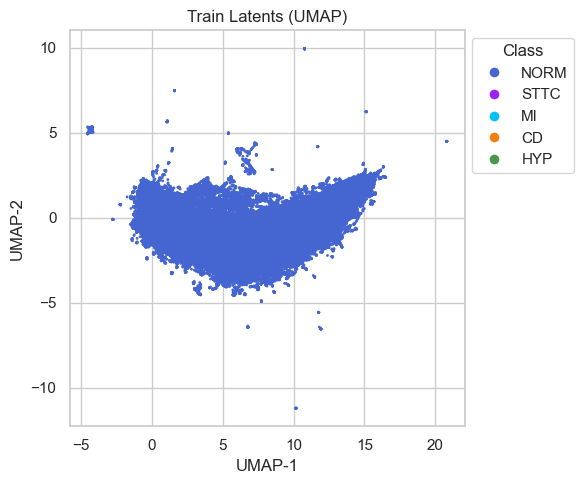

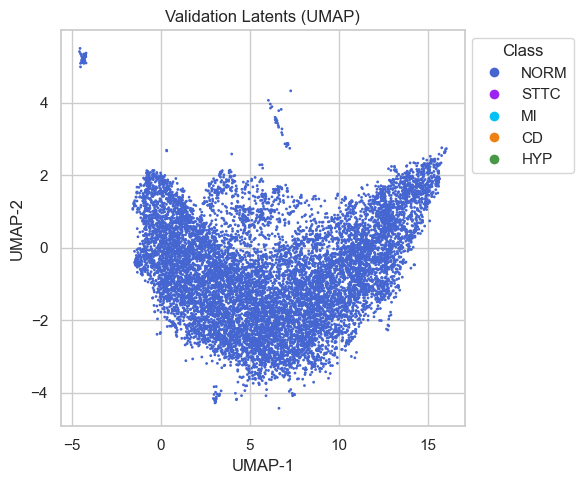

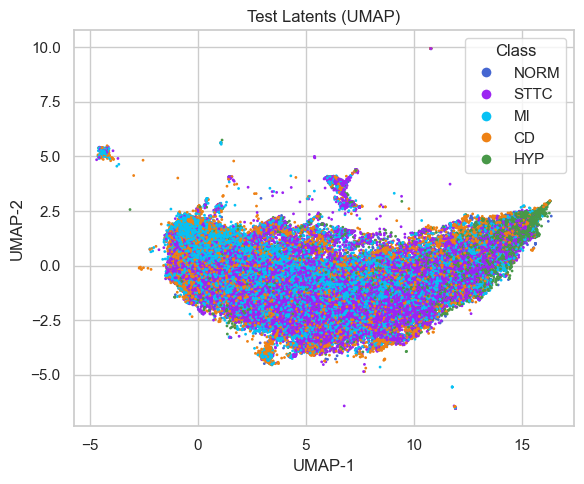

In [891]:
import matplotlib.pyplot as plt
import numpy as np

class_names = ['NORM', 'STTC', 'MI', 'CD', 'HYP']
class_colors = {
    'NORM': "#4566D1",
    'HYP': "#489848",
    'MI': "#07C1F4",
    'CD': "#EE8114",
    'STTC': "#9C24F2",
}

def plot_latents(latents_2d, labels, class_colors, set_name):
    # Map each label to its color
    colors = [class_colors[lbl] for lbl in labels]
    
    plt.figure(figsize=(6,5))
    scatter = plt.scatter(latents_2d[:,0], latents_2d[:,1], c=colors, s=1)
    plt.xlabel("UMAP-1")
    plt.ylabel("UMAP-2")
    plt.title(f"{set_name} Latents (UMAP)")

    # Custom legend
    handles = [plt.Line2D([0], [0], marker="o", color="w", label=class_name,
                          markerfacecolor=class_colors[class_name], markersize=8)
               for class_name in class_names]
    plt.legend(handles=handles, title="Class", bbox_to_anchor=(1,1))
    plt.tight_layout()
    plt.show()

# Plot each set separately
plot_latents(latent_train_2d, Y_train_latent, class_colors, "Train")
plot_latents(latent_val_2d,   Y_val_latent,  class_colors, "Validation")
plot_latents(latent_test_2d,  Y_test_latent, class_colors, "Test")


/Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Notebooks/env_Module3_P10.3/lib/python3.10/site-packages/umap/umap_.py:1952: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.

/Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Notebooks/env_Module3_P10.3/lib/python3.10/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning:

divide by zero encountered in matmul

/Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Notebooks/env_Module3_P10.3/lib/python3.10/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning:

overflow encountered in matmul

/Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Notebooks/env_Module3_P10.3/lib/python3.10/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning:

invalid value encountered in matmul

/Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Notebooks/env_Module3_P10.3/lib/python3

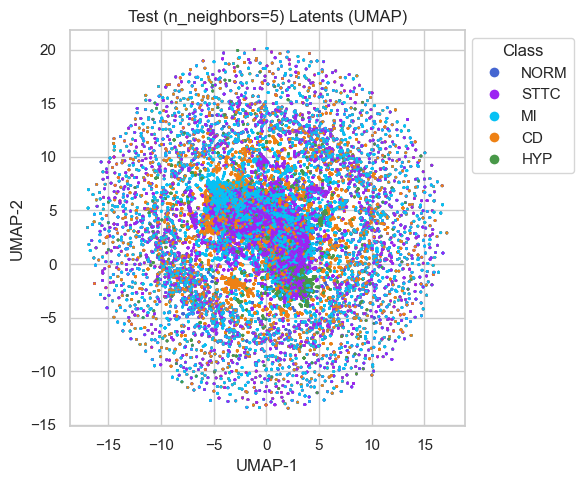

/Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Notebooks/env_Module3_P10.3/lib/python3.10/site-packages/umap/umap_.py:1952: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



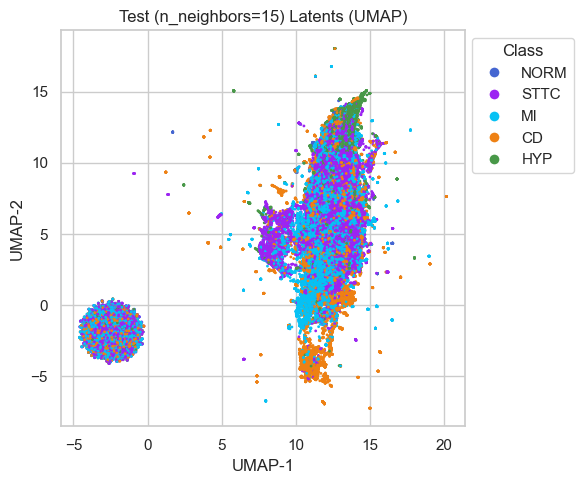

/Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Notebooks/env_Module3_P10.3/lib/python3.10/site-packages/umap/umap_.py:1952: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



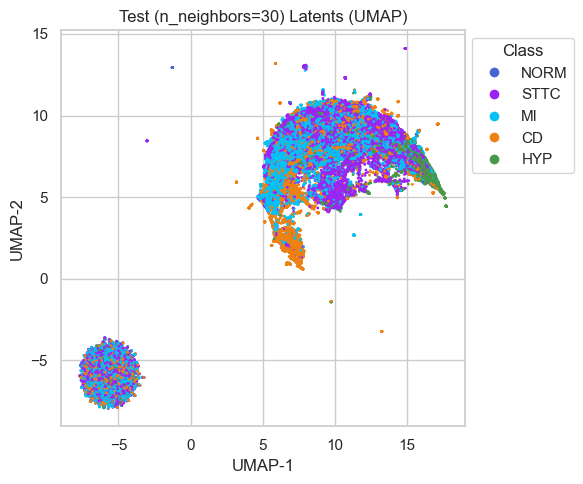

/Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Notebooks/env_Module3_P10.3/lib/python3.10/site-packages/umap/umap_.py:1952: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



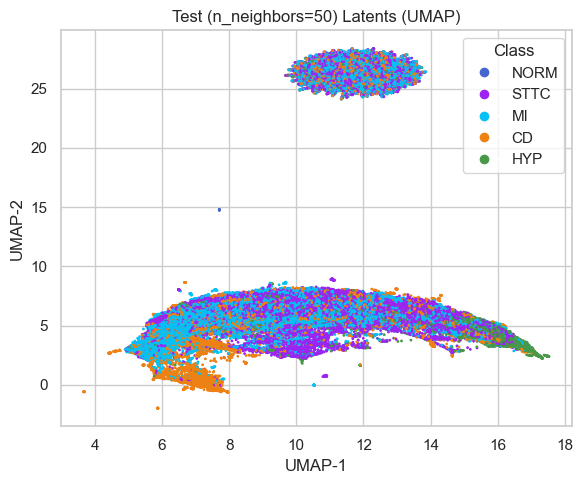

In [892]:
for nn in [5, 15, 30, 50]:
    reducer = umap.UMAP(n_neighbors=nn, min_dist=0.1, random_state=42)
    latent_2d = reducer.fit_transform(latent_test)
    plot_latents(latent_2d, Y_test_latent, class_colors, f"Test (n_neighbors={nn})")

In [900]:
import umap

reducer_3d = umap.UMAP(n_neighbors=50, min_dist=0.1, n_components=3, random_state=42)
latent_3d_train = reducer_3d.fit_transform(latent_train)
latent_3d_val   = reducer_3d.transform(latent_val)
latent_3d_test  = reducer_3d.transform(latent_test)


/Users/paulavazquez/CAS_Advanced_Machine_Learning/Module_3/Final Project/Notebooks/env_Module3_P10.3/lib/python3.10/site-packages/umap/umap_.py:1952: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



In [898]:
import plotly.graph_objects as go

def plot_latents_3d_plotly_multiclass(latents_3d, labels, class_names, class_colors, set_name):
    fig = go.Figure()
    for class_name in class_names:
        idx = [i for i, lbl in enumerate(labels) if lbl == class_name]
        if idx:  # Only plot if there are samples for that class
            fig.add_trace(go.Scatter3d(
                x=latents_3d[idx, 0],
                y=latents_3d[idx, 1],
                z=latents_3d[idx, 2],
                mode='markers',
                marker=dict(size=1, color=class_colors[class_name]),
                name=class_name,
                text=[class_name]*len(idx),
            ))
    fig.update_layout(
        title=f"{set_name} Latents (UMAP 3D Interactive)",
        scene=dict(
            xaxis_title='UMAP-1',
            yaxis_title='UMAP-2',
            zaxis_title='UMAP-3'),
        margin=dict(l=0, r=0, b=0, t=40),
        width=700, height=600
    )
    fig.show()



In [903]:
# Call
plot_latents_3d_plotly_multiclass(latent_3d_train, Y_train_latent, class_names, class_colors, "Train")

plot_latents_3d_plotly_multiclass(latent_3d_val,   Y_val_latent,   class_names, class_colors, "Validation")

plot_latents_3d_plotly_multiclass(latent_3d_test,  Y_test_latent,  class_names, class_colors, "Test")

# Visualize the Reconstructed Segments on few validation Set Segments (all normals)

=== Segment ID: 7 | Label: 0 | Noise: clean ===


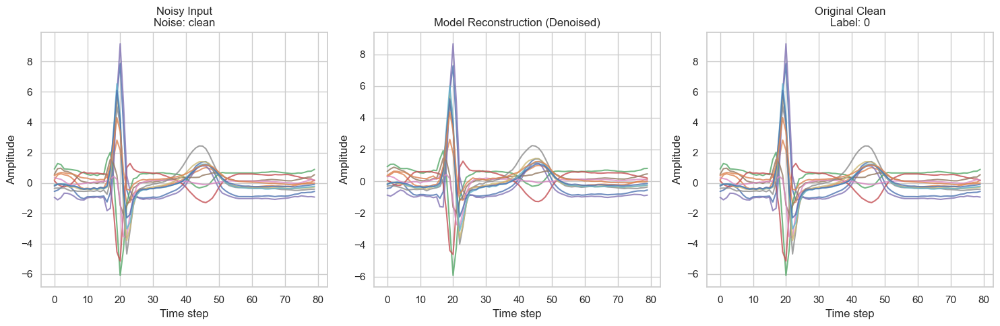

=== Segment ID: 14 | Label: 0 | Noise: clean ===


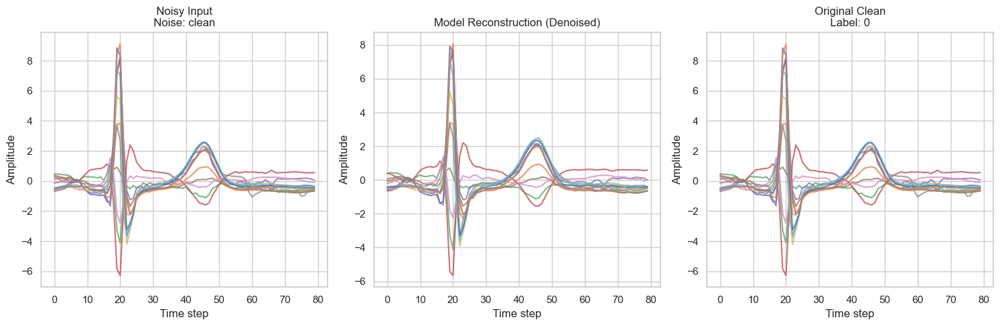

=== Segment ID: 44 | Label: 0 | Noise: clean ===


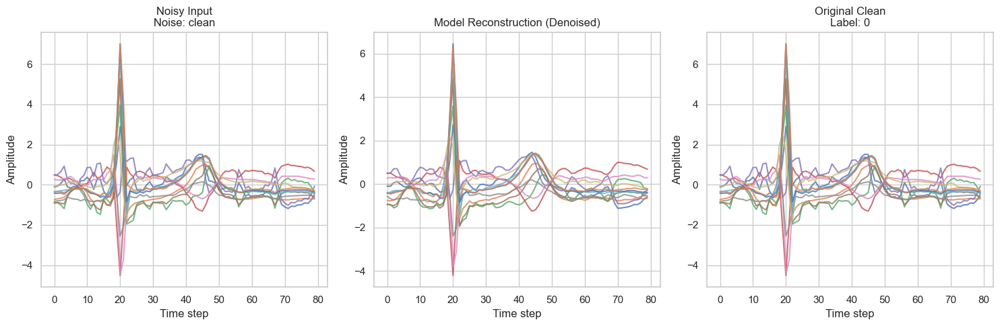

=== Segment ID: 0 | Label: 0 | Noise: gaussian ===


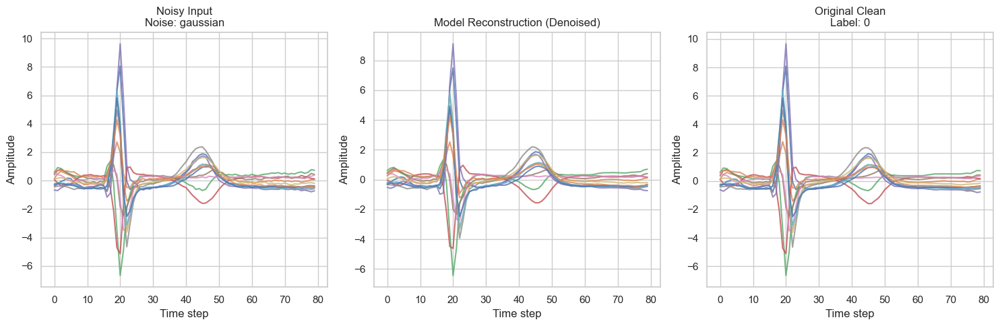

=== Segment ID: 3 | Label: 0 | Noise: clean ===


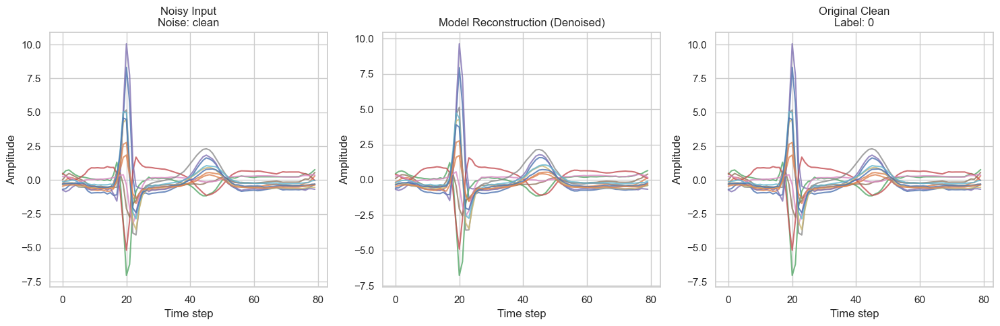

In [700]:
import matplotlib.pyplot as plt
import numpy as np
import torch

model.eval()

# --- Pick a few random samples from the validation set ---
n_examples = 5
examples = []

# Collect one full batch and pick some examples
with torch.no_grad():
    for noisy_batch, clean_batch, labels_batch, seg_ids_batch, noise_types_batch in val_loader:
        noisy_batch = noisy_batch.to(device)
        output_batch = model(noisy_batch)
        
        examples.append((
            noisy_batch.cpu(),
            clean_batch.cpu(),
            output_batch.cpu(),
            labels_batch,
            seg_ids_batch,
            noise_types_batch
        ))
        break  # only need one batch for visualization

noisy_batch, clean_batch, recon_batch, labels_batch, seg_ids_batch, noise_types_batch = examples[0]

# Pick n_examples random indices from this batch
indices = np.random.choice(len(noisy_batch), size=n_examples, replace=False)

def plot_val_sample(idx):
    plt.figure(figsize=(15, 5))
    
    # --- Noisy Input ---
    plt.subplot(1, 3, 1)
    for lead in range(noisy_batch.shape[2]):
        plt.plot(noisy_batch[idx, :, lead], label=f'Lead {lead}', alpha=0.8)
    plt.title(f"Noisy Input\nNoise: {noise_types_batch[idx]}")
    plt.xlabel("Time step")
    plt.ylabel("Amplitude")

    # --- Model Reconstruction ---
    plt.subplot(1, 3, 2)
    for lead in range(recon_batch.shape[2]):
        plt.plot(recon_batch[idx, :, lead], label=f'Lead {lead}', alpha=0.8)
    plt.title("Model Reconstruction (Denoised)")
    plt.xlabel("Time step")
    plt.ylabel("Amplitude")

    # --- Original Clean Signal ---
    plt.subplot(1, 3, 3)
    for lead in range(clean_batch.shape[2]):
        plt.plot(clean_batch[idx, :, lead], label=f'Lead {lead}', alpha=0.8)
    plt.title(f"Original Clean\nLabel: {labels_batch[idx]}")
    plt.xlabel("Time step")
    plt.ylabel("Amplitude")

    plt.tight_layout()
    plt.show()

# --- Plot several examples ---
for idx in indices:
    print(f"=== Segment ID: {seg_ids_batch[idx]} | Label: {labels_batch[idx]} | Noise: {noise_types_batch[idx]} ===")
    plot_val_sample(idx)


Noise type distribution:
baseline: 555
clean: 9620
gaussian: 555
powerline: 555
randomburst: 555


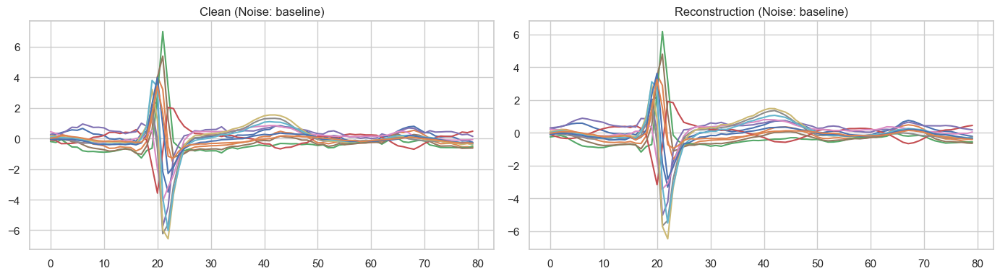

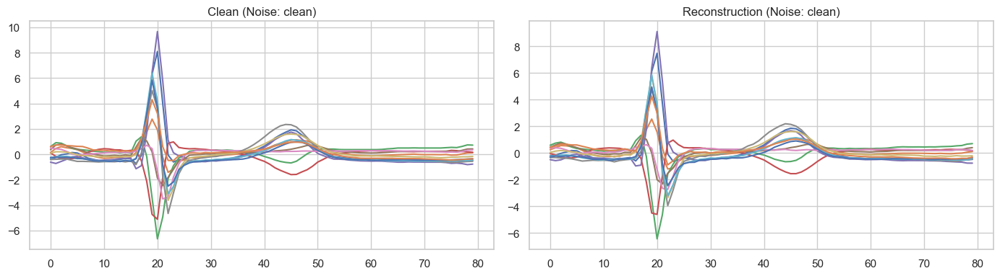

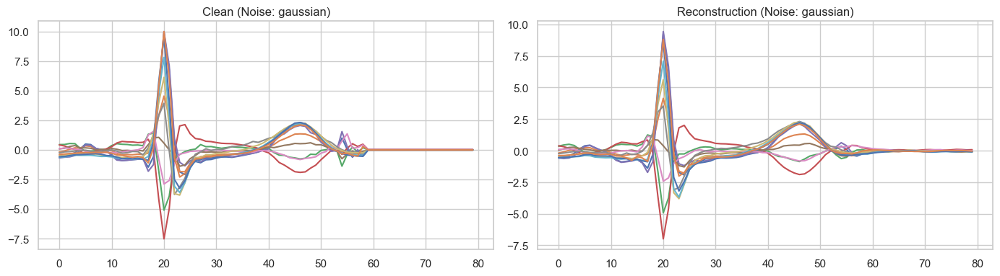

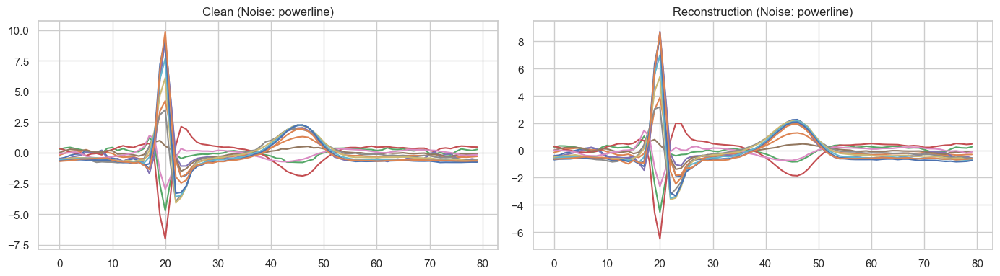

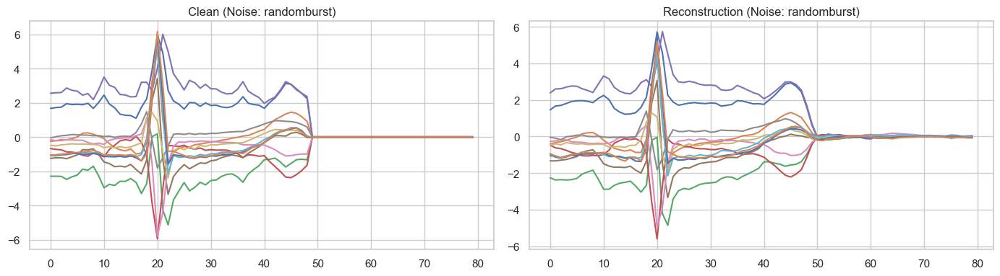

In [701]:
# Find samples with different noise types
import numpy as np
import matplotlib.pyplot as plt
import torch

# Gather all reconstructed and original samples again
# model.eval()
all_clean, all_recon, all_noise = [], [], []

with torch.no_grad():
    for noisy_batch, clean_batch, _, _, noise_types_batch in val_loader:
        noisy_batch = noisy_batch.to(device)
        output_batch = model(noisy_batch)

        all_clean.append(clean_batch.cpu())
        all_recon.append(output_batch.cpu())
        all_noise.extend(noise_types_batch)

all_clean = torch.cat(all_clean, dim=0).numpy()
all_recon = torch.cat(all_recon, dim=0).numpy()
all_noise = np.array(all_noise)

# Count noise types
unique, counts = np.unique(all_noise, return_counts=True)
print("Noise type distribution:")
for u, c in zip(unique, counts):
    print(f"{u}: {c}")

# Plot examples for each noise type
def plot_example(noise_type):
    indices = np.where(all_noise == noise_type)[0]
    if len(indices) == 0:
        print(f"No samples with noise type '{noise_type}' found.")
        return

    idx = indices[0]
    plt.figure(figsize=(14,4))

    plt.subplot(1,2,1)
    for lead in range(all_clean.shape[2]):
        plt.plot(all_clean[idx,:,lead])
    plt.title(f"Clean (Noise: {noise_type})")

    plt.subplot(1,2,2)
    for lead in range(all_recon.shape[2]):
        plt.plot(all_recon[idx,:,lead])
    plt.title(f"Reconstruction (Noise: {noise_type})")

    plt.tight_layout()
    plt.show()

# Try plotting one example per unique noise type
for noise_type in unique:
    plot_example(noise_type)


Noise type distribution:
  baseline: 555
  clean: 9620
  gaussian: 555
  powerline: 555
  randomburst: 555


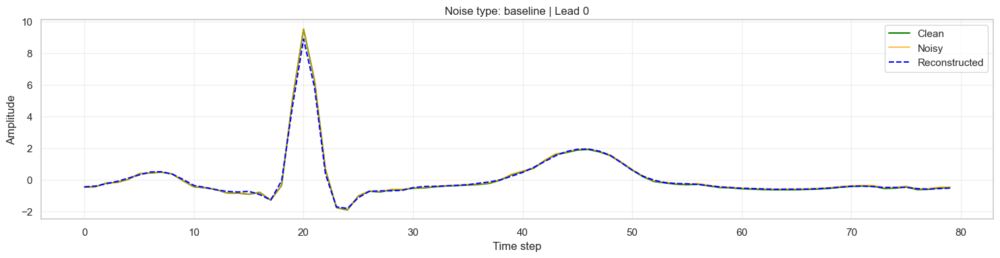

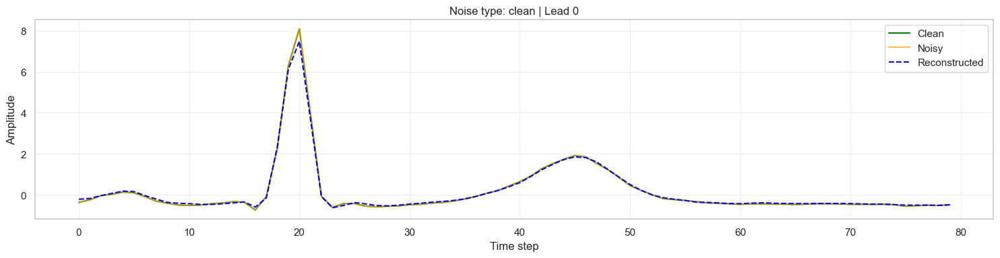

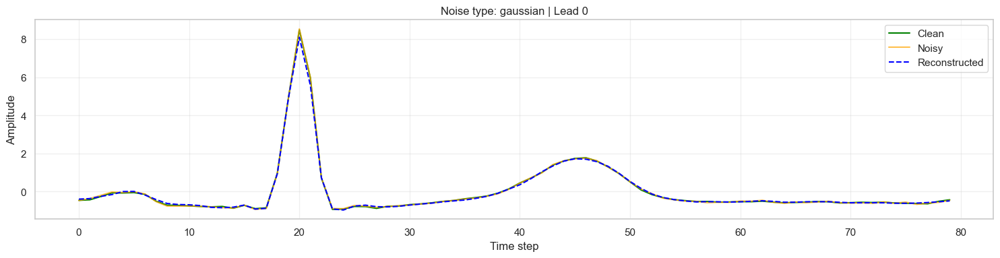

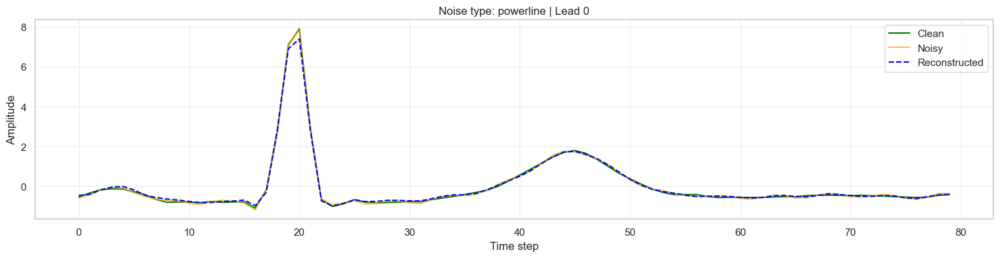

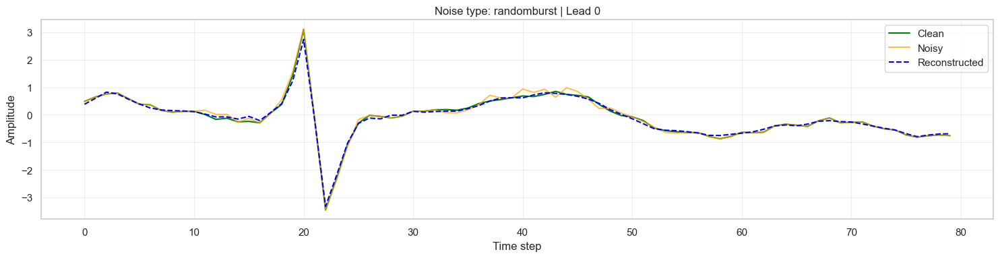

In [702]:
import numpy as np
import matplotlib.pyplot as plt
import torch

# model.eval()

all_clean, all_noisy, all_recon, all_noise = [], [], [], []

with torch.no_grad():
    for noisy_batch, clean_batch, _, _, noise_types_batch in val_loader:
        noisy_batch = noisy_batch.to(device)
        output_batch = model(noisy_batch)

        all_noisy.append(noisy_batch.cpu())
        all_clean.append(clean_batch.cpu())
        all_recon.append(output_batch.cpu())
        all_noise.extend(noise_types_batch)

all_noisy = torch.cat(all_noisy, dim=0).numpy()
all_clean = torch.cat(all_clean, dim=0).numpy()
all_recon = torch.cat(all_recon, dim=0).numpy()
all_noise = np.array(all_noise)

# --- Summary of noise types ---
unique, counts = np.unique(all_noise, return_counts=True)
print("Noise type distribution:")
for u, c in zip(unique, counts):
    print(f"  {u}: {c}")

# --- Function to plot all three versions ---
def plot_example(noise_type, lead=0):
    """Plot clean, noisy, and reconstructed for a given noise type and ECG lead."""
    indices = np.where(all_noise == noise_type)[0]
    if len(indices) == 0:
        print(f"No samples with noise type '{noise_type}' found.")
        return

    idx = indices[0]  # pick the first one

    plt.figure(figsize=(15, 4))

    plt.plot(all_clean[idx, :, lead], label='Clean', color='green', linewidth=1.5)
    plt.plot(all_noisy[idx, :, lead], label='Noisy', color='orange', alpha=0.7)
    plt.plot(all_recon[idx, :, lead], label='Reconstructed', color='blue', linestyle='--')

    plt.title(f"Noise type: {noise_type} | Lead {lead}")
    plt.xlabel("Time step")
    plt.ylabel("Amplitude")
    plt.legend()
    plt.grid(alpha=0.3)
    plt.tight_layout()
    plt.show()

# --- Plot one example for each noise type ---
for noise_type in unique:
    plot_example(noise_type, lead=0)  # change lead number if you want to see another channel


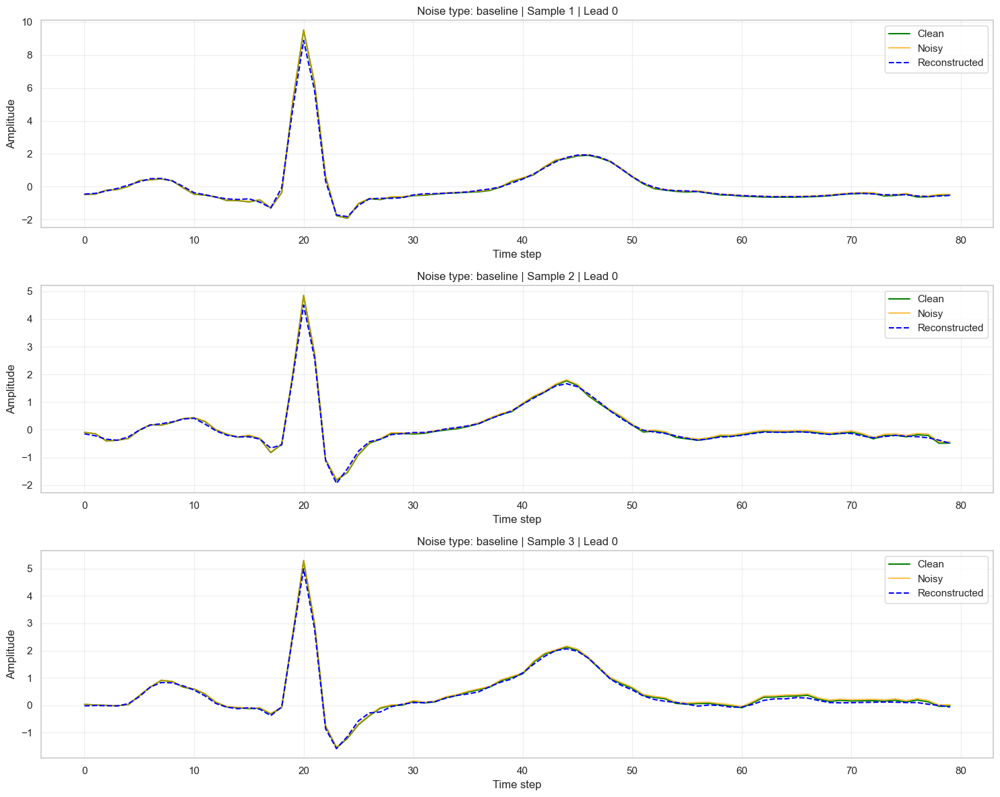

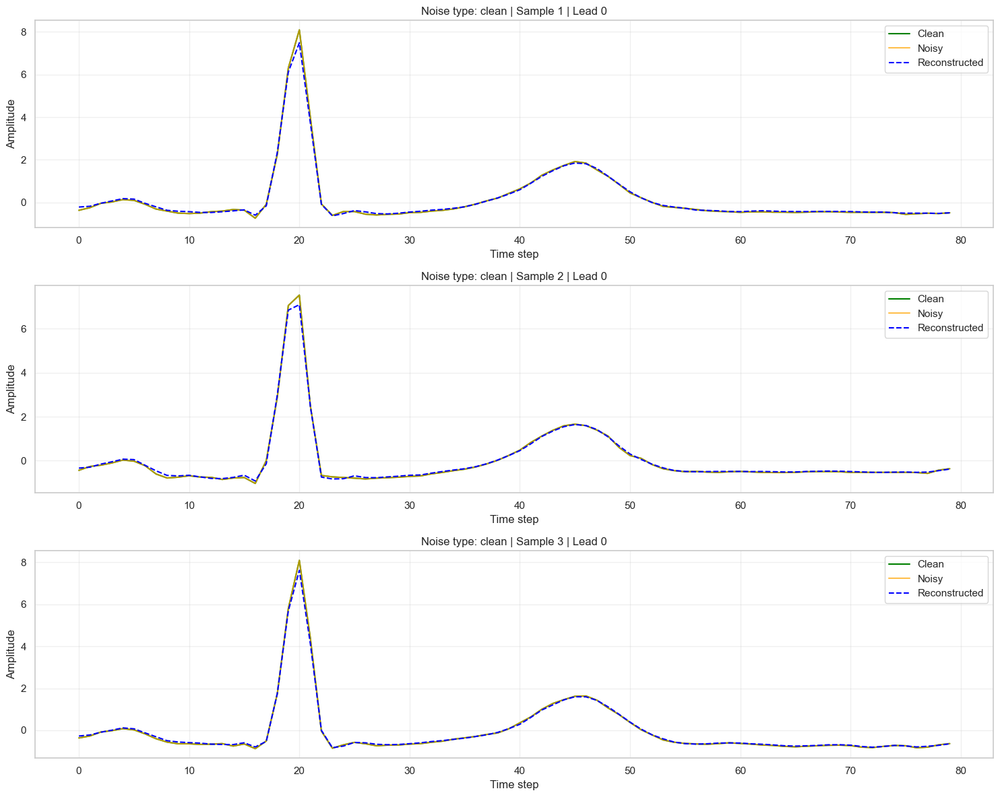

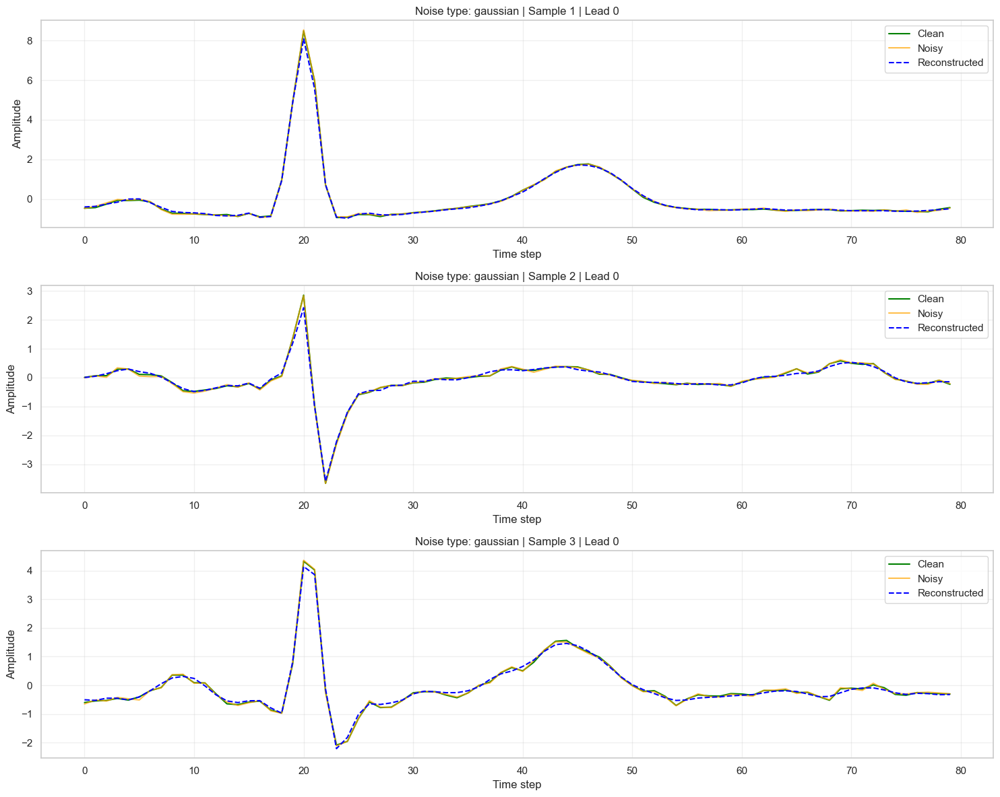

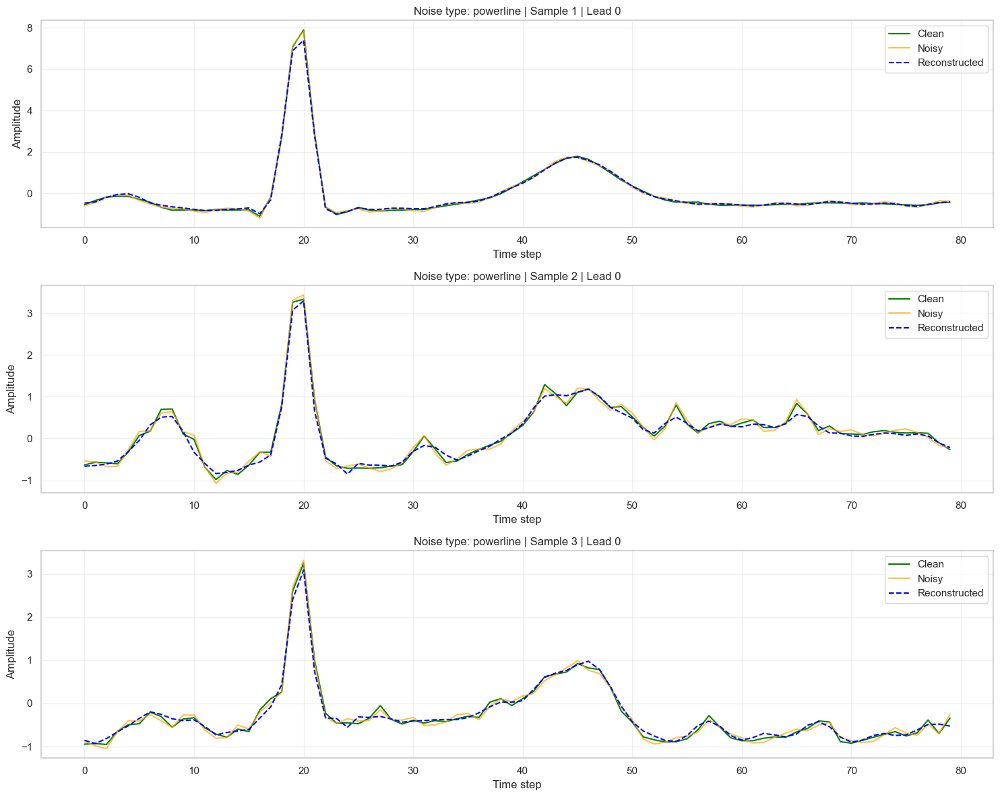

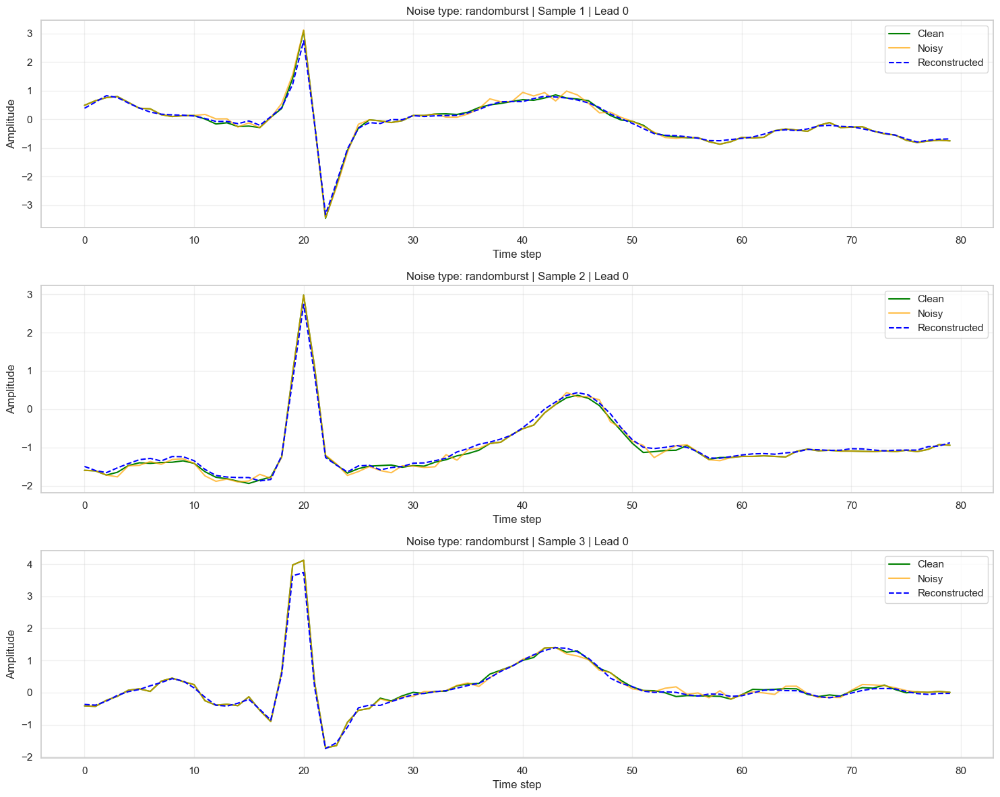

In [703]:
def plot_multiple_examples(noise_type, lead=0, n_examples=3):
    """Plot multiple examples of clean, noisy, and reconstructed signals for a given noise type."""
    indices = np.where(all_noise == noise_type)[0]
    if len(indices) == 0:
        print(f"No samples with noise type '{noise_type}' found.")
        return

    n = min(n_examples, len(indices))
    selected_indices = indices[:n]

    fig, axes = plt.subplots(n, 1, figsize=(15, 4*n))
    if n == 1:
        axes = [axes]

    for i, idx in enumerate(selected_indices):
        ax = axes[i]
        ax.plot(all_clean[idx, :, lead], label='Clean', color='green', linewidth=1.5)
        ax.plot(all_noisy[idx, :, lead], label='Noisy', color='orange', alpha=0.7)
        ax.plot(all_recon[idx, :, lead], label='Reconstructed', color='blue', linestyle='--')

        ax.set_title(f"Noise type: {noise_type} | Sample {i+1} | Lead {lead}")
        ax.set_xlabel("Time step")
        ax.set_ylabel("Amplitude")
        ax.grid(alpha=0.3)
        ax.legend(loc='upper right')

    plt.tight_layout()
    plt.show()

# Plot multiple examples per noise type
for noise_type in unique:
    plot_multiple_examples(noise_type, lead=0, n_examples=3)


# Using Reconstruction errors for anomaly detection

## Calculate recontruction error in Validation set

In [931]:
import numpy as np
import torch
import torch.nn as nn


# --- Ensure we're using the fine-tuned model --- or upload a saved model
# model = fine_tuned_model

model.eval()

criterion = nn.MSELoss(reduction='none')  # per-sample loss

reconstruction_errors = []
original_samples = []

with torch.no_grad():
    for noisy_data, clean_data, labels, seg_ids, applied_noise_types in val_loader:
        noisy_data = noisy_data.to(device)
        clean_data = clean_data.to(device)

        output = model(noisy_data)
        loss = criterion(output, clean_data)
        sample_losses = loss.sum(dim=(1, 2))

        reconstruction_errors.extend(sample_losses.cpu().numpy())
        original_samples.extend(clean_data.cpu().numpy())

reconstruction_errors = np.array(reconstruction_errors)
original_samples = np.array(original_samples)

print(f"✅ Computed reconstruction errors for {len(reconstruction_errors)} samples.")
print(f"Mean reconstruction error: {reconstruction_errors.mean():.6f}")
print(f"Std reconstruction error: {reconstruction_errors.std():.6f}")

# save reconstruction errors of validation set:
reconstruction_errors_val =  reconstruction_errors


✅ Computed reconstruction errors for 11840 samples.
Mean reconstruction error: 18.770678
Std reconstruction error: 172.167419


In [704]:
# Categorize samples by error percentile, get threshold from the recostruction errors in validation set

# Compute X percentile error threshold
percentile= 90 # you can change this value to set different thresholds
threshold = np.percentile(reconstruction_errors, percentile)
print(f"{percentile}th percentile reconstruction error threshold: {threshold:.6f}")


90th percentile reconstruction error threshold: 21.446747


## Calculate reconstruction error in Test set

In [705]:
import numpy as np
import torch
import torch.nn as nn

model.eval()
criterion = nn.MSELoss(reduction='none')

reconstruction_errors = []
true_labels = []
seg_ids_list = []
applied_noise_list = []

with torch.no_grad():
    for noisy_data, clean_data, labels, seg_ids, applied_noise_types in test_loader:
        noisy_data, clean_data = noisy_data.to(device), clean_data.to(device)
        output = model(noisy_data)

        # Compute per-sample MSE
        loss = criterion(output, clean_data)
        sample_losses = loss.sum(dim=(1, 2))

        reconstruction_errors.extend(sample_losses.cpu().numpy())
        true_labels.extend([l[0] if isinstance(l, list) else l for l in labels])
        seg_ids_list.extend(seg_ids)
        applied_noise_list.extend(applied_noise_types)

reconstruction_errors = np.array(reconstruction_errors)
true_labels = np.array(true_labels)
seg_ids_list = np.array(seg_ids_list)
applied_noise_list = np.array(applied_noise_list)

print(f"✅ Computed reconstruction errors for {len(reconstruction_errors)} test samples.")
# saved with another name for later:

reconstruction_errors_test = reconstruction_errors

✅ Computed reconstruction errors for 99875 test samples.



Validation Set Statistics:
  Median: 10.0017
  95th Percentile: 32.5033

Test Set Statistics:
  Median: 14.5592
  95th Percentile: 300.2649


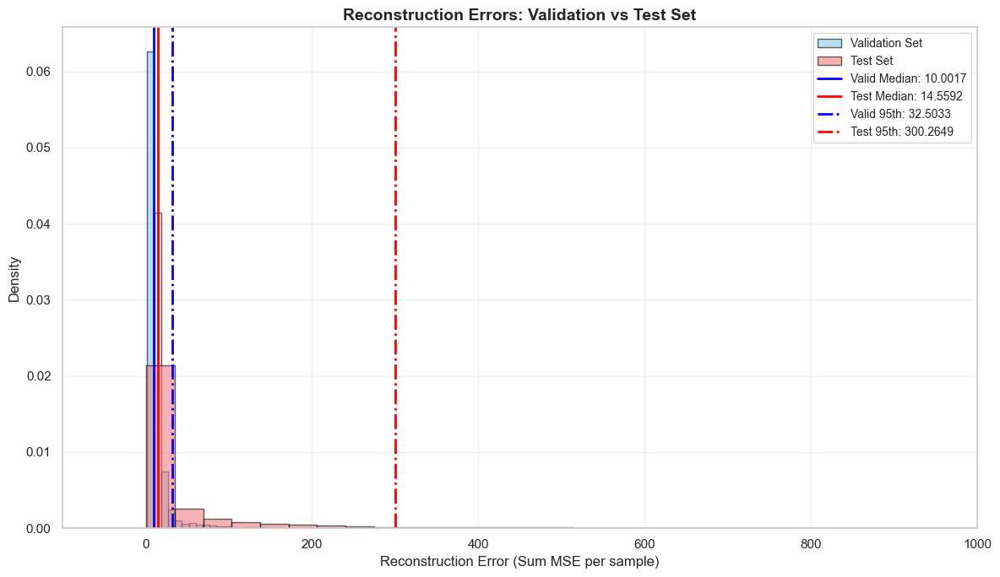

In [ ]:
# comparing reconstruction errors between validation and test sets
import numpy as np

# Compare validation and test reconstruction error distributions
valid_errors = reconstruction_errors_val
test_errors = reconstruction_errors_test

# Calculate statistics
valid_median = np.percentile(valid_errors, 50)
valid_p95 = np.percentile(valid_errors, 95)
test_median = np.percentile(test_errors, 50)
test_p95 = np.percentile(test_errors, 95)

print(f"\nValidation Set Statistics:")
print(f"  Median: {valid_median:.4f}")
print(f"  95th Percentile: {valid_p95:.4f}")
print(f"\nTest Set Statistics:")
print(f"  Median: {test_median:.4f}")
print(f"  95th Percentile: {test_p95:.4f}")

# Create overlapping histogram
plt.figure(figsize=(12, 7))

# Plot normalized histograms with transparency
plt.hist(valid_errors, bins=2000, alpha=0.6, color='skyblue',
         edgecolor='black', density=True, label='Validation Set')
plt.hist(test_errors, bins=2000, alpha=0.6, color='lightcoral',
         edgecolor='black', density=True, label='Test Set')

# Add median lines
plt.axvline(valid_median, color='blue', linewidth=2,
            label=f'Valid Median: {valid_median:.4f}')
plt.axvline(test_median, color='red',  linewidth=2,
            label=f'Test Median: {test_median:.4f}')

# Add 95th percentile lines
plt.axvline(valid_p95, color='blue', linestyle='-.', linewidth=2,
            label=f'Valid 95th: {valid_p95:.4f}')
plt.axvline(test_p95, color='red', linestyle='-.', linewidth=2,
            label=f'Test 95th: {test_p95:.4f}')

plt.title('Reconstruction Errors: Validation vs Test Set', fontsize=14, fontweight='bold')
plt.xlabel('Reconstruction Error (Sum MSE per sample)', fontsize=12)
plt.xlim(-100, 1000) 
plt.ylabel('Density', fontsize=12)
plt.legend(loc='upper right', fontsize=10)
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()



Validation Set Statistics:
  Median: 10.0017
  95th Percentile: 32.5033

Test Set Statistics:
  Median: 14.5592
  95th Percentile: 300.2649


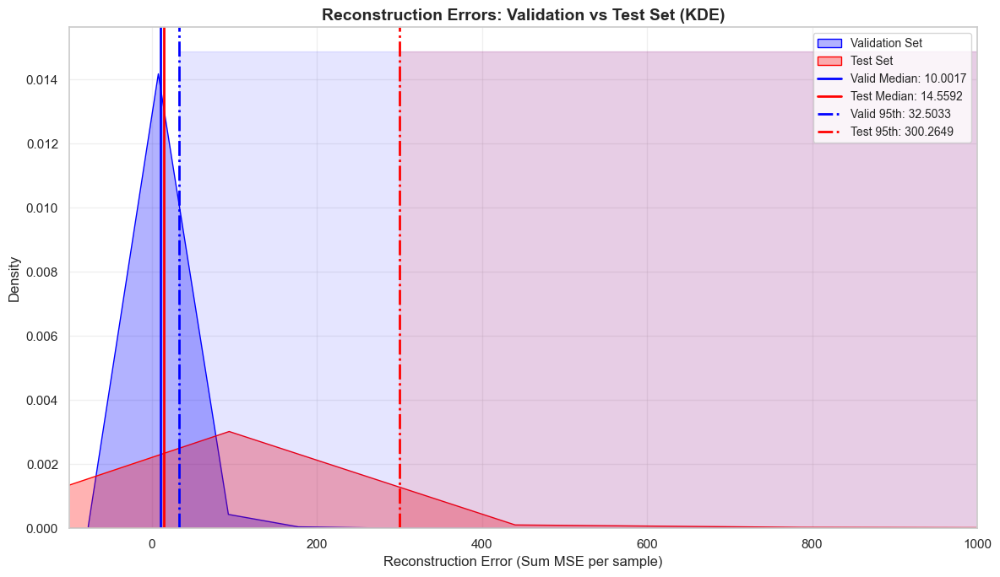

In [761]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Assume these are defined:
# reconstruction_errors_val, reconstruction_errors_test

# Calculate statistics
valid_median = np.percentile(reconstruction_errors_val, 50)
valid_p95 = np.percentile(reconstruction_errors_val, 95)
test_median = np.percentile(reconstruction_errors_test, 50)
test_p95 = np.percentile(reconstruction_errors_test, 95)

print(f"\nValidation Set Statistics:")
print(f"  Median: {valid_median:.4f}")
print(f"  95th Percentile: {valid_p95:.4f}")
print(f"\nTest Set Statistics:")
print(f"  Median: {test_median:.4f}")
print(f"  95th Percentile: {test_p95:.4f}")

# Plot KDEs
plt.figure(figsize=(12, 7))

# Validation KDE
sns.kdeplot(reconstruction_errors_val, color='blue', label='Validation Set', fill=True, alpha=0.3)

# Test KDE
sns.kdeplot(reconstruction_errors_test, color='red', label='Test Set', fill=True, alpha=0.3)

# Add median lines
plt.axvline(valid_median, color='blue', linewidth=2, label=f'Valid Median: {valid_median:.4f}')
plt.axvline(test_median, color='red', linewidth=2, label=f'Test Median: {test_median:.4f}')

# Add 95th percentile lines
plt.axvline(valid_p95, color='blue', linestyle='-.', linewidth=2, label=f'Valid 95th: {valid_p95:.4f}')
plt.axvline(test_p95, color='red', linestyle='-.', linewidth=2, label=f'Test 95th: {test_p95:.4f}')

# Optional: Shade areas above 95th percentile
y_max = max(plt.gca().get_ylim())
plt.fill_betweenx([0, y_max], valid_p95, max(reconstruction_errors_val.max(), reconstruction_errors_test.max()),
                  color='blue', alpha=0.1)
plt.fill_betweenx([0, y_max], test_p95, max(reconstruction_errors_val.max(), reconstruction_errors_test.max()),
                  color='red', alpha=0.1)

plt.title('Reconstruction Errors: Validation vs Test Set (KDE)', fontsize=14, fontweight='bold')
plt.xlabel('Reconstruction Error (Sum MSE per sample)', fontsize=12)
plt.xlim(-100, 1000) 
plt.ylabel('Density', fontsize=12)
plt.legend(loc='upper right', fontsize=10)
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()


In [766]:
# plot erros by class in the test set
from collections import defaultdict

errors_by_class = defaultdict(list)
for label, err in zip(true_labels, reconstruction_errors_test):
    errors_by_class[label].append(err)

for label, errs in errors_by_class.items():
    errs = np.array(errs)
    print(f"Class '{label}': {len(errs)} samples, mean={errs.mean():.6f}, std={errs.std():.6f}, max={errs.max():.6f}")


Class 'NORM': 12001 samples, mean=86.846825, std=2171.448486, max=68455.953125
Class 'MI': 30476 samples, mean=41.166992, std=135.473282, max=11939.203125
Class 'STTC': 30625 samples, mean=48.284885, std=384.971741, max=20660.386719
Class 'HYP': 6297 samples, mean=66.991486, std=412.107941, max=28232.847656
Class 'CD': 20476 samples, mean=205.685684, std=638.402649, max=30929.572266


In [767]:
high_error_mask = reconstruction_errors_test > threshold
print(f"Number of high-error samples: {np.sum(high_error_mask)}")


Number of high-error samples: 36298


In [754]:
import pandas as pd

df = pd.DataFrame({
    'seg_id': seg_ids_list,
    'label': true_labels,
    'reconstruction_error': reconstruction_errors_test,
    'applied_noise': applied_noise_list,
    'high_error': high_error_mask
})

df.head()


,seg_id,label,reconstruction_error,applied_noise,high_error
0,0,NORM,6.906413,clean,False
1,0,NORM,6.207001,clean,False
2,0,NORM,6.689677,clean,False
3,0,NORM,7.177476,clean,False
4,0,NORM,6.825282,clean,False


In [755]:
print(df['high_error'].value_counts())

high_error
False    63577
True     36298
Name: count, dtype: int64


In [756]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

def plot_reconstruction_error_by_label(df, threshold=None, model_name="Model", figsize=(10,6), save_path=None, x=None, y=None):
    """
    Plot reconstruction error distributions per label from a DataFrame.
    
    Parameters
    ----------
    df : pd.DataFrame
        Must contain columns: ['label', 'reconstruction_error']
    threshold : float, optional
        Vertical line at threshold value.
    model_name : str, optional
        Title for the plot.
    figsize : tuple, optional
        Figure size.
    save_path : str, optional
        If provided, saves the plot instead of showing it.
    """
    if not {'label', 'reconstruction_error'}.issubset(df.columns):
        raise ValueError("DataFrame must contain 'label' and 'reconstruction_error' columns.")
    
    plt.figure(figsize=figsize)
    
    for label in sorted(df['label'].unique()):
        subset = df[df['label'] == label]
        sns.kdeplot(
            subset['reconstruction_error'],
            label=label,
            fill=True,
            alpha=0.4
        )
    
    if threshold is not None:
        plt.axvline(threshold, color='black', linestyle='--', label=f'Threshold = {threshold:.3f} - Percentile= {percentile} Val_Set')
    
    plt.xlabel("Reconstruction Error", fontsize=12)
    plt.xlim(x, y)  # Adjust 500 to where most data points are_zoomed in
    plt.ylabel("Density", fontsize=12)
    plt.title(f"{model_name}: Reconstruction Error Distribution per Class in test set, percentile: ", fontsize=14)
    plt.legend(title="Label")
    plt.tight_layout()
    
    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches='tight')
        plt.close()
        print(f"✅ Plot saved to: {save_path}")
    else:
        plt.show()


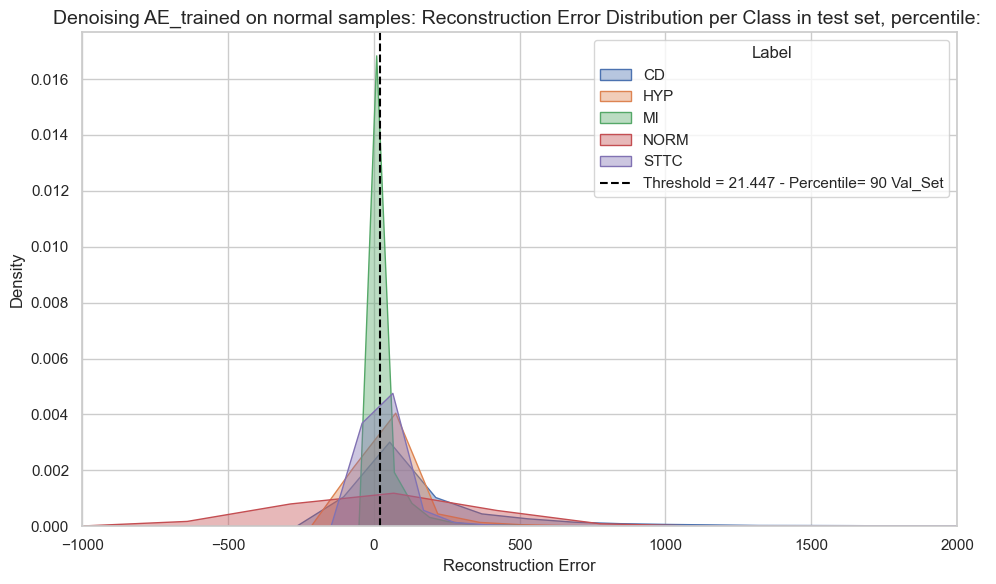

In [867]:
plot_reconstruction_error_by_label(
    df,
    threshold= threshold,
    model_name="Denoising AE_trained on normal samples",x= -1000, y= 2000)

In [713]:
def plot_high_error_percentage(df):
    summary = (
        df.groupby('label')['high_error']
        .mean()
        .sort_index() * 100
    )
    
    plt.figure(figsize=(8,5))
    sns.barplot(x=summary.index, y=summary.values, palette="viridis")
    plt.ylabel("High-Error Segments (%)")
    plt.xlabel("Label")
    plt.title("Percentage of High-Error Segments in test set in each Class ")
    plt.tight_layout()
    plt.show()


/var/folders/_q/5x9zh28s2pj47my26qs5235c0000gn/T/ipykernel_1250/2561858550.py:9: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




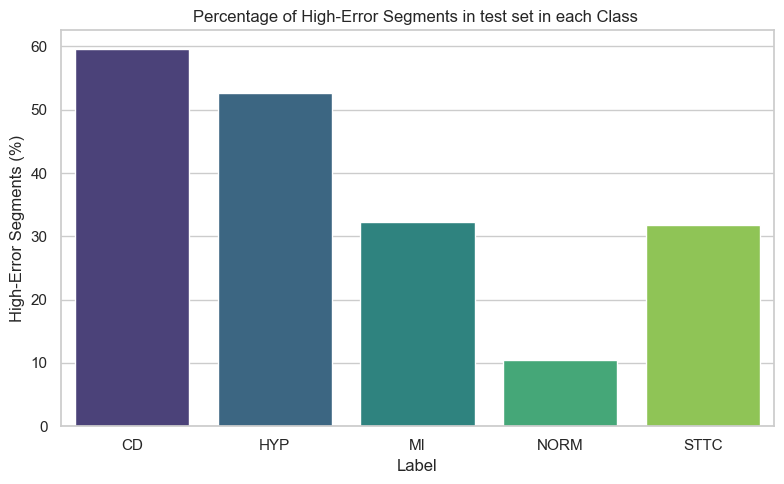

In [715]:
plot_high_error_percentage(df)

In [716]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np

sns.set(style="whitegrid")

def plot_high_low_pies(
    df,
    label_col='label',
    high_col='high_error',
    top_k=None,           # if set, keep top_k labels, group rest as 'Other'
    pct_threshold=0.01,   # if top_k is None, labels with < pct_threshold fraction get grouped
    figsize=(12,6),
    title_high="High-error segments (composition)",
    title_low="Low-error segments (composition)",
    class_colors=None     # <-- NEW argument: pass your color dict here!
):
    # Helper to compute percent series and optionally group small slices into 'Other'
    def label_percent_series(subdf):
        if len(subdf) == 0:
            return pd.Series(dtype=float)
        counts = subdf[label_col].value_counts()
        fracs = counts / counts.sum()
        # optionally group small labels
        if top_k is not None and top_k < len(fracs):
            top = fracs.nlargest(top_k)
            other = fracs.drop(top.index).sum()
            series = pd.concat([top, pd.Series({'Other': other})])
            series = series.sort_values(ascending=False)
            return series * 100
        else:
            # group by pct threshold
            small = fracs[fracs < pct_threshold]
            if len(small) > 0 and len(fracs) > 1:
                big = fracs[fracs >= pct_threshold]
                other_sum = small.sum()
                series = pd.concat([big, pd.Series({'Other': other_sum})])
                series = series.sort_values(ascending=False)
                return series * 100
            else:
                return (fracs * 100).sort_values(ascending=False)

    df_high = df[df[high_col] == True]
    df_low  = df[df[high_col] == False]

    series_high = label_percent_series(df_high)
    series_low  = label_percent_series(df_low)

    # create figure
    fig, axes = plt.subplots(1, 2, figsize=figsize)

    # use user color mapping if provided, otherwise default colormap
    all_labels = list(pd.Index(series_high.index).union(series_low.index))
    if class_colors is not None:
        color_map = {lbl: class_colors.get(lbl, "#cccccc") for lbl in all_labels}
    else:
        cmap = plt.get_cmap('tab20')
        color_map = {lbl: cmap(i % cmap.N) for i, lbl in enumerate(all_labels)}

    def get_colors(series):
        return [color_map.get(lbl, "#cccccc") for lbl in series.index]

    # Plot high-error pie
    if len(series_high) == 0:
        axes[0].text(0.5, 0.5, 'No high-error samples', ha='center', va='center')
        axes[0].axis('off')
    else:
        axes[0].pie(
            series_high.values,
            labels=None,
            autopct=lambda pct: f"{pct:.1f}%" if pct > 2 else "",
            startangle=90,
            colors=get_colors(series_high),
            pctdistance=0.7
        )
        axes[0].set_title(title_high)
        axes[0].legend(
            [f"{lbl} ({series_high.loc[lbl]:.1f}%)" for lbl in series_high.index],
            loc='center left', bbox_to_anchor=(1.05, 0.5), fontsize='small'
        )
        axes[0].axis('equal')

    # Plot low-error pie
    if len(series_low) == 0:
        axes[1].text(0.5, 0.5, 'No low-error samples', ha='center', va='center')
        axes[1].axis('off')
    else:
        axes[1].pie(
            series_low.values,
            labels=None,
            autopct=lambda pct: f"{pct:.1f}%" if pct > 2 else "",
            startangle=90,
            colors=get_colors(series_low),
            pctdistance=0.7
        )
        axes[1].set_title(title_low)
        axes[1].legend(
            [f"{lbl} ({series_low.loc[lbl]:.1f}%)" for lbl in series_low.index],
            loc='center left', bbox_to_anchor=(1.05, 0.5), fontsize='small'
        )
        axes[1].axis('equal')

    plt.tight_layout()
    plt.show()

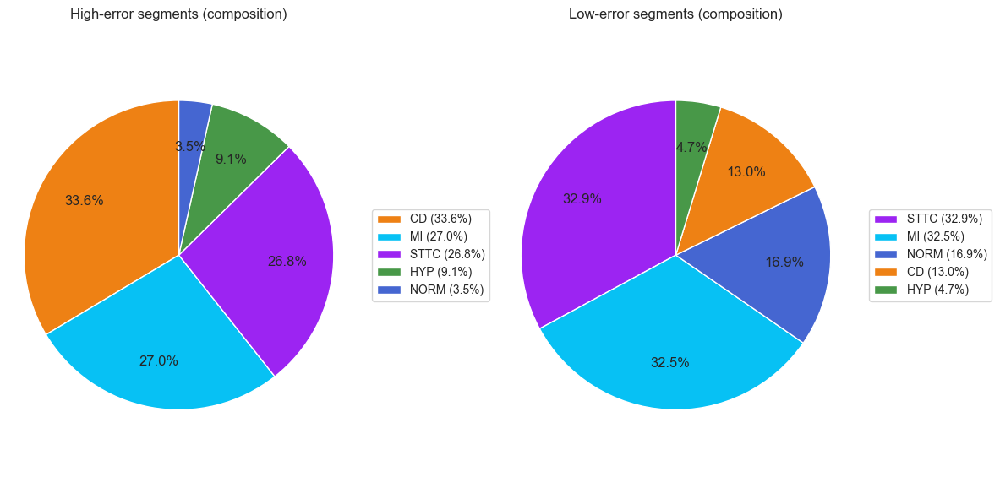

In [717]:
class_colors = {
    'NORM': "#4566D1",
    'HYP': "#489848",
    'MI': "#07C1F4",
    'CD': "#EE8114",
    'STTC': "#9C24F2",

}

plot_high_low_pies(
    df=df,         # replace with your DataFrame
    label_col='label',
    high_col='high_error',
    class_colors=class_colors
)

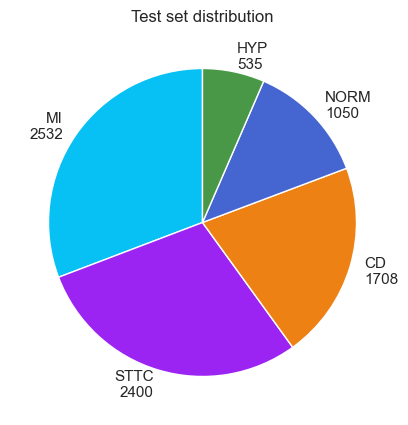

In [869]:
# compare with the test set distribution of labeles that we plot at the beggining of the notebook
plot_class_distribution_abs(Y_test, "Test set distribution", class_colors=class_colors)



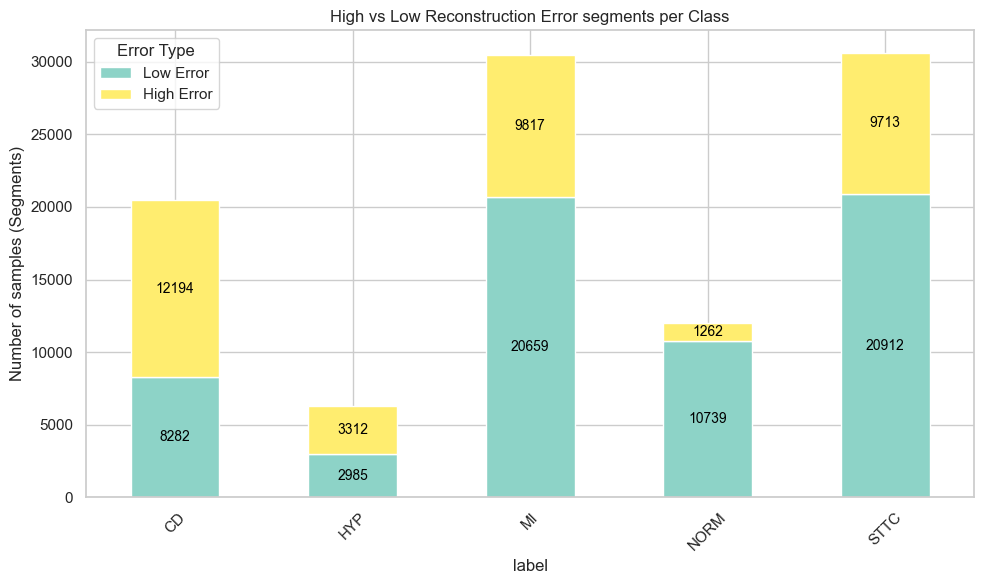

In [719]:
import matplotlib.pyplot as plt

# Group by label and high_error
counts = df.groupby(['label', 'high_error']).size().unstack(fill_value=0)

# Optional: rename columns for clarity
counts.columns = ['Low Error', 'High Error']

# Plot stacked bar chart
ax = counts.plot(kind='bar', stacked=True, figsize=(10,6), colormap='Set3')
plt.ylabel('Number of samples (Segments)')
plt.title('High vs Low Reconstruction Error segments per Class')
plt.xticks(rotation=45)
plt.legend(title='Error Type')

# Annotate bars with number of samples
for i, (low, high) in enumerate(zip(counts['Low Error'], counts['High Error'])):
    ax.text(i, low/2, str(low), ha='center', va='center', color='black', fontsize=10)
    ax.text(i, low + high/2, str(high), ha='center', va='center', color='black', fontsize=10)

plt.tight_layout()



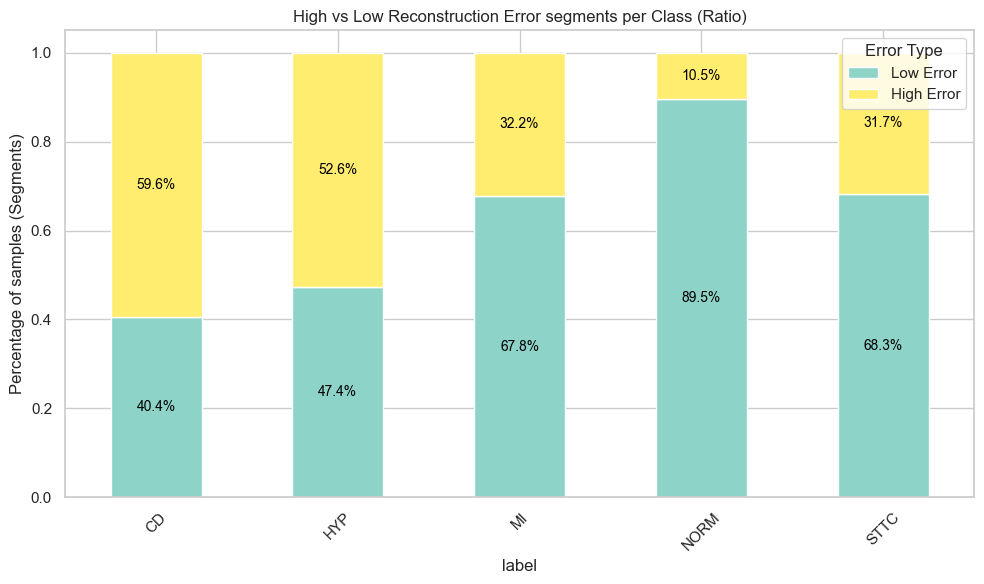

In [720]:
import matplotlib.pyplot as plt

# Compute ratio per class
ratio = counts.div(counts.sum(axis=1), axis=0)

# Plot stacked bar chart of ratios
ax = ratio.plot(kind='bar', stacked=True, figsize=(10,6), colormap='Set3')

plt.ylabel('Percentage of samples (Segments)')
plt.title('High vs Low Reconstruction Error segments per Class (Ratio)')
plt.xticks(rotation=45)
plt.legend(title='Error Type')

# Add percentage numbers on the bars
for i, (low, high) in enumerate(zip(ratio['Low Error'], ratio['High Error'])):
    ax.text(i, low/2, f"{low*100:.1f}%", ha='center', va='center', color='black', fontsize=10)
    ax.text(i, low + high/2, f"{high*100:.1f}%", ha='center', va='center', color='black', fontsize=10)

plt.tight_layout()
plt.show()


## Analysis at the ECG level: Mapped Segments to original ECGs

In [721]:
# Number of high-error segments per original ECG
high_error_df = df[df['high_error']]
print(high_error_df.head())

# Count segments per ECG
high_error_counts = high_error_df.groupby('seg_id').size().sort_values(ascending=False)
print("Number of high-error segments per ECG:")
print(high_error_counts.head(10))  # show top 10

# Optionally, see all labels for these ECGs
high_error_labels = high_error_df.groupby('seg_id')['label'].unique()
print("\nLabels for top high-error ECGs:")
print(high_error_labels.head(10))


     seg_id label  reconstruction_error applied_noise  high_error
30        2  NORM             23.807697         clean        True
61        5  NORM             34.257877         clean        True
80        7  NORM            281.167206         clean        True
81        7  NORM             99.158920         clean        True
173      14  NORM             64.120407         clean        True
Number of high-error segments per ECG:
seg_id
6367    29
1552    28
1988    28
4857    28
1543    26
8182    26
2178    26
4582    26
1915    26
5466    26
dtype: int64

Labels for top high-error ECGs:
seg_id
2     [NORM]
5     [NORM]
7     [NORM]
14    [NORM]
15    [NORM]
20    [NORM]
23    [NORM]
26    [NORM]
27    [NORM]
28    [NORM]
Name: label, dtype: object


In [722]:
# calculate number of ECG with at least one high error segment

# # Filter high-error segments
high_error_df = df[df['high_error']]

# Count unique ECGs with at least one high-error segment
num_ecgs_with_high_error = high_error_df['seg_id'].nunique()
print(f"Number of ECGs with at least one high-error segment: {num_ecgs_with_high_error}")

# Optionally, list the ECG IDs
ecg_ids_with_high_error = high_error_df['seg_id'].unique()
print("Example ECG IDs with high-error segments:", ecg_ids_with_high_error[:10])


Number of ECGs with at least one high-error segment: 4682
Example ECG IDs with high-error segments: [ 2  5  7 14 15 20 23 26 27 28]


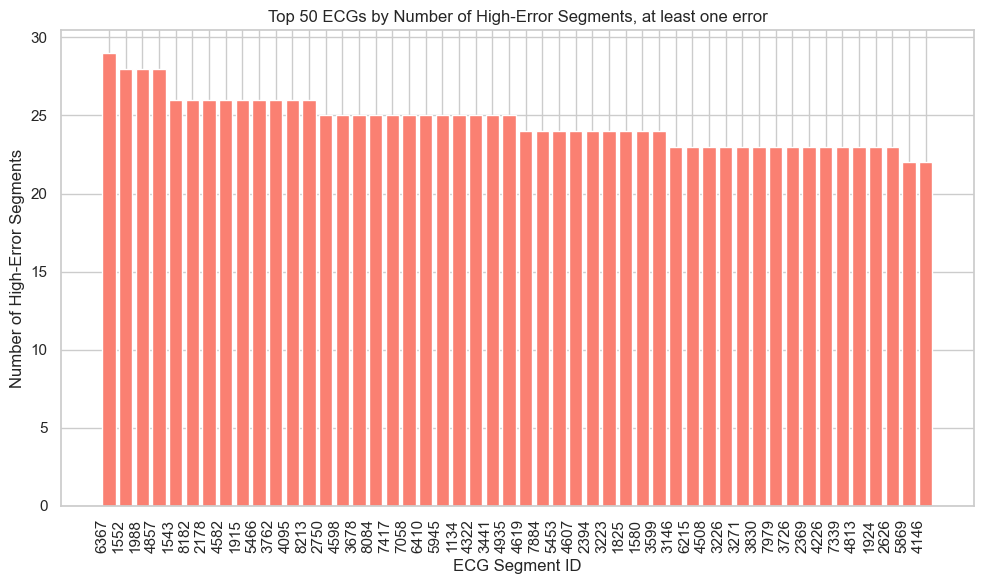

In [723]:
top_n = 50
top_counts = high_error_counts.head(top_n)

plt.figure(figsize=(10,6))
plt.bar(top_counts.index.astype(str), top_counts.values, color='salmon')
plt.xticks(rotation=90, ha='right')
plt.xlabel('ECG Segment ID')
plt.ylabel('Number of High-Error Segments')
plt.title(f'Top {top_n} ECGs by Number of High-Error Segments, at least one error')
plt.tight_layout()
plt.show()

In [724]:
# Total number of segments per ECG
total_segments_per_ecg = df.groupby('seg_id').size()
print(total_segments_per_ecg.tail(10))

# High-error segments per ECG
high_error_counts = df[df['high_error']].groupby('seg_id').size()

# Combine into a single DataFrame
ecg_summary = pd.DataFrame({
    'total_segments': total_segments_per_ecg,
    'high_error_segments': high_error_counts
}).fillna(0).astype(int)

print(ecg_summary.head(10))


seg_id
8215    14
8216    11
8217    10
8218    15
8219    11
8220     9
8221    12
8222    15
8223    17
8224     9
dtype: int64
        total_segments  high_error_segments
seg_id                                     
0                    8                    0
1                   12                    0
2                   11                    1
3                   10                    0
4                   10                    0
5                   11                    1
6                   11                    0
7                   12                    2
8                   14                    0
9                   11                    0


In [725]:
ecg_summary['high_error_percent'] = ecg_summary['high_error_segments'] / ecg_summary['total_segments'] * 100
print(ecg_summary.head(10))


        total_segments  high_error_segments  high_error_percent
seg_id                                                         
0                    8                    0            0.000000
1                   12                    0            0.000000
2                   11                    1            9.090909
3                   10                    0            0.000000
4                   10                    0            0.000000
5                   11                    1            9.090909
6                   11                    0            0.000000
7                   12                    2           16.666667
8                   14                    0            0.000000
9                   11                    0            0.000000


In [726]:
# Sort by high_error_segments in descending order
ecg_summary_sorted = ecg_summary.sort_values(by='high_error_segments', ascending=False)

# Print the top 10 ECGs with the most errors
print(ecg_summary_sorted.head(10))

        total_segments  high_error_segments  high_error_percent
seg_id                                                         
6367                29                   29          100.000000
4857                28                   28          100.000000
1552                28                   28          100.000000
1988                28                   28          100.000000
8182                26                   26          100.000000
8213                26                   26          100.000000
1915                26                   26          100.000000
2178                27                   26           96.296296
4095                26                   26          100.000000
3762                26                   26          100.000000


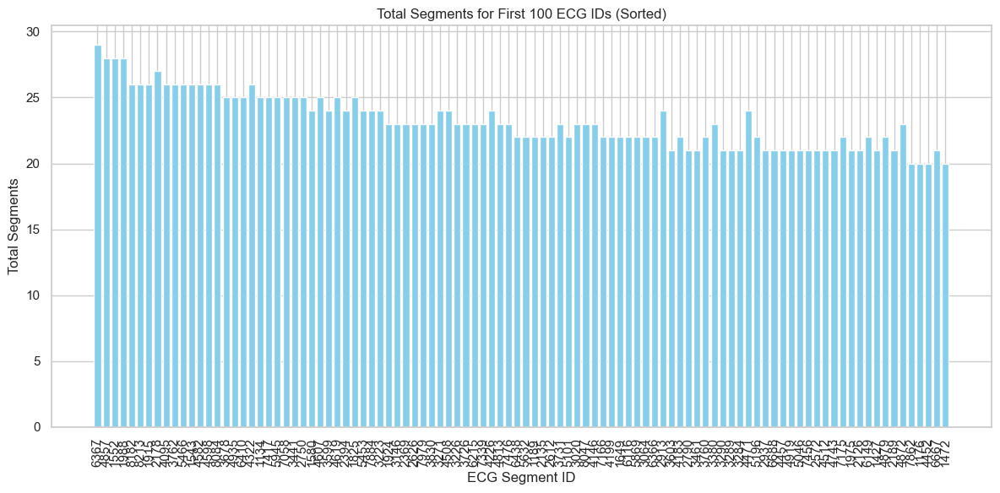

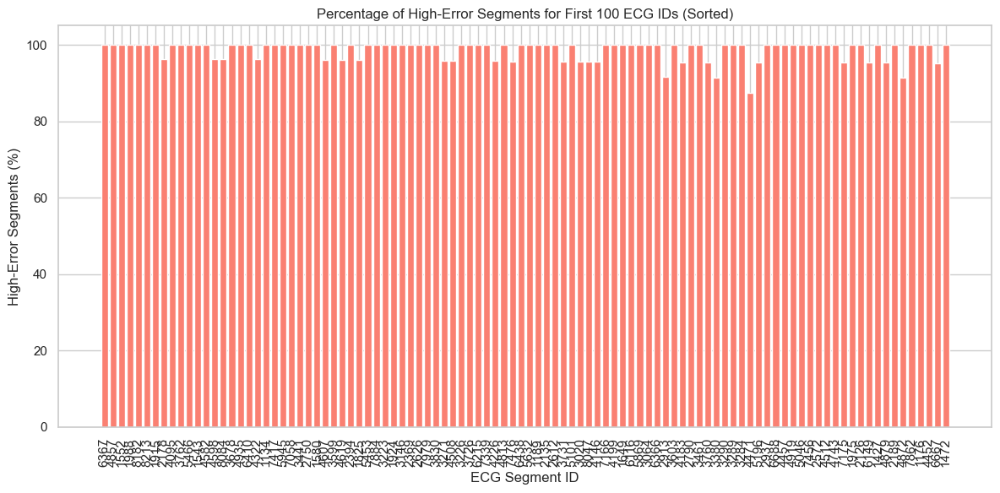

In [727]:
import matplotlib.pyplot as plt

# Select first 50 IDs
top_100 = ecg_summary_sorted.head(100)

plt.figure(figsize=(12,6))
plt.bar(top_100.index.astype(str), top_100['total_segments'], color='skyblue')
plt.xticks(rotation=90)
plt.xlabel('ECG Segment ID')
plt.ylabel('Total Segments')
plt.title('Total Segments for First 100 ECG IDs (Sorted)')
plt.tight_layout()
plt.show()



plt.figure(figsize=(12,6))
plt.bar(top_100.index.astype(str), top_100['high_error_percent'], color='salmon')
plt.xticks(rotation=90)
plt.xlabel('ECG Segment ID')
plt.ylabel('High-Error Segments (%)')
plt.title('Percentage of High-Error Segments for First 100 ECG IDs (Sorted)')
plt.tight_layout()
plt.show()

The amount of errors in one does not correlate with the number of segments extracted from these ECG

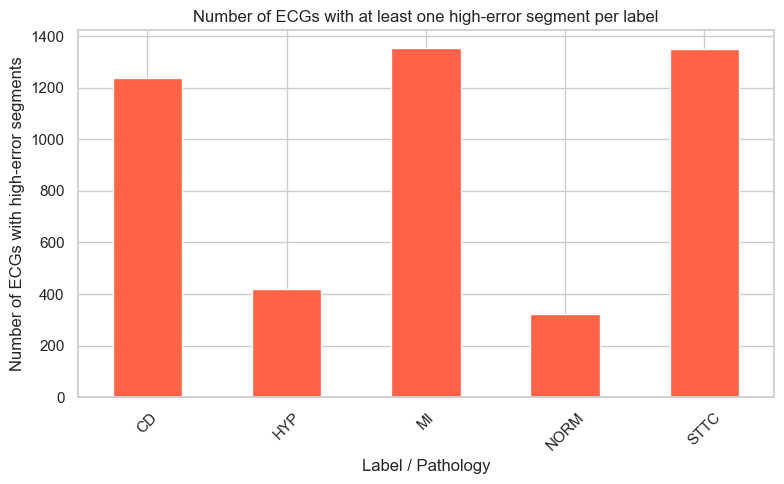

In [728]:
import matplotlib.pyplot as plt

# Filter only high-error segments
high_error_df = df[df['high_error']]

# Count unique ECGs per label
high_error_ecgs_per_label = high_error_df.groupby('label')['seg_id'].nunique()

# Plot
plt.figure(figsize=(8,5))
high_error_ecgs_per_label.plot(kind='bar', color='tomato')
plt.title("Number of ECGs with at least one high-error segment per label")
plt.xlabel("Label / Pathology")
plt.ylabel("Number of ECGs with high-error segments")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


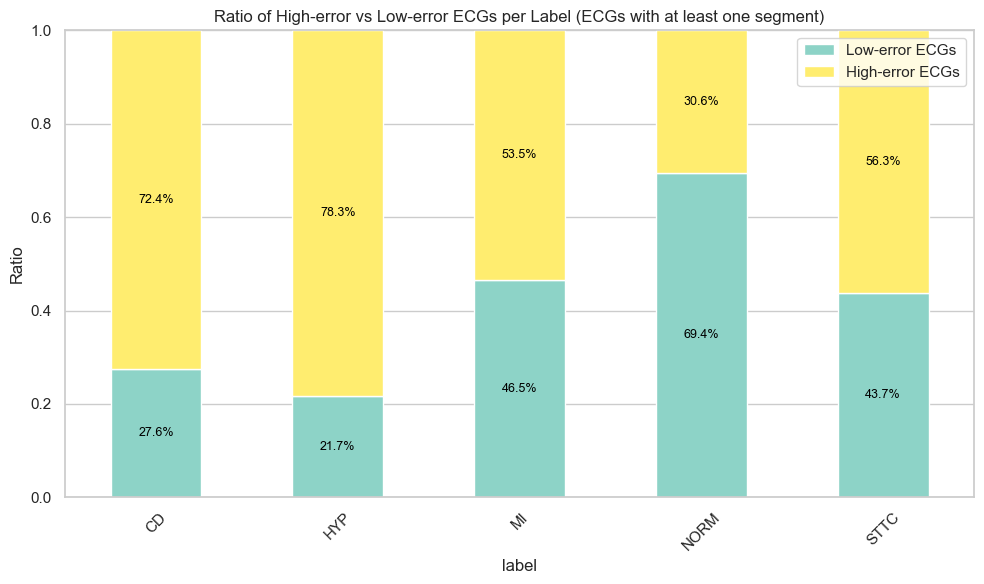

In [729]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Compute ratios
total_ecgs_per_label = df.groupby('label')['seg_id'].nunique()
high_error_ecgs_per_label = df[df['high_error']].groupby('label')['seg_id'].nunique()
high_error_ratio = (high_error_ecgs_per_label / total_ecgs_per_label).fillna(0)
low_error_ratio = 1 - high_error_ratio

# Combine into DataFrame
ratio_df = pd.DataFrame({
    'Low-error ECGs': low_error_ratio,
    'High-error ECGs': high_error_ratio
    
})

# Plot stacked bar chart with Set3 colormap
ax = ratio_df.plot(kind='bar', stacked=True, figsize=(10,6), colormap='Set3')

# Add percentages inside bars
for i, label in enumerate(ratio_df.index):
    bottom = 0
    for col in ratio_df.columns:
        value = ratio_df.loc[label, col]
        if value > 0:
            ax.text(
                i, bottom + value/2, f"{value*100:.1f}%",
                ha='center', va='center', fontsize=9, color='black'
            )
        bottom += value

plt.title("Ratio of High-error vs Low-error ECGs per Label (ECGs with at least one segment)")
plt.ylabel("Ratio")
plt.ylim(0,1)
plt.xticks(rotation=45)
plt.legend(loc='upper right')
plt.tight_layout()
plt.show()


Add a threshold of number of segments needed to have high error that the whole ECG is spotted as wrong

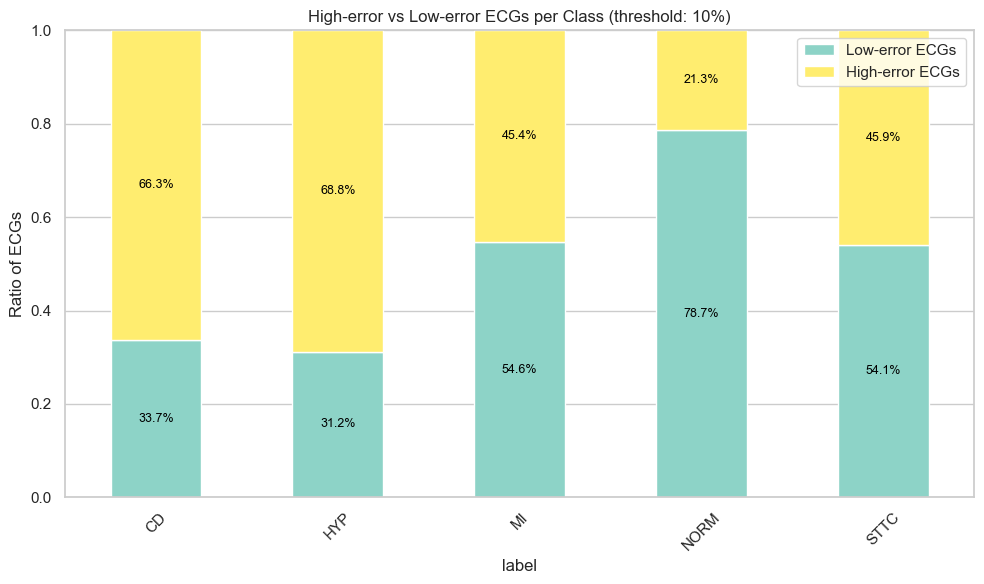

In [877]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# --- Compute high-error ratio per ECG ---
ecg_summary['high_error_ratio'] = ecg_summary['high_error_segments'] / ecg_summary['total_segments']

# --- Mark ECGs as high-error if ratio exceeds threshold ---
threshold_ratio = 0.10  # change this as needed
ecg_summary['high_error_ecg'] = ecg_summary['high_error_ratio'] >= threshold_ratio

# --- Aggregate per label ---
high_error_ecgs_per_label = df.groupby('label')['seg_id'].unique().apply(
    lambda seg_ids: sum(ecg_summary.loc[seg_ids, 'high_error_ecg'])
)
total_ecgs_per_label = df.groupby('label')['seg_id'].nunique()

# --- Compute percentage of high-error and low-error ECGs ---
high_error_ratio_per_label = high_error_ecgs_per_label / total_ecgs_per_label
low_error_ratio_per_label = 1 - high_error_ratio_per_label


# Combine into DataFrame
ratio_df = pd.DataFrame({
    'Low-error ECGs': low_error_ratio_per_label,
    'High-error ECGs': high_error_ratio_per_label
    
})

    
   
# --- Plot stacked bar chart ---
ax = ratio_df.plot(kind='bar', stacked=True, figsize=(10,6), colormap='Set3')
plt.title(f"High-error vs Low-error ECGs per Class (threshold: {threshold_ratio*100:.0f}%)")
plt.ylabel("Ratio of ECGs")
plt.ylim(0,1)
plt.xticks(rotation=45)

# --- Add percentages on bars ---
for p in ax.patches:
    height = p.get_height()
    if height > 0.01:  # avoid cluttering very small bars
        ax.text(
            p.get_x() + p.get_width()/2, 
            p.get_y() + height/2, 
            f"{height*100:.1f}%", 
            ha='center', va='center', fontsize=9, color='black'
        )

plt.legend(loc='upper right')
plt.tight_layout()
plt.show()


Expanding the segmentation window to capture the full ECG cycle or even experimenting with overlapping windows might give the model the necessary context to distinguish between normal and pathological ECGs more effectively. This could help improve detection for CD, HYP, and other pathologies by allowing the autoencoder to better learn the full morphology of the ECG signal.

## Vizualization of few High and Low error Segments from the Test Set

=== High-error samples ===


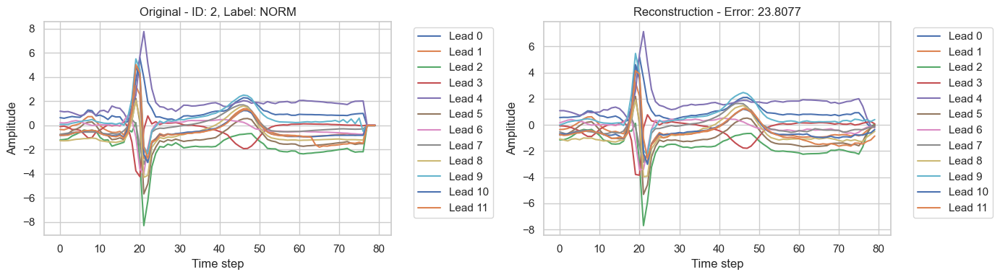

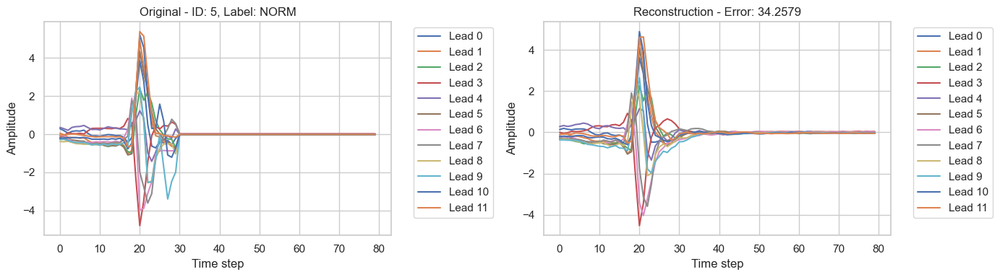

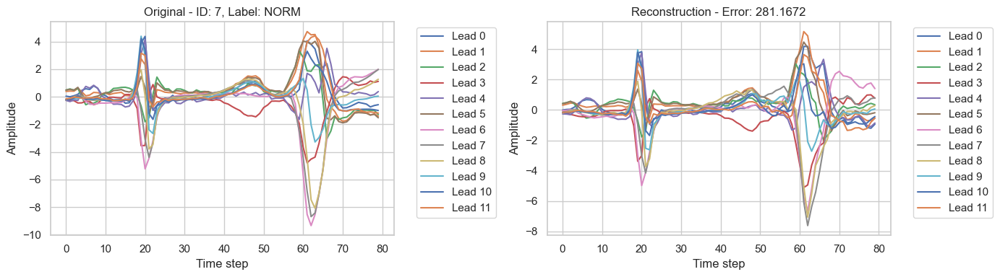

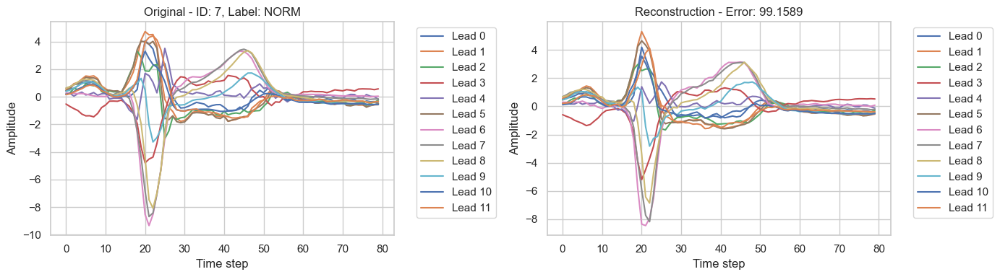

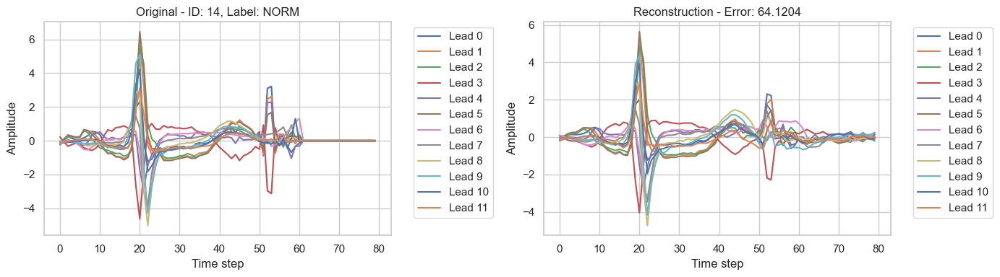

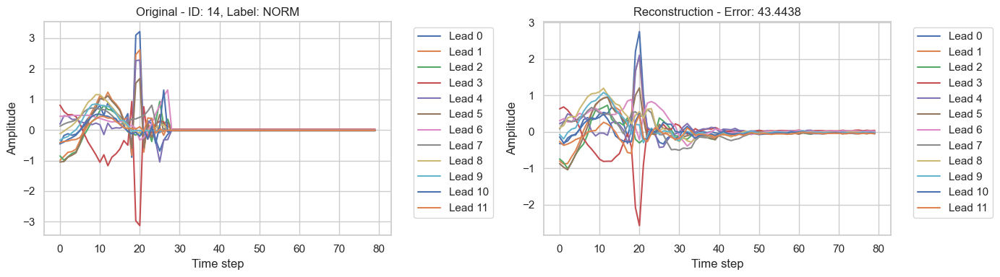

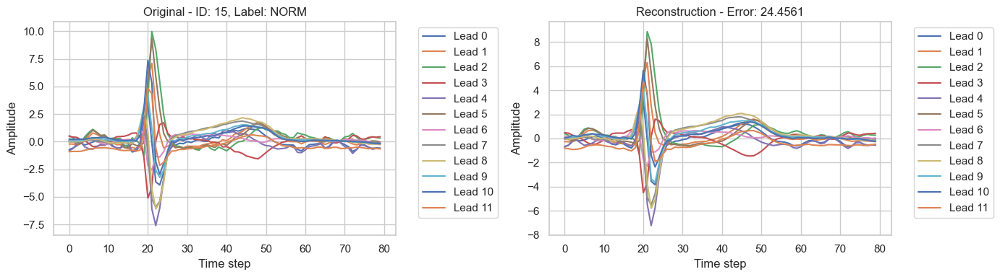

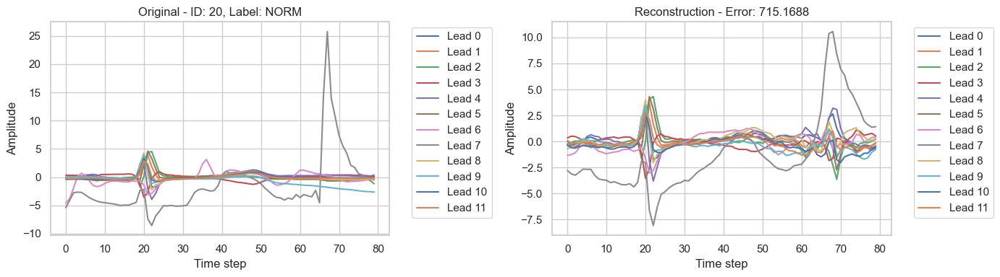

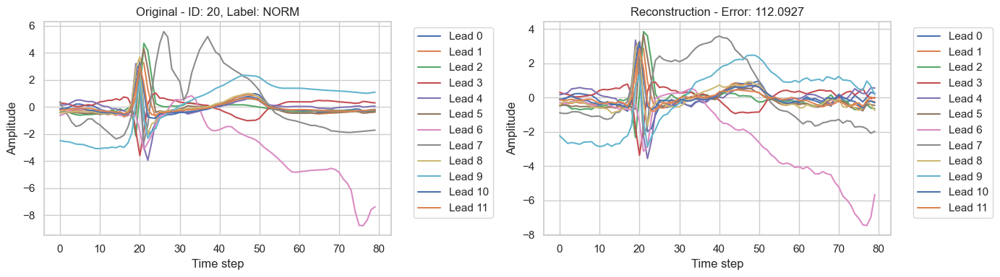

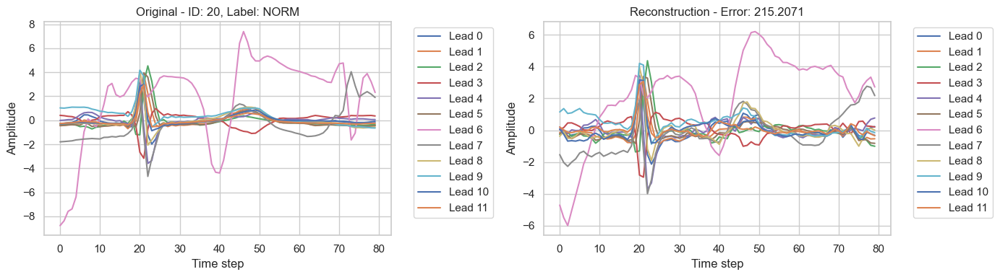

=== Low-error samples ===


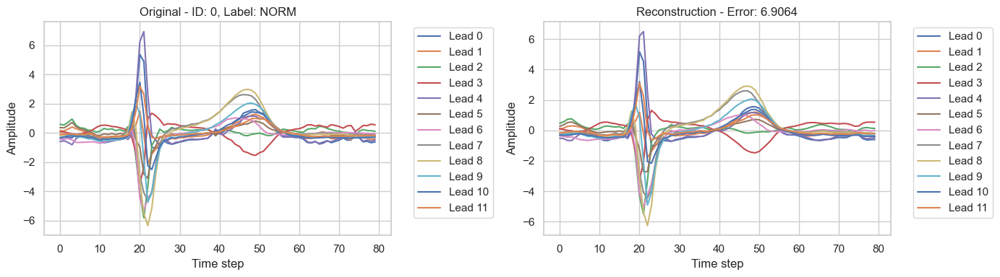

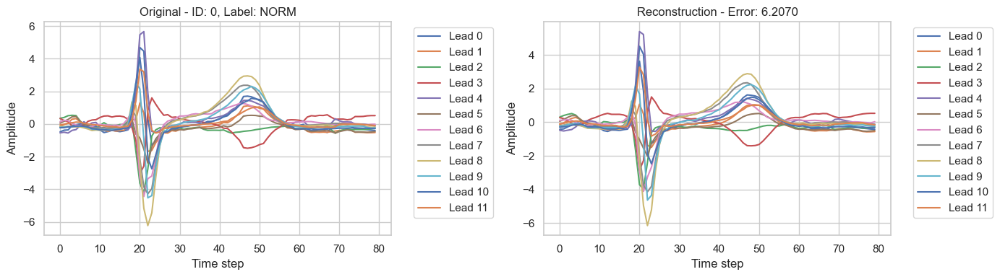

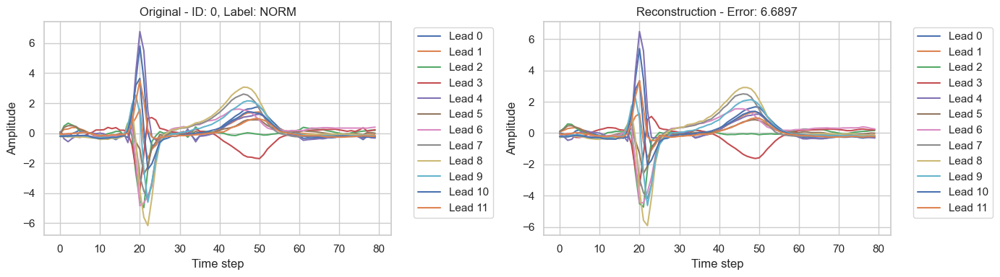

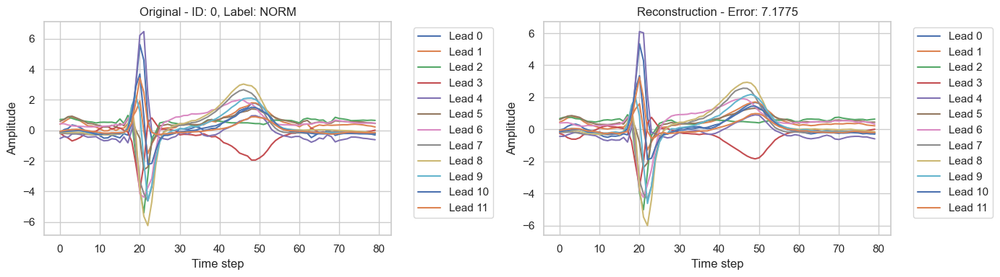

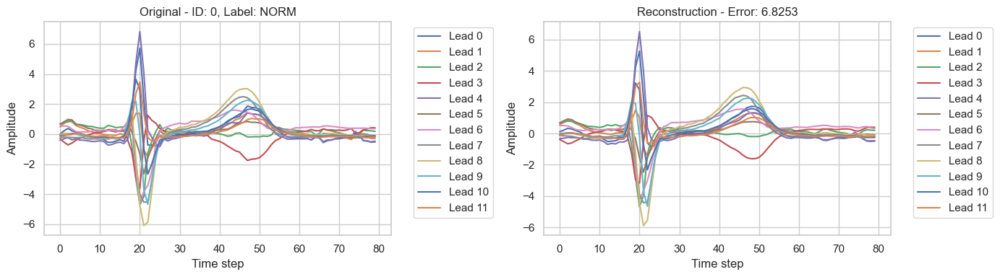

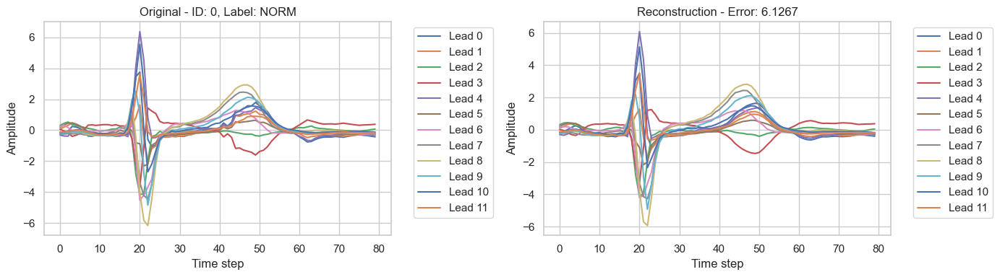

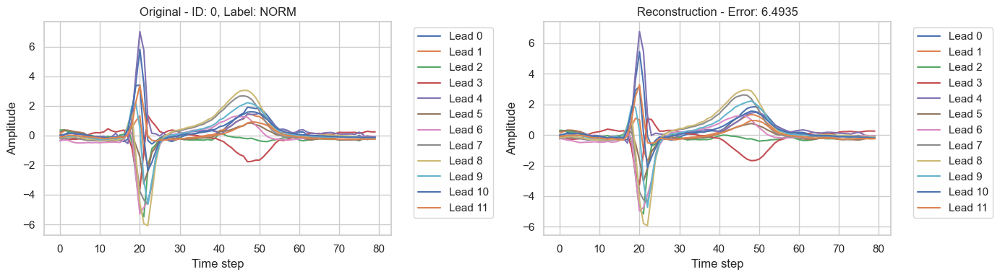

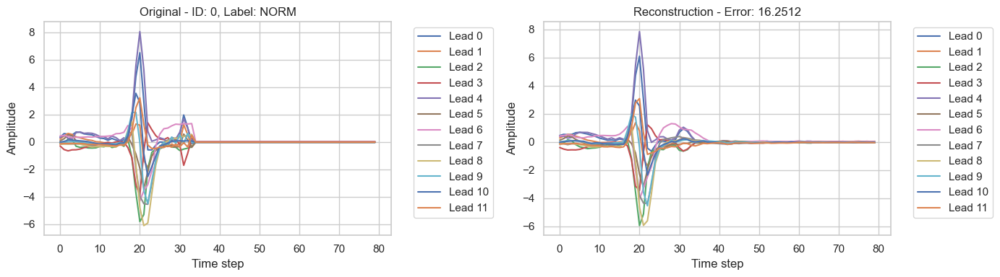

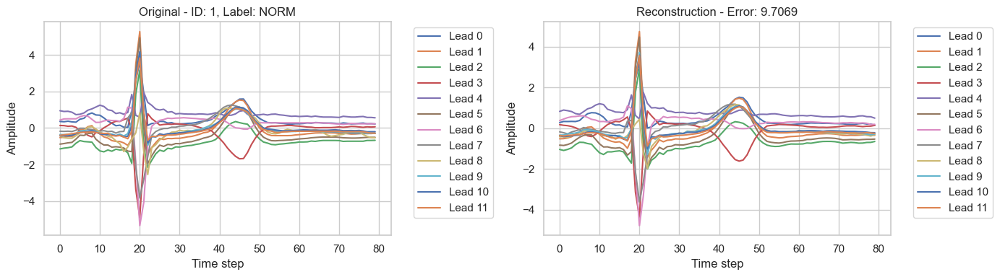

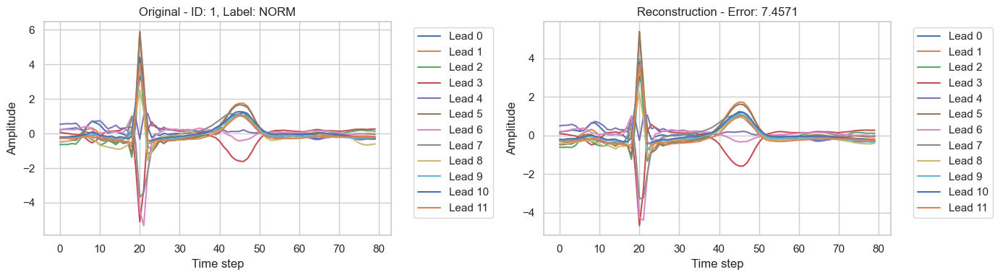

In [ ]:
# Vizualization of high-error and low-error samples from the test set first samples on the test set...all are normals (sinnce we did not shuffle)
# import matplotlib.pyplot as plt
import numpy as np
import torch

model.eval()

# --- Pick a few samples to plot ---
n_examples = 10
high_error_indices = np.where(high_error_mask)[0][:n_examples]
low_error_indices  = np.where(~high_error_mask)[0][:n_examples]

# Flatten test_loader to lists for easy indexing
all_clean, all_recon, all_labels, all_seg_ids = [], [], [], []

with torch.no_grad():
    for noisy_batch, clean_batch, labels_batch, seg_ids_batch, _ in test_loader:
        noisy_batch = noisy_batch.to(device)
        output_batch = model(noisy_batch)
        all_clean.append(clean_batch.cpu())
        all_recon.append(output_batch.cpu())
        all_labels.extend(labels_batch)
        all_seg_ids.extend(seg_ids_batch)

all_clean = torch.cat(all_clean, dim=0).numpy()
all_recon = torch.cat(all_recon, dim=0).numpy()

def plot_sample(idx):
    plt.figure(figsize=(14,4))
    
    # Original signals
    plt.subplot(1,2,1)
    for lead in range(all_clean.shape[2]):
        plt.plot(all_clean[idx,:,lead], label=f'Lead {lead}')
    plt.title(f"Original - ID: {all_seg_ids[idx]}, Label: {all_labels[idx]}")
    plt.xlabel("Time step")
    plt.ylabel("Amplitude")
    plt.legend(bbox_to_anchor=(1.05,1), loc='upper left')
    
    # Reconstructed signals
    plt.subplot(1,2,2)
    for lead in range(all_recon.shape[2]):
        plt.plot(all_recon[idx,:,lead], label=f'Lead {lead}')
    plt.title(f"Reconstruction - Error: {reconstruction_errors[idx]:.4f}")
    plt.xlabel("Time step")
    plt.ylabel("Amplitude")
    plt.legend(bbox_to_anchor=(1.05,1), loc='upper left')
    
    plt.tight_layout()
    plt.show()

# --- Plot high-error samples ---
print("=== High-error samples ===")
for idx in high_error_indices:
    plot_sample(idx)

# --- Plot low-error samples ---
print("=== Low-error samples ===")
for idx in low_error_indices:
    plot_sample(idx)


Using device: mps
=== 🟥 High-error samples (across different categories) ===


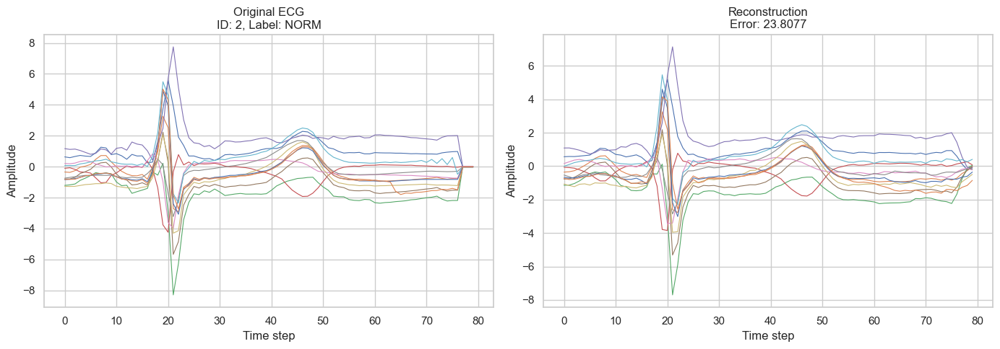

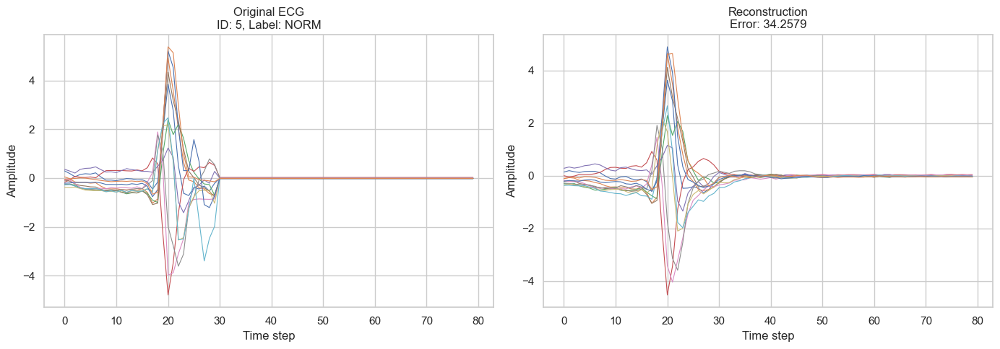

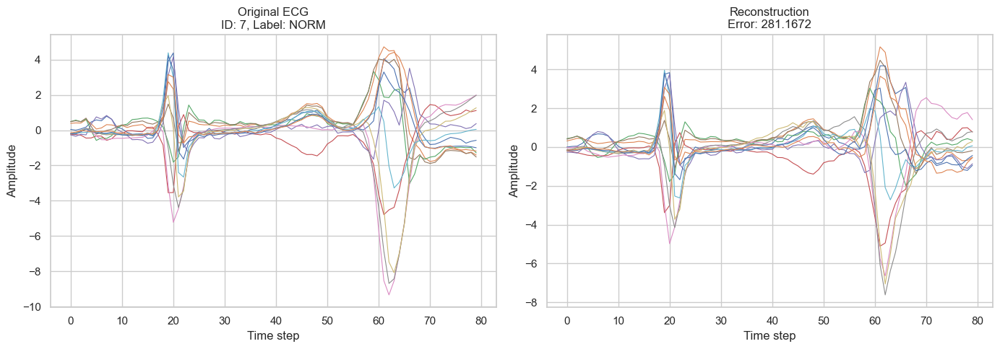

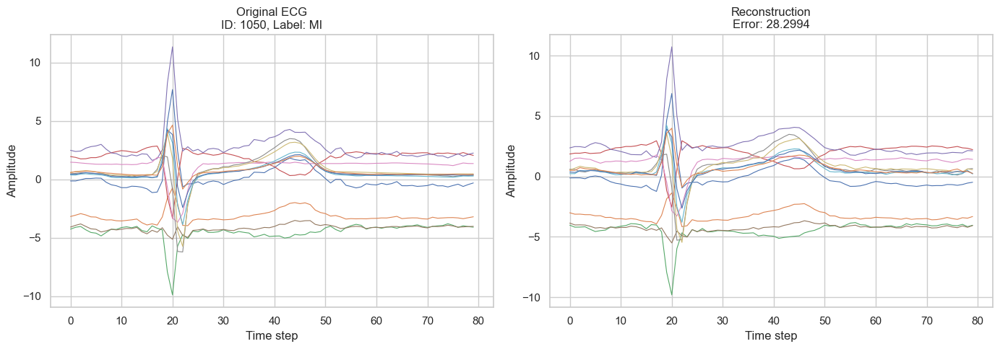

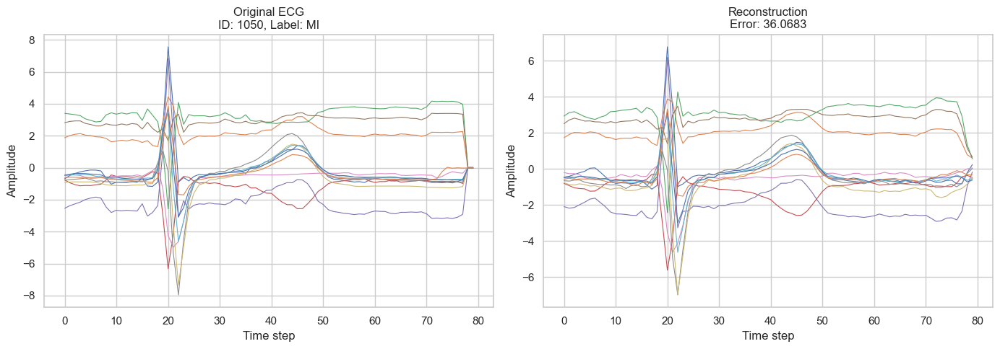

...

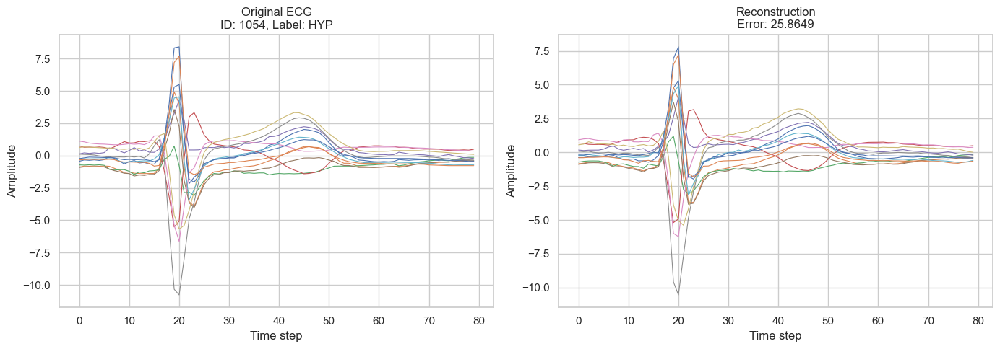

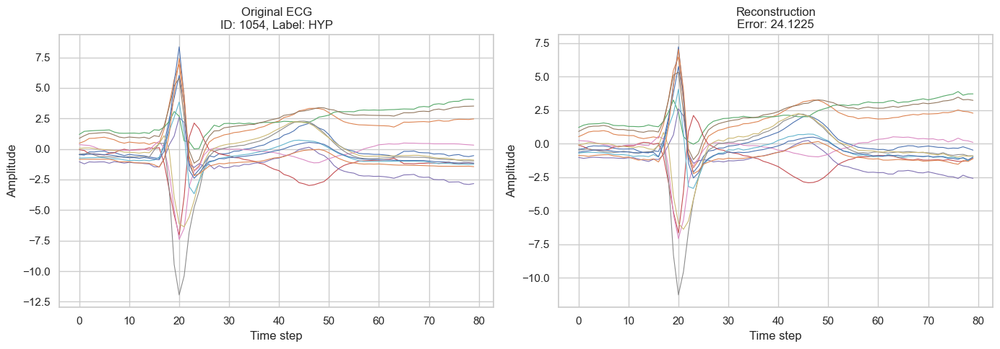

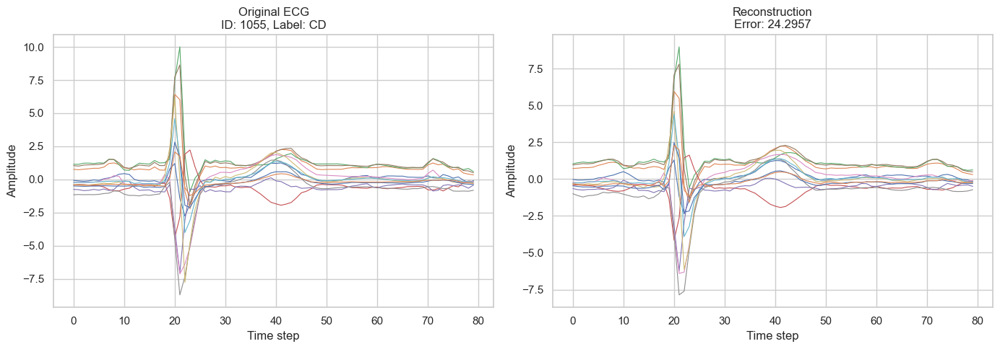

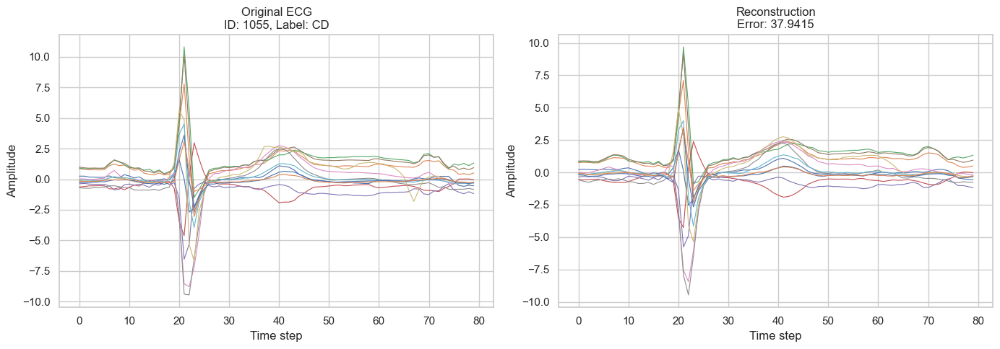

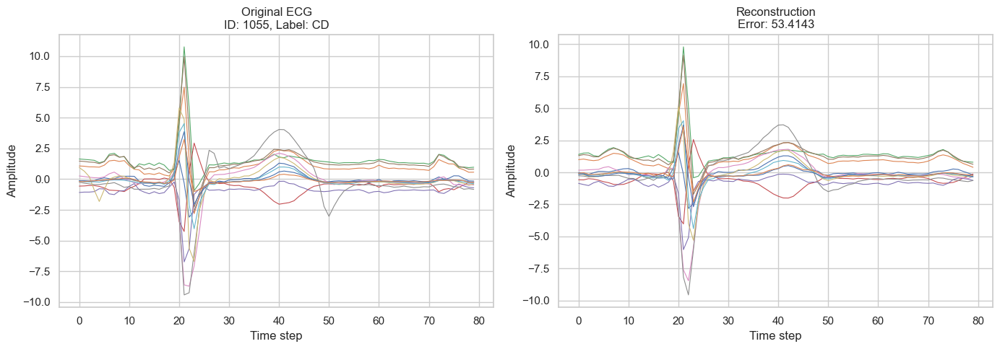


=== 🟩 Low-error samples (across different categories) ===


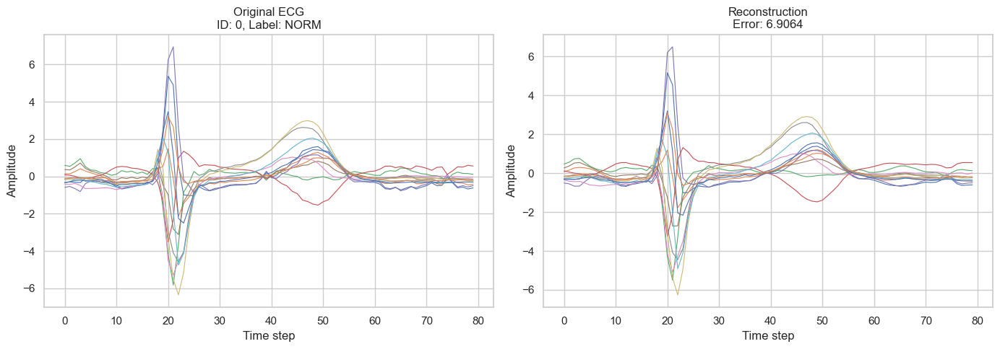

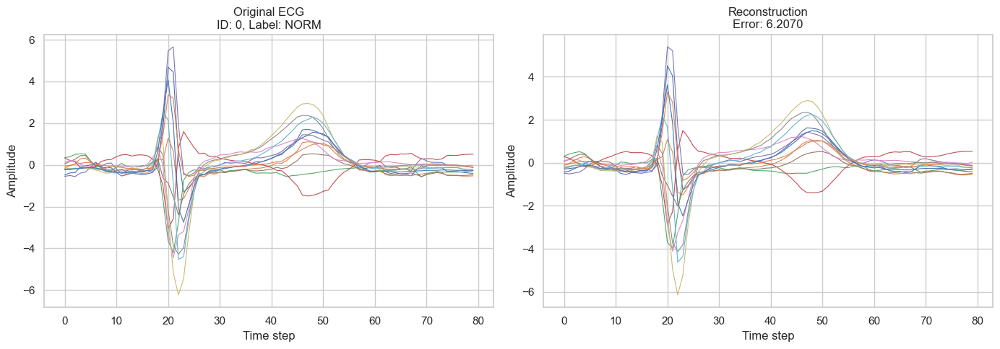

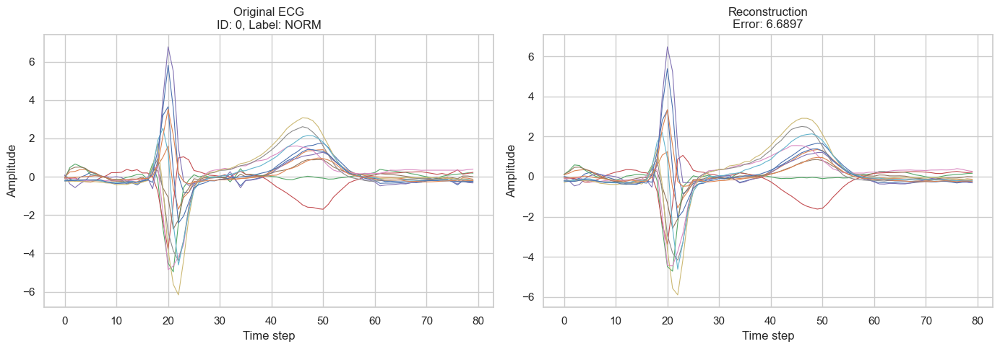

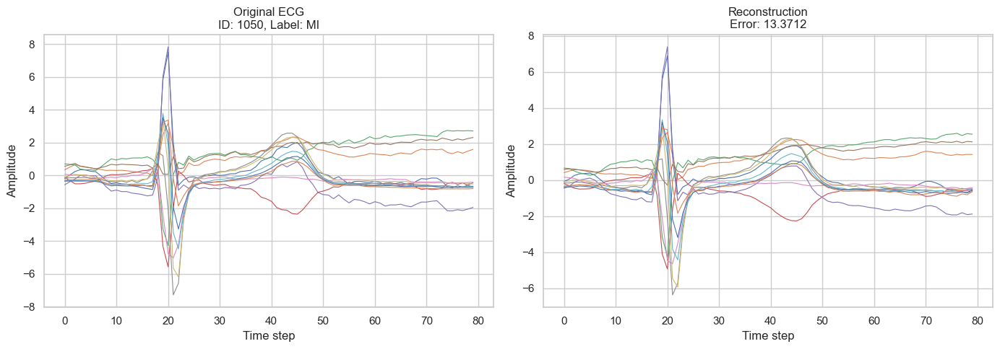

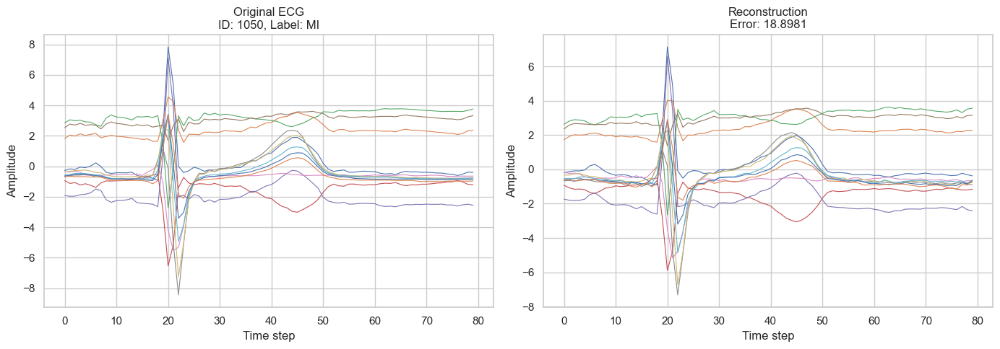

...

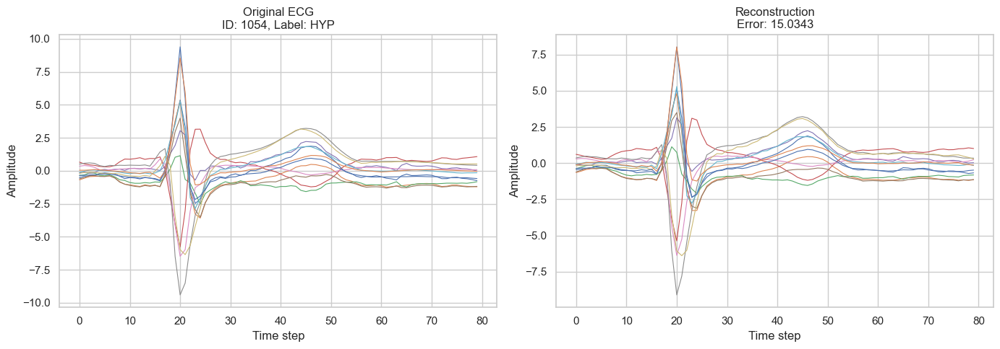

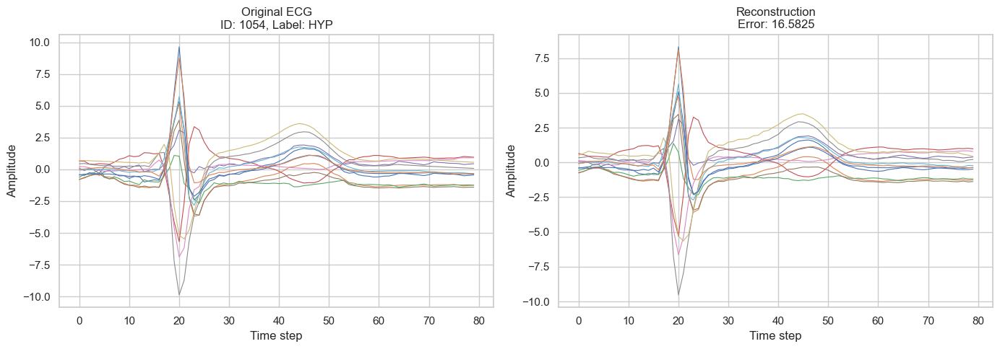

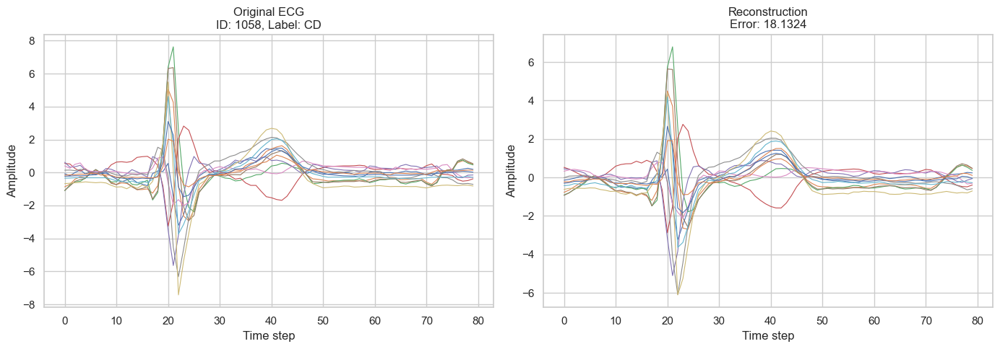

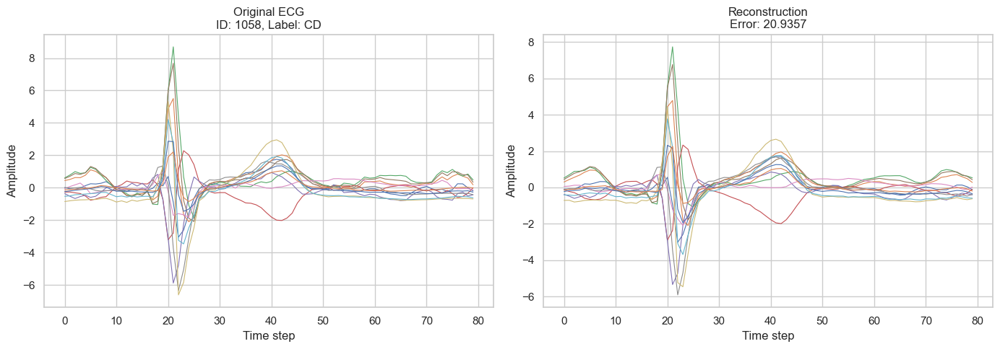

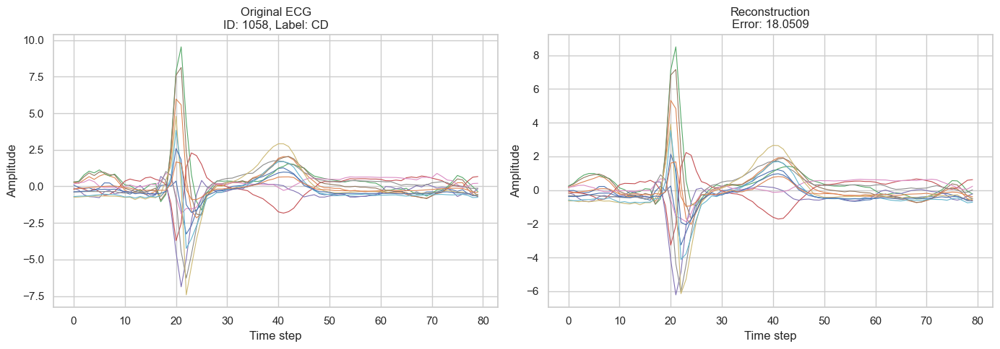

In [ ]:
# plot exmaples of hight error and low error sample per class
import matplotlib.pyplot as plt
import numpy as np
import torch
from collections import defaultdict

device = torch.device("mps") if torch.backends.mps.is_available() else torch.device("cpu")
print(f"Using device: {device}")

# --- How many examples to show per category ---
n_examples_per_label = 3  # Modify as needed

# Containers for all the data
all_clean, all_recon, all_labels, all_seg_ids = [], [], [], []

# --- Gather model outputs over the test set ---
with torch.no_grad():
    for noisy_batch, clean_batch, labels_batch, seg_ids_batch, _ in test_loader:
        # Move input tensor to the same device (mps)
        noisy_batch = noisy_batch.to(device)

        # Ensure that the input tensor is of type float32 (default type for most models)
        noisy_batch = noisy_batch.to(torch.float32)

        # Perform the forward pass
        output_batch = model(noisy_batch)

        # Store the outputs
        all_clean.append(clean_batch.cpu())
        all_recon.append(output_batch.cpu())

        # Extract label (handle case where label might be a list of lists)
        all_labels.extend([lbl[0] if isinstance(lbl, list) else lbl for lbl in labels_batch])
        all_seg_ids.extend(seg_ids_batch)

# Concatenate all data
all_clean = torch.cat(all_clean, dim=0).numpy()
all_recon = torch.cat(all_recon, dim=0).numpy()

# Get high and low error indices based on the mask
high_error_mask = np.array(high_error_mask)  # Make sure it's a numpy array if not already
low_error_mask = ~high_error_mask  # Low error = not high error

# --- Step 1: Separate indices based on categories ---
category_indices = defaultdict(list)
for idx, label in enumerate(all_labels):
    category_indices[label].append(idx)

# --- Step 2: Separate high and low-error indices per category ---
high_error_indices = defaultdict(list)
low_error_indices = defaultdict(list)

for label, indices in category_indices.items():
    # For each category, separate high and low error samples
    high_error_indices[label] = [idx for idx in indices if high_error_mask[idx]]
    low_error_indices[label] = [idx for idx in indices if low_error_mask[idx]]

# --- Step 3: Sample n_examples_per_label for both high-error and low-error cases ---
selected_high_error_indices = []
selected_low_error_indices = []

for label in category_indices.keys():
    # Pick n_examples_per_label from both high and low error indices
    high_samples = high_error_indices[label][:n_examples_per_label]
    low_samples = low_error_indices[label][:n_examples_per_label]

    selected_high_error_indices.extend(high_samples)
    selected_low_error_indices.extend(low_samples)

# --- Step 4: Plot the selected examples ---
def plot_ecg_comparison(idx):
    label = all_labels[idx]
    plt.figure(figsize=(14, 5))

    # Original ECG plot
    plt.subplot(1, 2, 1)
    for lead in range(all_clean.shape[2]):
        plt.plot(all_clean[idx, :, lead], lw=0.8)
    plt.title(f"Original ECG\nID: {all_seg_ids[idx]}, Label: {label}")
    plt.xlabel("Time step")
    plt.ylabel("Amplitude")

    # Reconstruction ECG plot
    plt.subplot(1, 2, 2)
    for lead in range(all_recon.shape[2]):
        plt.plot(all_recon[idx, :, lead], lw=0.8)
    plt.title(f"Reconstruction\nError: {reconstruction_errors[idx]:.4f}")
    plt.xlabel("Time step")
    plt.ylabel("Amplitude")

    plt.tight_layout()
    plt.show()

# --- Show high-error and low-error samples ---
print("=== 🟥 High-error samples (across different categories) ===")
for idx in selected_high_error_indices:
    plot_ecg_comparison(idx)

print("\n=== 🟩 Low-error samples (across different categories) ===")
for idx in selected_low_error_indices:
    plot_ecg_comparison(idx)


# Conclusions

![ECG Example](./ECG_pathologies.png)



- **Reconstruction Error Analysis**
  - Normal ECGs are well reconstructed and mostly ranked in the low-error category. False positives in normals are ~20–30%, depending on the cut-off.
  - Reconstruction error alone does not clearly separate most pathologies.
  - CD and HYP are detected reasonably well (~70% of samples), while MI and SSTC are harder to detect because they are often reconstructed too well.
  - Pathological categories appear to be reconstructed well, which limits the ability of reconstruction errors to distinguish between them.

- **Why CD and HYP Are Detected Better: both pathologies show anomalities in the QRS complex**
  - **Conduction Disturbance (CD):**  
    Abnormal QRS propagation or duration is captured by the autoencoder.
  - **Hypertrophy (HYP):**  
    Hypertrophy leads to increased QRS voltage and slight morphological changes. Since the autoencoder is trained only on normal ECGs, these voltage deviations and waveform alterations stand out, producing higher reconstruction errors compared to normal ECGs.

- **Why MI and SSTC Are Harder to Detect: ST-T segments anomalities**
  - **Myocardial Infarction (MI):**  
    MI presents abrupt, localized changes like Q-wave formation, ST-segment elevation, or T-wave inversion. These patterns vary depending on infarct location and timing. Some subtle MI changes may be reconstructed too well, resulting in low errors and making detection difficult.
  - **SSTC (Supraventricular Tachycardia / subtle ST changes):**  
    SSTC or minor ST-segment abnormalities can be transient or subtle, sometimes only affecting rhythm or small waveform features. The autoencoder focuses on overall waveform structure, so these small, short-lived changes often produce insignificant reconstruction errors.

- **Model Limitations and Recommendations**
 
  - While it identifies 70% of CD and HYP samples as abnormal, further improvements are needed.  
  - This pathologies show abnormalioties in the QRS complex, usually the largest and most distinctive feature in ECGs, so the model focuses on reconstructing it well. Subtle changes in the ST-T segment can get “washed out” in the reconstruction.

  - **Segmentation Improvements:**  
   
    - Segment ECGs based on R-peak intervals (R to R) rather than fixed windows. 
    - Segment ECG into QRS and ST-T → train separate autoencoders.
    - Or Baseline correction:  "normalized" so the ST-T picks are not so different in scale to QRS complex.
    - Weight ST-T in the loss function. 
    - Adjust peak detection to account for heart rate variability. 
  
    - Fine-tuning reconstruction or model architecture to better separate subtle pathologies.
    - Use/ add new features instead of raw ECG
          - feed the network ST-T sensitive features:
          - ST deviation from baseline
          - T-wave amplitude or slope

